In [647]:
import h5py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import roc_auc_score

import torch
import torch.nn as nn
import math

from sklearn.neighbors import NearestNeighbors
import scipy.stats as stats
from scipy.stats import sem
from sklearn.preprocessing import StandardScaler

import numpy.ma as ma
from random import randint
import random
import seaborn as sns

In [388]:
h5_file = "data/bmrb_filtered.h5"

train_f = "data/mmseqs2_train_rd.fasta"
valid_f = "data/mmseqs2_valid.fasta"
test_f = "data/mmseqs2_test.fasta"

hn_file = "./data/bmrb_hn_monomer_pH68.txt"

output = "./"

In [63]:
# Device configuration
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

# https://discuss.pytorch.org/t/reproducibility-with-all-the-bells-and-whistles/81097
def seed_all(seed=42):
    print("[ Using Seed : ", seed, " ]")

    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    return None

cpu


In [96]:
def read_h5(h5_file):
    
    h5 = h5py.File(h5_file, 'r')

    # List all groups
    key_list = list(h5.keys())

    # Get the data
    dct = {}
    for key in key_list:
        #k = key.split("_",2)#[1]
        #print(k)
        emb = h5[key][:]
        if key not in dct:
            dct[key] = emb
        else:
            print("Double key!")
            print(key)
    
    h5.close()
    return dct


In [65]:
def read_fasta(fasta):
    fasta_ids = []
    fasta_dict = {}

    with open(fasta, 'r') as f:
            lines = f.read().split("\n")
            for i,line in enumerate(lines):
                if line.startswith(">"):
                    #fasta_ids.append(line[1:])
                    fasta_dict[line[1:]] = lines[i+1]
    f.close()
    return fasta_dict #fasta_ids

In [610]:
def get_hn_list(df, fasta_dict, embeddings, scaler, scale):
    
    dict_all = {}
    subs = -100.
    
    dict_seq = {}
    
    
    for i, seq in fasta_dict.items():
        
        e = embeddings.get(i)
            
        if e is not None:
            
            
            #fill non-existing entries for the residues with H/N = -100
            e_len = len(seq)+1
            counter = 1
            hn = []
            i = int(i)

            #get df for protein with HN values
            df_sub = df[df['BRMB_ID'] == i]
            

            for index, row in df_sub.iterrows():
                AA_ID = int(row[1])

                #fill up with -100 before first residue with valid HN
                if counter < AA_ID:
                    while counter != AA_ID:
                        hn.append([subs,subs])
                        counter += 1

                #residue with valid HN
                if counter == AA_ID:
                    h = row[3]
                    n = row[4]

                    #filter ppm: H:5-12, N:95-140
                    #replace with -100
                    if h<5. or h>12. or n<95. or n>140.:
                        hn.append([subs,subs])
                        
                    else:
                        
                        if not scale:
                            hn.append([h,n])
                        else:
                            hn_z = scaler.transform([[h,n]])
                            hn.append(hn_z[0].tolist())

                    counter += 1

            #fill up with -100 after last residue with valid HN if seq_length not reached
            if counter < e_len:
                while counter != e_len:
                    hn.append([subs,subs])
                    counter += 1

            
            #check if duplicate sequence
            #if yes save all infos under one key(seq) in dictionary
            if seq not in dict_seq:
                dict_all[i] = (e,hn)
                dict_seq[seq] = [(i,e,hn)]
            else:
                previous = dict_seq.get(seq)
                previous.append((i,e,hn))
                dict_seq[seq] = previous
                
            
            
        else:
            print("Embedding NoneType: "+i)
        
    
    return dict_seq #dict_all

In [97]:
train_dct = read_fasta(train_f)
valid_dct = read_fasta(valid_f)
test_dct = read_fasta(test_f)

embeddings = read_h5(h5_file) #4682 not in embeddings
df_hn = pd.read_csv(hn_file, sep="\t")

In [98]:
# Get all HN values without outliers to normalize it 
ids_all = df_hn["BRMB_ID"].unique().tolist()

hn_list = [list(i) for i in zip(df_hn['H'], df_hn['N']) 
           if i[0]>=5. and i[0]<= 12. and i[1]>=95. and i[1]<=140.]

In [576]:
df_hn2 = df_hn[df_hn['H']>=5.] 
df_hn2 = df_hn2[df_hn2['H']<= 12.] 
df_hn2 = df_hn2[df_hn2['N']>=95.]
df_hn2 = df_hn2[df_hn2['N']<=140.]
aa_means = df_hn2.groupby(['Residue']).mean()
aa_means


,BRMB_ID,Residue_ID,H,N
Residue,,,,
A,20911.657544,81.387812,8.192077,123.321005
C,19948.174244,72.442492,8.336255,119.961989
D,20640.396178,79.925222,8.293817,120.760373
E,20429.670591,79.072426,8.335355,120.805665
F,20260.457258,78.534045,8.340610,120.403315
G,20784.130857,79.250528,8.326352,109.553282
H,20607.663451,82.757397,8.263017,119.905449
I,20229.929822,79.555052,8.272485,121.461403
K,20601.994322,78.948450,8.170879,121.019780


In [611]:
df_mean = df_hn.merge(aa_means, left_on='Residue', right_on='Residue')
df_mean = df_mean.reindex(columns=["BRMB_ID_x","Residue_ID_x", "Residue", "H_y", "N_y"])
df_mean = df_mean.rename(columns={"BRMB_ID_x": "BRMB_ID"})
df_mean

,BRMB_ID,Residue_ID_x,Residue,H_y,N_y
0,30079,2,T,8.228921,115.326482
1,30079,55,T,8.228921,115.326482
2,30079,67,T,8.228921,115.326482
3,30079,85,T,8.228921,115.326482
4,51094,7,T,8.228921,115.326482
...,...,...,...,...,...
746700,51607,155,P,8.385322,122.654411
746701,26689,16,P,8.385322,122.654411
746702,26689,21,P,8.385322,122.654411
746703,50797,57,P,8.385322,122.654411


In [99]:
# Z-Score normalization

scaler = StandardScaler()
scaler.fit(hn_list)

mean = scaler.mean_
print(mean)



#normalized_hn = scaler.transform(sub)

#transcform back
#back_hn = scaler.inverse_transform(normalized_hn)
#print(back_hn)


[  8.26545377 119.53618768]


In [100]:
train = get_hn_list(df_hn, train_dct, embeddings, scaler, scale=True)
valid = get_hn_list(df_hn, valid_dct, embeddings, scaler, scale=True)
test = get_hn_list(df_hn, test_dct, embeddings, scaler, scale=True)

valid_aa_mean = get_hn_list(df_mean, valid_dct, embeddings, scaler, scale=True)

print(len(train))
print(len(valid))
print(len(test))

#6457-17769: 10x the same sequence

# Ausmarkieren von fehlenden Residues:
#Input beibehalten (du hast ja ein Embedding für eine Position, selbst wenn du keine H/N Werte hast), 
#aber das Label auf -100 (oder eine andere Zahl die nicht im eigentlichen Label-space vorkommt) setzt 
#und  dann den Loss an diesen Positionen einfach mit 0 multipliziert
# Liste mit HN Werten: [-100,-100] bei fehlenden eintrag
# Liste für Loss-multiplizierung [0] bei fehlenden eintrag, sonst [1]

Embedding NoneType: 4682
Embedding NoneType: 4345
Embedding NoneType: 30258
Embedding NoneType: 34077
5960
215
230


In [646]:
for i,k in valid.items():
    print(k[0])
#print(valid)

(16441, array([[ 0.2756  , -0.4363  ,  0.1346  , ...,  0.2382  , -0.1912  ,
         0.57    ],
       [-0.1888  , -0.292   ,  0.1002  , ...,  0.1974  , -0.1294  ,
         0.2837  ],
       [-0.239   , -0.4097  ,  0.1974  , ..., -0.004562, -0.206   ,
         0.3318  ],
       ...,
       [-0.1694  , -0.2286  ,  0.0481  , ...,  0.05655 , -0.00461 ,
        -0.02063 ],
       [-0.05682 , -0.4263  ,  0.03177 , ..., -0.245   ,  0.0628  ,
         0.292   ],
       [-0.01109 , -0.3862  ,  0.04425 , ..., -0.2112  , -0.2318  ,
         0.228   ]], dtype=float16), [[-100.0, -100.0], [-100.0, -100.0], [-100.0, -100.0], [-100.0, -100.0], [1.1864045995505812, 0.2724990150626444], [0.944847558571462, -1.4294983157189063], [0.5300686921533729, -3.612237789266702e-05], [-100.0, -100.0], [0.6985229444151259, -0.2000107041580615], [0.5300686921533729, 1.1817193464673768], [1.3485020875760423, 1.4831247315181415], [-1.5072742455783958, -0.8340013416786337], [0.7652689688961976, 0.9971422300793285], [

In [775]:
#get dirstribution of hn
def list_hn(h_list, n_list, dct):
    
    for sublist in dct.values():
        for l in sublist:
            res1, res2 = map(list, zip(*l[2]))
            h_list.extend(res1)
            n_list.extend(res2)
            
    return h_list, n_list


h_scale = []
n_scale = []

h_scale,n_scale = list_hn(h_scale, n_scale, train)
h_scale,n_scale = list_hn(h_scale, n_scale, valid)
h_scale,n_scale = list_hn(h_scale, n_scale, test)

h_scale = [i for i in h_scale if i != -100.]
n_scale = [i for i in n_scale if i != -100.]

plt.figure(figsize=(14, 6))
plt.hist(n_scale, density=True, bins = 100)

plt.ylabel("Probability")
plt.xlabel("N")
plt.title("Distribution of N")
#plt.savefig("./n_distribution_scaled")

In [10]:
def plot_simple(x1, x2, label1, label2, x_label, y_label, title, x_range, out, out_name):
    

    plt.figure(figsize=(14, 6))
    
    l = range(0, len(x1))
    plt.plot(l, x1, label=label1)
    plt.plot(l, x2, label=label2)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)
    x_labels = np.arange(min(l), max(l)+1, x_range)
    plt.xticks(x_labels)
    plt.ylim(ymin=0)
    
    
    plt.legend()
    if out:
        plt.savefig("./"+out_name)
    plt.show()

In [11]:
def plot_double(x1, x2, y1, y2, xlabel1, xlabel2, ylabel1, ylabel2, x_label, y_label, title, 
                x_range, y_range, out, out_name):
    

    plt.figure(figsize=(14, 9))
    
    l = range(0, len(x1))
    m1 = max(y1)
    m2 = max(y2)
    m = [m1,m2]
    
    plt.plot(l, y1, label=ylabel1)
    plt.plot(l, y2, label=ylabel2)
    plt.plot(l, x1, label=xlabel1)
    plt.plot(l, x2, label=xlabel2)
    
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)
    
    x_labels = np.arange(min(l), max(l)+1, x_range)
    y_labels = np.arange(0, max(m)+0.1, y_range)
    
    plt.xticks(x_labels)
    plt.yticks(y_labels)
    plt.ylim(ymin=0)
    
    
    plt.legend()
    if out:
        plt.savefig("./"+out_name)
    plt.show()

In [12]:
def plot_scatter(y, yhat, xlabel1, xlabel2, title, out, out_name):
    

    plt.figure(figsize=(14, 9))

    plt.scatter(y[:,0], y[:,1], label=xlabel1, marker="o")
    plt.scatter(yhat[:,0], yhat[:,1], label=xlabel2, marker="v")
   
    
    plt.xlabel("H")
    plt.ylabel("N")
    plt.title(title)
    
    
    plt.legend()
    if out:
        plt.savefig("./"+out_name)
    plt.show()

In [648]:
from torch.nn.utils.rnn import pad_sequence

class MyCollator(object):
    
    def __call__(self, batch, ignore_idx=-100):
        # batch is a list of the samples returned by your __get_item__ method in your CustomDataset
        ids, X, Y = zip(*batch)
        X = pad_sequence(X, batch_first=True, padding_value=ignore_idx)
        Y = pad_sequence(Y, batch_first=True, padding_value=ignore_idx)
        return (list(ids), X, Y)

    
class CustomDataset(torch.utils.data.Dataset):
    
    def __init__(self, samples, first):
        
        #self.ids = []
        #self.inputs = []
        #self.targets = []
        
        self.item = []
        self.seq = []
        self.first = first
        
        for seq, item in samples.items():
            self.seq.append(seq)
            self.item.append(item)
            
        self.data_len = len(self.item)    
        
        
        #self.ids, self.inputs, self.targets = zip(*[(ids, inputs, targets)  
        #                    for ids, (inputs, targets) in samples.items()])
        #self.data_len = len(self.inputs) # number of samples in the set
        
        
    def __len__(self):
        return self.data_len
    
    def __getitem__(self, index):
        
        curr_item = self.item[index]
        
        if self.first:
            i = 0
        else:
            length = len(curr_item)
            i = randint(0, length-1)
            
        item = curr_item[i]
        ids = item[0]
        x = item[1]
        y = item[2]    
            
        
        #ids = self.ids[index]
        #x = self.inputs[index]#.float()
        #y = self.targets[index]#.long()
        return (ids, torch.tensor(x, dtype=torch.float32), torch.tensor(y, dtype=torch.float32))

    
def get_dataloader(customdata, batch_size, first):
    # Create dataloaders with collate function
    my_collator = MyCollator()
    dataset = CustomDataset(customdata, first)
    return torch.utils.data.DataLoader(dataset=dataset,
                                        batch_size=batch_size, 
                                        shuffle=True,
                                        drop_last=False,
                                        collate_fn=my_collator)
  

class EarlyStopper():
    def __init__(self, log_dir, model_choice):
        self.log_dir      = log_dir
        self.checkpoint_p = log_dir / 'checkpoint.pt'
        self.epsilon      = 1e-3 # the minimal difference in improvement a model needs to reach
        self.min_loss     = np.Inf # counter for lowest/best overall-loss
        self.n_worse      = 0 # counter of consecutive non-improving losses
        self.patience     = 7 # number of max. epochs accepted for non-improving loss
        self.model_choice = model_choice
       
    
    def load_checkpoint(self):
        state = torch.load( self.checkpoint_p)
        model = get_model(model_choice, input_dim = 1024, hidden_dim = 513, output_dim=2)
        model.load_state_dict(state['state_dict'])
        print('Loaded model from epoch: {:.1f}'.format(state['epoch']))
        return model, state['epoch']
    
    def save_checkpoint(self, model, epoch, optimizer):
        state = { 
                    'epoch'      : epoch,
                    'state_dict' : model.state_dict(),
                    'optimizer'  : optimizer.state_dict(),
                }
        torch.save( state, self.checkpoint_p )
        return None
    

         
        
    def check_performance(self, model, test_loader, crit, optimizer, epoch, num_epochs):
        current_loss,_,_,_,_ = testing(model, test_loader, crit, epoch, num_epochs, set_name="VALID")
    
        # if the model improved compared to previously best checkpoint
        if current_loss < (self.min_loss - self.epsilon):
            print('New best model found with loss= {:.3f}'.format(current_loss))  
            self.save_checkpoint( model, epoch, optimizer)
            self.min_loss = current_loss # save new loss as best checkpoint
            self.n_worse  = 0
        else: # if the model did not improve further increase counter
            self.n_worse += 1
            if self.n_worse > self.patience: # if the model did not improve for 'patience' epochs
                print('Stopping due to early stopping after epoch {}!'.format(epoch))
                return True, current_loss
        return False, current_loss

    




#Mask residues with -100, replace with 0     
def mask(Y, Yhat):
       
    true_false = Y!=-100
    masked_y = torch.where(true_false,Y, 0)
    masked_yhat = torch.where(true_false, Yhat, 0)
    
    return masked_y, masked_yhat     


#calcluate Loss for H and N individually
def get_loss(Y, Yhat, crit):
    
    y_masked_h, yhat_masked_h = mask(Y[:,:,0],  Yhat[:,:,0])
    y_masked_n, yhat_masked_n = mask(Y[:,:,1],  Yhat[:,:,1])
    
    
    loss_h = crit(y_masked_h, yhat_masked_h)
    loss_n = crit(y_masked_n, yhat_masked_n)
    
    return loss_h, loss_n   


        
def training(model, trainloader, crit, optimizer, epoch, num_epochs):
    
    model.train() # ensure model is in training mode (dropout, batch norm, ...)
    accuracies = []
    batch = 0
    batch_loss = 0
    batch_loss_h = 0
    batch_loss_n = 0
    
    #start = time.time()
 
    for i, (_, X, Y) in enumerate(trainloader): # iterate over all mini-batches in train
      
        optimizer.zero_grad() # zeroes the gradient buffers of all parameters
        
        X    = X.to(device)
        Y    = Y.to(device)
        
        #train
        Yhat = model(X)
        
        #loss
        #Loss normalisation
        #-loss konstanter Faktor multiplikation
        #-raw input data normalization (zscore)
        #total_loss = (loss_h + loss_n)/2 #mean(loss) oder selber effekt: nur summe(loss) dafür learning rate runter
    
        loss_h, loss_n = get_loss(Y, Yhat, crit)
        total_loss = (loss_h + loss_n)/2
        
        #backpropagation
        total_loss.backward() 
        optimizer.step()
        
        
        
        #sum up loss per batch
        batch += 1
        batch_loss += total_loss.detach().cpu().numpy()
        batch_loss_h += loss_h.detach().cpu().numpy()
        batch_loss_n += loss_n.detach().cpu().numpy()
        
        
    #collect loss for plot: mean over batches per epoch
    epoch_loss = batch_loss/batch
    epoch_loss_h = batch_loss_h/batch
    epoch_loss_n = batch_loss_n/batch
        
    #end = time.time()
    if epoch % 1 == 0 or epoch == num_epochs:
        out = ('Epoch [{}/{}], TRAIN loss: {:.2f}').format( 
                    epoch, num_epochs, 
                    epoch_loss,
                    #end-start,
                    )
        print(out)
        
    return epoch_loss,epoch_loss_h,epoch_loss_n 



def testing( model, testloader, crit, epoch, num_epochs, log_dir=None, set_name=None):
    model.eval() # [ensure model is in training mode (dropout, batch norm, ...)
    accuracies = []
    accuracies_rndm = []
    r2_h = []
    r2_n = []
    
    h_y = []
    h_yhat = []
    n_y = []
    n_yhat = []
    
    auc_list = []
    coverage_all = {}
    precision_all = {}
    

    #start = time.time()
    results = {}
    
    batch = 0
    batch_loss = 0
    batch_loss_h = 0
    batch_loss_n = 0
    
    for i, (pdb_ids, X, Y) in enumerate(testloader):
        
        # IN: [B, L, F] OUT: [B, N, L]
        X    = X.to(device)
        Y    = Y.to(device)


        with torch.no_grad():
            Yhat = model(X)
   
        loss_h, loss_n = get_loss(Y, Yhat, crit)
        total_loss = (loss_h + loss_n)/2
        
        
        # sum up loss per batch
        batch += 1
        batch_loss += total_loss.detach().cpu().numpy()
        batch_loss_h += loss_h.detach().cpu().numpy()
        batch_loss_n += loss_n.detach().cpu().numpy()
        
        
        # IN: [B, N, L] OUT: [B, L]
        # iterate over every sample in batch
        for sample_idx in range(0,Yhat.shape[0]):
            
            yhat = Yhat[sample_idx] # get single sample/protein from mini-batch
            y    = Y[sample_idx]
            
            #Mask vectors
            y_masked_h, yhat_masked_h = mask(y[:,0],  yhat[:,0])
            y_masked_n, yhat_masked_n = mask(y[:,1],  yhat[:,1])
            
            y_masked_h = y_masked_h[y_masked_h.nonzero().squeeze()]
            y_masked_n = y_masked_n[y_masked_n.nonzero().squeeze()]
            yhat_masked_h = yhat_masked_h[yhat_masked_h.nonzero().squeeze()]
            yhat_masked_n = yhat_masked_n[yhat_masked_n.nonzero().squeeze()]
            
            y_masked = torch.stack((y_masked_h, y_masked_n),-1)
            yhat_masked = torch.stack((yhat_masked_h, yhat_masked_n),-1)
            
            
            #Collect all values for pearson per epoch
            h_y.extend(y_masked_h.tolist())
            h_yhat.extend(yhat_masked_h.tolist())
            n_y.extend(y_masked_n.tolist())
            n_yhat.extend(yhat_masked_n.tolist())
            
            #Classification Accuracy
            #nearest neighbor: right/wrong assignment
            nbrs = NearestNeighbors(n_neighbors=1, algorithm='auto').fit(y_masked) 
            distances, indices = nbrs.kneighbors(yhat_masked)
            
            
            #collect true prediction, if kNN matches position
            indices = indices.flatten()
            prot_len = len(indices)
            index_comparison = np.arange(prot_len)
            
        
            
            #acc = correct predictions/number of predictions
            comp = (indices==index_comparison)
            true = (comp == True).sum()
            acc = true/prot_len
            accuracies.append(acc)
            
            #if acc > 0.6:
            #    print(pdb_ids[sample_idx])
            
            #random index list to compare accuracy against
            res = random.sample(range(0, prot_len),prot_len)
            comp_rndm = (res==index_comparison)
            true_rndm = (comp_rndm == True).sum()
            acc_rndm = true_rndm/prot_len
            accuracies_rndm.append(acc_rndm)
            
           
        
            #Precision, Coverage
            #Coverage: wie viele meiner Residues kann ich bei gegebenem Distance-cut-off X noch vorhersagen 
            #y% aller Residues haben Distance<X, zB 30% aller Residues haben eine Distanz<0.4 zum nearest neighbor
            #Precision: bei gegbenem Distance-cut-off X, sind wie viele deiner vorhergesagten Residues korrekt 
            #z% der Residues mit Distance<X sind korrekt., zB 10% der Residues die bei Distanz<0.4 vorhergesagt werden sind korrekt.
            
            distances = distances.flatten()
    
            #iterate over every distance of every residue
            for i in distances:
                d = (distances <= i)

                #Coverage: (#distances that are below cut-off)/protein_length
                cov = 1-(d.sum()/prot_len)

                #Precision: (#distances below cut-off and that are also correct)/protein_length
                d_true = np.where(d == True)[0]
                comp_true = np.where(comp == True)[0]   
                prec = len(np.intersect1d(d_true,comp_true))/prot_len

            
                #take mean over all proteins for every distance and save in dict
                if i not in coverage_all:
                    coverage_all[i] = cov
                    precision_all[i] = prec
                else:
                    #print("here")
                    c = coverage_all[i]
                    coverage_all[i] = (c+cov)/2
                    p = precision_all[i] 
                    precision_all[i] = (p+prec)/2
            
        
            
            
            if epoch==num_epochs: # store predictions of final checkpoint for writing to log
                pdb_id = pdb_ids[sample_idx]
                results[pdb_id] = (','.join([str(i.detach().cpu().numpy()) for i in y]),
                                   ','.join([str(j.detach().cpu().numpy()) for j in yhat])
                                   ,accuracies[-1])
    
    
    
    #Accuracy Mean
    acc_mean = sum(accuracies)/len(accuracies)
    acc_mean_rndm = sum(accuracies_rndm)/len(accuracies_rndm)

    
    #collect loss for plot: mean over batches per epoch
    epoch_loss = batch_loss/batch
    epoch_loss_h = batch_loss_h/batch
    epoch_loss_n = batch_loss_n/batch
    
    #R2 mean
    r2 = r2_h +r2_n
            
    #end = time.time()
    if epoch % 1 == 0 or epoch == num_epochs:
        out = ('Epoch [{}/{}], {} loss: {:.2f}, Accuracy Mean: {:.2f}, Accuracy RNDM: {:.2f}').format( 
                    epoch,num_epochs, set_name,
                    epoch_loss,
                    acc_mean, acc_mean_rndm
                    #end-start,
                    )
        print(out)
        
    if epoch==num_epochs:
        write_predictions(results, log_dir, set_name)
    
    

  
    return epoch_loss,epoch_loss_h,epoch_loss_n, accuracies, accuracies_rndm, coverage_all, precision_all, (h_y,h_yhat,n_y,n_yhat) 





def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def write_predictions(results, log_dir, set_name):
    out_p = log_dir / (set_name + '_log.txt')
    with open(out_p, 'w+') as out_f:
        out_f.write('\n'.join( 
            ">{},y,yhat,acc={:.3f}\n{}\n{}".format(pdb_id, acc, y, yhat) 
                              for pdb_id, (y,yhat,acc) in results.items() ) )
    return None




def get_model(model_choice,input_dim, hidden_dim, output_dim):
     if model_choice == "CNN":
        return CNN(input_dim, output_dim).to(device)
     elif model_choice == "FNN":
        return TwoLayerFNN(input_dim, hidden_dim, output_dim).to(device)
     elif model_choice == "LinReg":
        return LinearRegression().to(device)
     else:
        raise NotImplementedError

        
        
#Get Loss of Epoch 0        
def get_initialized_loss(model, dataloader, crit):
    batch = 0
    batch_loss = 0
    batch_loss_h = 0
    batch_loss_n = 0
    
    for i, (pdb_ids, X, Y) in enumerate(dataloader):
        
        X    = X.to(device)
        Y    = Y.to(device)
        
        with torch.no_grad():
            Yhat = model(X)

        loss_h, loss_n = get_loss(Y, Yhat, crit)
        total_loss = (loss_h + loss_n)/2
        
        batch += 1
        batch_loss += total_loss.detach().cpu().numpy()
        batch_loss_h += loss_h.detach().cpu().numpy()
        batch_loss_n += loss_n.detach().cpu().numpy()


    epoch_loss = batch_loss/batch
    epoch_loss_h = batch_loss_h/batch
    epoch_loss_n = batch_loss_n/batch
    
    return epoch_loss,epoch_loss_h,epoch_loss_n


def combine_dictionaries(dict1, dict2):
    common_keys = set(dict1.keys()) & set(dict2.keys())
    
    combined_dict = {key: (dict1[key] + dict2[key])/2 for key in common_keys}
    combined_dict.update({key: value for key, value in dict1.items() if key not in common_keys})
    combined_dict.update({key: value for key, value in dict2.items() if key not in common_keys})
    
    return dict(sorted(combined_dict.items(), key=lambda x: x[0])) 

Number of free parameters: 526853
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.9448,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.4284,   -0.5760,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.1757,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.6131e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02,  5.9180e-01, -1.3591e+00,  ..., -1.0000e+02,
         -1.0000e

tensor([[-100.0000, -100.0000,    0.3886,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    1.0799,    0.5301,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.4792,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [  -0.1644,   -0.2025,    0.1836,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    1.5170,    1.0005,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.4045,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-1.0000e+02, -1.0000e+02,  5.3195e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  8.4221e-01,  1.7562e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  8.2918e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-2.1203e+00,  1.5856e-01, -1.6122e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.000

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  5.3007e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -2.6294e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -3.2651e-01,  1.4597e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -3.1856e-01, -9.9251e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.8652e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  1.0131e+00

tensor([[-1.0000e+02, -1.0000e+02, -2.1367e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  9.4008e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  3.8386e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  7.2248e-03,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,    0.3764,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    1.7472,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  7.5560e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  4.3631e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-2.1381e-02, -1.0000e+02,  2.2971e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -9.1451e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  8.8628e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -2.6212e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02

tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -1.0416,   -1.2641,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -0.1835,   -0.4536,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,   -0.1517,   -0.2232,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.3568,    0.4204,  ..., -100.0000, -100.0000,
         -100.0000],
        [   0.1455,    0.1375,    0.9115,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    1.8407,   -0.7383,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -1.2195,   -1.5275,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.3843,    0.5477,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.8130,    0.1316,  ..., -100.0000, -100

tensor([[-1.0000e+02,  1.4072e-01,  6.5403e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.8666e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  8.1917e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.4103e+00, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -5.0132e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000,    0.4203,    0.8973,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.1039,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000,    0.5516,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02,  2.1700e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.2482e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  7.9229e-01,  4.5856e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  1.8204e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  9.6220e-02,  2.3130e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  2.8994e-01, -1.6520e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,    0.8053,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.2690,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.5651,    0.5221,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000,    0.2702,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  4.2518e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -4.3629e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  9.9888e-01,  1.1387e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -3.4716e-01, -3.1379e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  8.2257e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  5.8584e-01

tensor([[-1.0000e+02,  4.8544e-02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  2.4401e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-2.5499e-01,  2.3289e-01,  8.1917e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  3.7274e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  9.6220e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02,  9.3921e-01, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.3648e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 9.7353e-02,  1.6144e-01, -9.2735e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  4.0107e-01

tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.4204, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -0.2899, -100.0000,  ..., -100.0000, -100

tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.1199,  ..., -100.0000, -100.0000,
         -100.0000],
        [   0.2138,    0.1820,    0.8813,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.5049,  ..., -100.0000, -100

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  7.3825e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -8.6671e-03, -1.0402e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  4.2187e-02,  1.1847e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  5.1577e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 3.2506e-01,  3.2506e-01, -7.2235e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -1.5675,   -1.5223,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000,    0.5319,  ..., -100.0000, -100.0000,
         -10

tensor([-1.0000e+02, -1.0000e+02,  4.3948e-01,  2.2335e-01, -7.8591e-02,
         3.0917e-01,  4.5220e-01,  4.3776e-02,  3.9009e-02, -1.1514e-01,
        -3.7273e-02, -4.3139e-01, -2.8836e-01,  7.4620e-01, -5.2674e-01,
        -7.7307e-01, -2.5022e-01,  6.4449e-01,  1.3582e-02, -1.3309e+00,
        -9.7013e-01, -5.9190e-01, -6.2527e-01,  1.5472e+00,  7.2382e-02,
         6.2847e-02, -9.7807e-01,  5.2053e-01, -1.6613e-02, -9.6536e-01,
         4.6332e-01,  8.8446e-01, -1.2006e+00, -5.5694e-01, -9.5900e-01,
        -7.6989e-01,  1.3310e+00, -1.6153e+00,  4.8080e-01, -4.3298e-01,
        -1.1290e+00, -1.2896e+00,  2.0746e-01, -7.9214e-01, -1.4930e+00,
         1.5343e-01, -1.0402e-01, -9.8920e-01, -4.7589e-01, -5.3310e-01,
        -2.4069e-01, -5.0449e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02,  5.7774e-01,  1.1370e-01, -1.0256e-02,
        -1.2627e-01, -4.0451e-02, -1.0000e+02,  7.5732e-01, -3.2333e-01,
         1.7919e+00,  3.1235e-01, -1.3484e+00,  5.2053e-01, -1.0000e+02,
         1.4868e+00,  1.1737e+00, -5.3310e-01, -7.8260e-01, -1.4961e+00,
         1.1054e+00, -5.0132e-01,  1.7250e-01, -1.2085e+00, -1.5024e-02,
         9.0035e-01, -8.9716e-02,  5.2848e-01, -1.3515e+00, -4.5046e-01,
        -8.4458e-01,  1.8284e+00,  1.6918e+00, -1.0000e+02, -2.0285e+00,
        -2.1208e-01, -3.4716e-01, -1.7472e+00, -1.0000e+02, -1.1038e-01,
         3.6956e-01, -9.7648e-01, -1.5011e-01,  2.0128e+00,  2.4276e+00,
         1.2214e+00,  3.6956e-01, -1.2212e+00, -1.0000e+02,  5.5232e-01,
        -1.5646e-01,  1.2706e+00, -8.1280e-01,  1.5138e+00,  3.7592e-01,
         3.9976e-01, -1.0000e+02, -1.2514e+00,  5.0133e-02, -1.0893e+00,
         2.4243e-01,  2.2494e-01,  1.1054e+00,  1.4168e+00, -7.2539e-01,
         7.8275e-01,  2.4530e+00, -9.8443e-01,  1.2

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  7.9370e-01,  1.1286e+00,
         8.3374e-01,  1.4077e+00,  1.3611e+00,  1.0997e+00,  4.7421e-01,
         7.9370e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0655e+00,  3.0195e-01, -1.7056e-01,
         2.1399e-01, -1.8019e-01, -2.7094e+00,  1.2006e-01,  6.9747e-01,
        -3.7458e-01, -9.4044e-01,  3.5872e-01, -2.5676e+00,  9.3632e-01,
        -1.3252e+00, -1.0936e-01, -1.5702e+00,  1.5278e+00,  7.7715e-01,
         7.8216e-01, -3.8035e-01, -6.0400e-01, -2.8617e+00,  3.2985e-01,
        -6.8060e-01, -1.2927e+00, -8.5383e-01,  8.5741e-01,  9.3805e-01,
         2.5688e+00, -1.0000e+02,  4.1088e-01,  1.0516e+00, -2.9220e-01,
         8.8667e-01, -4.7909e-01,  9.5873e-03,  1.1203e+00, -3.3994e-01,
        -2.1258e+00, -1.9794e+00,  4.7286e-01,  1.5867e+00,  2.0860e-01,
        -2.5057e-02, -1.5556e+00,  4.1647e-01, -1.8545e+00,  2.6584e-03,
         1.8140e+00, -1.0000e+02,  8.9167e-01,  1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         2.4719e-01,  2.9805e-01, -1.0000e+02,  2.6467e-01, -1.0000e+02,
         2.5514e-01,  3.1394e-01,  2.5991e-01, -6.5878e-02,  1.1499e+00,
        -3.5352e-01, -2.5990e+00,  1.4866e-01,  8.4155e-01,  5.9046e-01,
        -1.0084e-01,  6.3019e-01,  6.7310e-01,  6.4767e-01,  5.8887e-01,
         7.6050e-01, -2.6929e-01,  2.0207e+00,  3.9340e-01, -1.0000e+02,
        -1.0000e+02,  2.0748e+00,  3.5049e-01,  7.5891e-01, -2.5022e-01,
        -1.0000e+02,  3.9022e-01,  6.1271e-01,  8.5903e-01,  1.1944e+00,
         1.4597e+00,  4.8398e-01, -1.9936e+00, -1.4850e+00, -4.3139e-01,
        -1.0242e+00,  4.3313e-01, -1.1863e+00, -1.0000e+02, -1.0000e+02,
         1.0099e-01, -1.6123e-01, -8.9716e-02,  2.7422e+00, -1.2339e+00,
         1.7744e+00, -1.0000e+02,  2.9646e-01, -2.2272e+00, -1.2435e+00,
        -1.0000e+02,  5.3960e-01,  1.4391e+00, -1.2387e+00, -1.1196e-01,
         1.2738e+00,  3.8863e-01, -7.3969e-01,  1.2

tensor([-1.0000e+02, -1.0000e+02,  6.4800e-01, -1.7022e+00, -6.6790e-01,
         6.9516e-01, -1.0000e+02, -1.0513e+00, -5.8572e-01,  1.6683e-01,
         4.0857e-01,  2.0937e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  1.6683e-01, -3.6842e-01, -6.7560e-01, -4.7986e-01,
        -2.8065e-01, -4.3232e-01,  2.3689e-01, -5.6878e-01, -1.0000e+02,
        -1.0000e+02, -2.7989e-01,  8.2238e-01, -1.0000e+02, -2.0598e-01,
        -1.0000e+02, -3.2704e-01, -2.8200e-01, -3.9652e-01,  9.2612e-01,
         4.0684e-01, -4.0780e-03, -1.0000e+02,  1.6920e+00,  4.8787e-01,
         5.3945e-01,  1.7145e-01, -1.6503e+00, -1.0000e+02, -1.0000e+02,
         2.7462e-01, -1.0000e+02, -9.2754e-01,  1.0717e-01,  1.2885e+00,
        -4.3040e-01, -1.0000e+02, -1.0000e+02,  3.0888e-01, -1.2093e+00,
        -6.2011e-02,  8.5568e-01, -1.0000e+02,  7.5887e-01,  1.0739e+00,
        -8.7808e-01, -2.0044e+00,  7.0113e-01,  7.0478e-01,  1.6084e+00,
         1.0485e+00,  1.0456e+00, -3.8132e-01,  2.3

tensor([-1.0000e+02, -1.0000e+02,  1.0879e+00,  5.6344e-01,  1.1356e+00,
         2.5023e+00, -2.6785e+00, -5.0132e-01, -1.8203e+00,  2.1382e-01,
         8.9717e-01,  1.9793e-01,  5.3166e-01,  8.6539e-01,  6.9058e-01,
        -1.4866e+00, -1.0000e+02,  1.5011e+00, -1.0000e+02,  5.6344e-01,
         9.1306e-01, -2.4559e-02,  6.7469e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  3.9009e-02, -2.0905e+00,  6.4290e-01, -2.6294e-01,
        -8.5094e-01,  1.3263e+00, -4.6953e-01,  5.3166e-01, -7.2235e-02,
        -9.7807e-01,  6.9058e-01, -1.0000e+02, -1.0000e+02,  7.5414e-01,
         4.5220e-01, -4.8542e-01, -3.0122e+00, -1.0000e+02, -8.6671e-03,
        -2.5514e+00, -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.9793e-01,
        -8.6683e-01,  4.5220e-01, -1.1991e-01, -4.6953e-01,  2.1382e-01,
        -1.3580e-01, -4.6953e-01,  6.9058e-01,  1.5964e+00, -3.5829e-01,
         7.0792e-02, -1.1991e-01,  1.8204e-01, -8.3505e-01, -3.1061e-01,
         3.2492e+00,  8.9717e-01,  7.8593e-01,  2.4

tensor([-1.0000e+02,  1.4707e-01,  2.4706e-02,  8.5095e-02,  1.1211e-01,
         8.8140e-03,  4.5061e-01, -1.0000e+02, -1.0000e+02,  7.7480e-01,
        -1.3722e+00,  2.3386e+00,  9.9093e-01,  8.2089e-01, -1.4375e-01,
         1.1546e+00, -1.0000e+02,  4.4743e-01, -1.0000e+02, -2.8995e-01,
        -1.0146e+00,  3.3937e-01,  6.8263e-01,  1.1260e+00,  1.7553e+00,
        -2.5022e-01, -2.7883e-01,  1.1370e-01, -1.4358e+00, -5.2674e-01,
        -1.8013e+00, -8.6671e-03,  1.6902e+00,  2.2018e-01, -3.7100e-01,
         3.1394e-01, -1.0000e+02, -3.0108e-01,  3.6003e-01,  2.2971e-01,
         2.3130e-01,  1.4548e-01,  2.8851e-01,  2.1223e-01, -2.7737e-02,
        -1.8030e-01, -2.8519e-01,  4.3776e-02,  2.5196e-01,  2.4084e-01,
        -2.9327e-02, -1.0000e+02,  5.1577e-01, -8.9702e-01, -6.8248e-01,
        -1.2627e-01, -1.6598e+00,  1.7394e+00,  2.4339e+00,  1.0656e+00,
        -2.4863e-01,  1.9778e+00,  1.3612e+00,  1.4390e-01,  1.9444e+00,
         1.4486e+00, -6.6659e-01,  8.6684e-02,  1.7

tensor([-1.0000e+02, -1.0000e+02,  1.6297e-01,  1.8349e-02, -3.3445e-01,
         1.2959e-01,  1.8204e-01,  2.2177e-01, -1.6759e-01, -2.3592e-01,
        -1.0000e+02,  2.5673e-01, -9.2894e-02,  1.5184e-01, -4.6808e-02,
         2.9169e-01, -1.0000e+02, -1.0000e+02,  2.9474e-02, -1.7553e-01,
        -1.9791e-02, -2.4228e-01, -1.0000e+02, -5.3628e-01, -1.7712e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -8.5132e-01,  6.8246e-01,
         3.8375e-01,  3.4275e-01,  1.1083e-01,  6.0104e-01,  3.7297e-01,
         1.5840e+00, -2.1667e+00,  1.2372e-01, -4.2674e-01,  1.3463e+00,
        -2.1126e+00, -6.3172e-01, -1.5496e+00, -6.2594e-01,  1.2633e+00,
         2.0558e-02,  1.0287e+00, -1.0000e+02,  4.0068e-01,  3.1831e-01,
         3.3563e-01,  1.0717e-01,  6.1759e-01,  1.1968e-01,  3.2716e-01,
         5.4272e-01, -2.1983e-01, -3.6207e-01,  4.3360e-01,  3.5141e-01,
         2.3478e-01,  5.0423e-01,  1.0544e-01,  3.1985e-01,  2.6865e-01,
        -1.0000e+02, -9.3139e-01,  4.5361e-01,  5.8199e-01,  1.9609e-01,
         7.8298e-02, -3.1626e-01, -1.0000e+02,  3.4487e-01, -1.0220e+00,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -3.9017e-01, -1.3760e+00,
        -1.6286e-01,  8.7319e-01, -1.0000e+02, -2.1156e-01,  1.0255e-01,
        -1.0000e+02,  6.2241e-01, -4.5445e-01,  3.0714e-01, -3.8401e-01,
        -9.8580e-02, -2.2792e-01,  4.1922e-02, -7.9

tensor([-1.0000e+02, -1.0000e+02,  4.1916e-01,  1.3816e-01,  1.9880e+00,
         1.9077e+00,  1.3292e+00,  1.3788e+00, -2.1445e-01, -1.0161e+00,
         2.7462e-01, -1.0000e+02,  3.3178e-01,  1.5894e-01, -1.3842e-01,
        -1.0621e+00, -6.1574e-01,  4.4822e-01,  1.4181e-01, -1.7307e-01,
        -1.9963e-01,  4.8729e-01, -5.9111e-01, -6.0304e-01, -7.7049e-01,
        -2.7430e-01, -1.0000e+02, -1.9469e+00, -1.0000e+02,  5.5889e-01,
         8.6703e-01,  1.1196e+00, -7.6221e-01,  1.4075e+00, -6.0304e-01,
        -1.1545e+00, -1.0000e+02,  3.6527e-01, -1.4516e-01, -2.9778e-01,
        -1.0147e-01,  1.6125e-01,  6.0393e-01,  2.0417e-01, -1.5940e-01,
        -1.1029e+00,  1.1737e-01,  1.0544e-01, -2.2137e-01, -7.5182e-01,
        -1.0000e+02,  5.2078e-01, -1.0000e+02,  3.4352e-01,  7.6233e-01,
         1.2585e+00,  1.1498e+00,  7.4039e-01,  1.1349e+00, -1.5754e+00,
         3.8913e-01, -4.1635e-01, -1.0000e+02, -1.0000e+02,  3.3967e-01,
         7.3872e-02, -4.5266e-02,  3.0503e-01, -5.7

tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [   1.2357,    1.2198,   -0.5077,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.3298, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.5062,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [ 1.8207e+00, -2.8521e-02, -3.9306e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.000

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.1864e+00,
         9.4485e-01,  5.3007e-01, -1.0000e+02,  6.9852e-01,  5.3007e-01,
         1.3485e+00, -1.5073e+00,  7.6527e-01,  1.6663e+00,  1.0672e+00,
        -1.1991e-01, -1.5422e+00,  6.4767e-01,  2.9010e-01,  3.9658e-01,
        -2.6612e-01, -9.7172e-01, -9.4470e-01,  1.3278e+00, -1.0000e+02,
        -1.0000e+02,  1.1370e-01, -6.6500e-01, -2.5658e-01,  1.9634e-01,
         1.2690e+00,  9.6074e-01, -1.2927e+00,  1.3118e-01, -7.7148e-01,
        -9.0974e-01, -1.3976e+00, -9.7966e-01,  1.1530e+00,  3.0123e-01,
        -1.0000e+02,  4.6461e+00, -1.2625e+00,  5.5708e-01, -1.0114e+00,
        -2.3103e-03,  4.9193e-01, -5.5694e-01, -1.0130e+00,  1.9793e-01,
         4.0465e-03, -9.4788e-01, -1.3739e-01, -6.6977e-01, -9.5741e-01,
        -5.9190e-01,  2.3130e-01, -5.3946e-01,  5.6662e-01, -8.5888e-01,
         6.4436e-02,  1.1959e+00,  1.8157e+00,  9.2419e-01,  1.3913e-01,
         7.3666e-01, -1.9791e-02,  3.4413e-01, -1.0

tensor([-1.0000e+02, -1.0000e+02,  3.7592e-01,  3.1394e-01, -4.7748e-01,
        -2.1049e-01, -1.7553e-01, -1.6249e+00,  1.4025e+00,  2.1622e+00,
         1.1324e+00, -9.6377e-01,  1.0338e+00,  8.4791e-01, -8.2074e-01,
         8.6539e-01,  5.9046e-01, -2.7103e+00, -1.3197e+00, -9.7662e-02,
        -1.3245e+00, -9.7966e-01, -4.0914e-01, -1.1735e+00, -9.8602e-01,
         5.5867e-01, -4.2040e-02, -1.0257e+00, -9.5106e-01, -9.1451e-01,
         8.3837e-01,  1.1705e+00,  1.4343e+00, -2.5800e+00, -1.3356e+00,
        -5.7932e-02, -1.1084e+00, -7.9373e-01, -8.1770e-02, -6.6341e-01,
         1.3676e+00, -1.2546e+00, -8.0181e-02,  1.8839e-01, -1.7298e+00,
         7.3190e-01, -9.4947e-01, -1.4040e+00, -3.8848e-01,  3.9181e-01,
        -1.7790e+00,  5.4278e-01, -2.2956e-01, -1.2468e-01,  1.3151e+00,
        -5.0291e-01,  6.9534e-01,  3.5432e+00, -9.2881e-01,  1.0164e+00,
        -3.2333e-01,  7.4779e-01, -1.0000e+02, -2.2176e+00,  2.5991e-01,
         1.0481e+00, -2.3209e+00,  9.0671e-01, -2.8

tensor([-1.6889e+00,  1.7203e-01,  2.8578e-01, -1.6678e+00, -2.2442e+00,
        -7.5484e-02, -1.0000e+02, -2.0423e+00, -2.1693e+00,  6.5596e-02,
        -1.7348e+00, -1.6768e-01,  2.1649e-01, -1.9168e+00, -2.1790e+00,
         5.0006e-02, -1.7476e+00, -1.6806e-01, -6.2460e-01,  5.9739e-01,
        -1.9059e+00, -2.0791e+00, -2.0781e+00,  7.9928e-01, -2.1965e+00,
         3.5064e-01, -1.9623e+00, -1.9578e-01, -6.5475e-02,  1.8531e-01,
        -1.8681e+00, -7.4662e-01,  2.0360e-01, -1.0000e+02, -1.9116e+00,
        -2.0845e+00, -2.0539e+00, -1.0000e+02,  2.2290e-02,  3.0618e-01,
        -1.7792e+00,  7.8446e-01, -1.6325e-01, -4.5003e-01,  4.7748e-01,
         9.6173e-01, -1.0000e+02,  5.6274e-01, -1.0000e+02, -1.0000e+02,
         1.0441e+00,  6.7206e-01,  6.4473e-01, -9.9927e-02,  9.3093e-01,
         4.8344e-01,  1.9821e-01,  9.9662e-02, -6.1497e-01, -4.3040e-01,
         6.0855e-01, -1.8957e+00, -1.0000e+02, -1.0000e+02, -1.8793e+00,
        -1.0000e+02,  7.7292e-01,  1.0368e+00, -9.8

tensor([-1.0000e+02, -1.0000e+02,  9.1452e-02, -9.4483e-02, -5.5217e-01,
        -1.0000e+02,  4.3776e-02, -6.3004e-01, -6.3640e-01, -7.1427e-01,
        -8.9385e-01, -7.4923e-01, -5.5694e-01, -5.5058e-01, -1.2627e-01,
        -1.0000e+02, -1.2117e+00,  3.4113e+00, -3.4716e-01,  4.1724e-01,
        -5.9521e-02,  2.3448e-01,  2.3766e-01, -1.2308e+00,  1.3118e-01,
         1.3628e+00, -4.7589e-01,  1.4963e+00,  1.4137e+00,  1.4073e+00,
        -1.0243e-01, -5.9826e-01,  4.9670e-01,  1.2482e-01,  1.3723e+00,
         7.0965e-01,  3.3142e-01,  6.4608e-01, -1.1038e-01, -1.0000e+02,
         4.3537e+00,  1.7092e+00, -9.0497e-01, -1.2006e+00, -9.3040e-01,
         8.3506e-02, -9.2245e-01, -1.1275e+00, -3.3286e-01, -1.8202e-02,
         1.0720e+00,  8.4791e-01, -4.6635e-01,  1.7649e+00, -2.0891e-01,
        -1.0000e+02, -6.5229e-01, -9.8284e-01, -5.9521e-02, -3.1697e-01,
        -2.4814e+00,  3.2665e-01, -1.3468e+00,  1.5343e-01, -2.6135e-01,
        -1.0798e+00, -1.0210e+00, -1.0909e+00, -8.3

tensor([-1.0000e+02, -1.0000e+02,  2.7884e-02,  4.1883e-01, -3.3763e-01,
        -7.4287e-01, -1.0194e+00, -6.7613e-01, -6.3163e-01, -1.8823e+00,
        -2.2415e+00,  1.1403e+00, -4.7589e-01, -2.0047e+00,  9.0989e-01,
         8.4791e-01, -4.3629e-02, -1.6598e+00,  9.3054e-01, -8.2392e-01,
        -2.0714e+00, -2.4528e+00, -3.1538e-01, -1.0000e+02, -1.3103e-01,
        -1.3134e+00, -1.0000e+02, -3.2968e-01,  7.8752e-01,  4.4107e-01,
         1.1371e+00,  6.9058e-01, -8.8590e-01,  5.8569e-01,  1.6297e-01,
        -6.3799e-01, -1.0000e+02, -1.0000e+02,  1.8839e-01, -4.8066e-01,
        -3.4399e-01, -5.8237e-01,  2.3289e-01,  3.0123e-01,  5.0782e-01,
        -8.9067e-01,  8.4632e-01,  1.0402e+00,  1.3008e+00, -1.0000e+02,
         3.9817e-01,  1.5661e-01, -1.6600e-01, -1.3262e-01,  2.6295e-02,
         2.9328e-01, -5.7932e-02, -3.2333e-01, -1.9142e-01, -2.3115e-01,
        -2.3910e-01,  2.1859e-01,  4.0465e-03, -2.6771e-01,  6.4290e-01,
        -1.3580e-01, -1.6249e+00, -3.7736e-01,  9.8

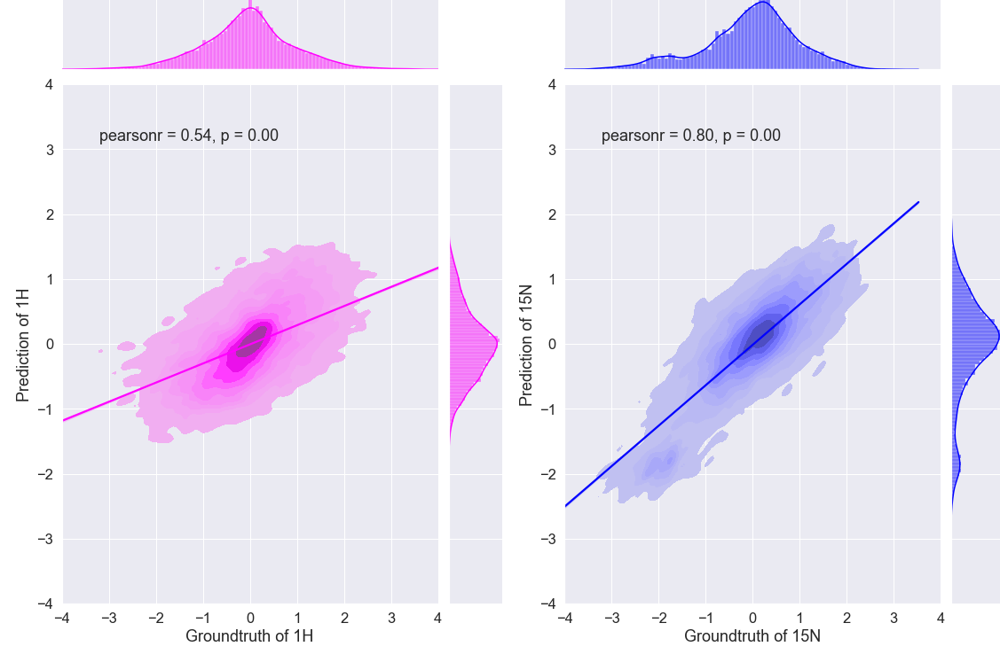

tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -5.8058e-02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
          -0.8102, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -5.8058e-02, -5.8058e-02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000,   -0.8102, -100.0000,   -0.8102, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([[ 2.4560e-01, -3.9007e-01, -1.5169e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  6.1257e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  7.5414e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -6.5878e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.6282e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  3.7433e-01,  1.0466e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[   0.3376,    0.2644,    1.3037,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.4575,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -1.6520,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000,   -0.8608,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02,  1.9157e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  3.2983e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  5.0146e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  9.4630e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  3.8227e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  7.0170e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -1.0000e+02, -2.6603e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.1094e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  5.5697e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  5.9565e-01

tensor([[-100.0000, -100.0000,   -1.8998,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.5952,   -0.3265,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.4013,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-1.0000e+02, -1.0000e+02, -4.5459e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -2.1868e-01, -2.6212e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.000

tensor([[ 4.2518e-01, -2.6294e-01, -4.0451e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  7.8752e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -4.2345e-01,  6.8422e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  3.3460e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[ 8.5227e-02, -1.1743e+00,  7.4366e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  2.2958e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  2.6403e-01,  1.8358e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02

tensor([[-1.0000e+02, -1.0000e+02, -8.1915e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  8.7969e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  6.7614e-02,  5.8251e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,   -0.5626,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.1543,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  2.2335e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 1.9634e-01,  7.2248e-03, -5.3787e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02,  1.8045e-01, -6.5070e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-2.7883e-01,  4.8398e-01,  1.1847e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -2.1509e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.7781e+00, -2.0471e+00, -1.1777e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.7338e+00,  2.5364e-01

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02,  1.3595e-01, -5.4422e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  4.5365e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    1.1076,   -0.9963,  ..., -100.0000, -100.0000,
         -10

tensor([-1.0000e+02, -1.0000e+02,  8.6539e-01,  7.3825e-01,  1.0258e-01,
         4.2041e-01,  3.8863e-01,  2.7739e-01,  2.4560e-01,  2.2971e-01,
         3.0917e-01,  1.5025e-01, -4.0451e-02, -1.8348e-01, -4.0451e-02,
        -1.6759e-01, -5.6343e-02,  1.3436e-01,  1.8204e-01,  2.3117e-02,
        -2.4705e-01,  1.0258e-01,  4.5220e-01, -1.0402e-01,  1.9793e-01,
         4.3631e-01, -1.3580e-01, -1.0000e+02,  6.1112e-01,  5.3166e-01,
         4.0452e-01,  2.4560e-01, -1.0000e+02,  5.1577e-01, -1.0000e+02,
         8.6684e-02,  5.4901e-02,  2.4560e-01, -1.0000e+02, -1.0000e+02,
         5.6344e-01, -2.1526e-01, -1.0000e+02,  2.2971e-01,  3.8863e-01,
         6.1112e-01, -1.0000e+02,  5.6344e-01,  7.0792e-02, -1.0000e+02,
         6.4290e-01,  1.8204e-01, -1.0000e+02,  5.9523e-01, -1.0000e+02,
        -1.0000e+02,  4.0452e-01,  3.7274e-01, -1.0000e+02,  5.9523e-01,
        -1.0000e+02,  5.4755e-01, -1.0000e+02,  7.0792e-02,  2.9328e-01,
         4.2041e-01,  3.4095e-01, -1.0000e+02,  1.9

tensor([-1.0000e+02,  7.8593e-01, -4.3775e-01,  1.5487e+00, -1.0000e+02,
        -4.3775e-01,  1.2150e+00, -8.3505e-01, -1.0000e+02, -5.8078e-01,
         3.9009e-02,  3.9009e-02,  2.2971e-01, -1.5025e+00, -1.8348e-01,
        -1.0000e+02,  7.3825e-01,  2.1526e+00,  9.9252e-01,  4.5220e-01,
        -1.2482e+00,  3.8863e-01,  2.2480e+00,  1.6441e+00,  7.3825e-01,
         1.3739e+00,  3.9009e-02,  6.1112e-01,  1.4852e+00, -7.3969e-01,
        -8.8127e-02, -5.0132e-01,  8.0182e-01,  6.7469e-01, -4.6953e-01,
         4.6809e-01,  7.0647e-01,  1.0402e+00,  6.1112e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -2.0732e-01, -1.2721e+00,
         2.5658e+00,  9.8458e-01,  2.4084e-01,  2.7103e-01, -2.6261e+00,
        -5.5217e-01, -1.8505e+00, -1.1894e+00,  1.2420e+00,  5.5550e-01,
        -4.9986e-02,  4.4902e-01,  2.8533e-01,  1.4756e+00,  5.0782e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02,  2.2812e-01, -2.1526e-01, -1.1259e+00,
        -5.6171e-01, -1.0000e+02, -4.0341e+00,  4.6650e-01, -9.9079e-01,
        -1.0000e+02,  1.6520e+00, -1.0750e+00,  9.6710e-01,  6.9693e-01,
         6.6674e-01,  3.4572e-01, -1.0000e+02,  1.2641e-01, -1.0000e+02,
         2.2335e-01,  1.1657e+00, -1.8919e+00, -4.8860e-01,  3.4241e-02,
         1.3582e-02,  1.5932e+00,  3.6161e-01, -8.2551e-01,  9.9411e-01,
         3.9658e-01,  4.4107e-01, -4.5364e-01,  7.1918e-01, -8.7478e-01,
        -1.0702e+00, -9.4629e-01, -1.3023e+00, -1.0000e+02, -2.5976e-01,
         2.8374e-01,  1.5217e+00,  2.1812e+00,  1.7

tensor([-1.0000e+02, -1.0000e+02,  8.3519e-01, -1.1832e-01,  8.8287e-01,
        -1.0000e+02, -9.1927e-01,  8.0328e-02,  3.6003e-01, -5.5535e-01,
         2.1223e-01,  3.1712e-01,  4.9193e-01, -9.1292e-01, -1.3531e+00,
         5.6490e-02, -2.3592e-01, -1.5979e+00, -2.1159e+00,  1.4280e+00,
         2.8057e-01, -4.9973e-01,  5.6980e-01,  1.1356e+00, -1.4056e+00,
        -3.7259e-01,  1.1324e+00, -2.1367e-01, -5.3787e-01, -1.2468e-01,
         3.0123e-01, -5.3628e-01, -1.7631e+00, -8.2710e-01, -1.0000e+02,
        -3.7100e-01, -4.4887e-01, -1.0000e+02, -3.9961e-01, -1.0000e+02,
        -7.0950e-01, -1.0000e+02, -4.9814e-01, -1.0000e+02,  9.3372e-01,
         2.2971e-01, -1.8013e+00, -2.6149e+00, -2.3274e-01, -1.7282e+00,
        -2.5244e+00, -7.0632e-01,  9.3849e-01, -4.9973e-01,  7.2248e-03,
         1.1292e+00, -7.8101e-01, -1.3722e+00,  4.1565e-01,  3.3460e-01,
        -3.9484e-01, -2.1367e-01, -1.2355e+00, -8.5571e-01, -1.0000e+02,
         1.0577e+00,  7.7798e-01, -8.9544e-01,  5.4

tensor([-1.0000e+02,  3.9022e-01, -3.1697e-01, -5.4264e-01, -6.9679e-01,
        -1.0512e+00, -3.2809e-01, -9.9251e-02, -2.9327e-02,  1.7250e-01,
         1.6614e-01, -3.0744e-01, -4.0914e-01, -6.9056e-02, -1.1991e-01,
        -3.4094e-02,  6.2847e-02, -5.6965e-01, -5.4899e-01, -1.1991e-01,
        -1.7076e-01, -4.7271e-01, -2.9472e-01, -5.9031e-01,  7.2248e-03,
        -7.5718e-01, -7.8896e-01, -8.9702e-01, -1.0000e+02, -9.8125e-01,
        -1.0000e+02, -1.6201e+00, -8.5571e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         6.4449e-01, -5.9826e-01, -9.2881e-01, -1.0000e+02,  1.5025e-01,
        -1.0000e+02,  3.6003e-01, -1.1038e-01, -8.1439e-01, -1.5487e-01,
         2.1541e-01,  8.3506e-02, -1.2021e+00, -7.3969e-01, -7.7784e-01,
        -1.8331e+00,  6.2860e-01, -1.0257e+00, -5.8237e-01,  4.0611e-01,
        -2.0573e-01, -7.6353e-01, -1.0019e+00, -9.4311e-01, -1.0000e+02,
        -8.1121e-01, -1.4326e+00, -5.1880e-01, -3.7895e-01, -2.4656e+00,
        -1.0000e+02,  1.3358e+00,  1.9000e+00,  1.9429e+00,  3.5367e-01,
        -2.3988e+00, -1.3182e+00, -1.0000e+02, -2.9949e-01, -9.0020e-01,
        -1.4373e+00,  1.2959e-01, -6.8884e-01, -1.3150e+00,  1.4073e+00,
         1.7760e+00, -1.0000e+02,  4.8239e-01, -2.0714e+00, -6.0938e-01,
        -1.0000e+02, -1.7091e+00,  1.5583e+00,  1.1419e+00, -3.0822e+00,
        -1.5963e+00, -1.8776e+00,  3.5685e-01,  1.4868e+00,  2.0525e+00,
        -1.3579e+00,  2.6467e-01,  2.9474e-02, -1.3

tensor([-1.0000e+02, -1.0000e+02,  5.3663e-02,  1.2445e+00,  1.4162e-01,
         7.0407e-02,  1.0839e+00,  4.0896e-01,  2.6384e-01, -5.3163e-01,
        -1.0000e+02,  1.9686e-01,  1.0863e+00, -2.1501e+00, -2.0591e+00,
         2.5729e-01, -1.0000e+02, -1.0000e+02,  2.0090e-01,  1.6375e-01,
         6.9830e-02,  3.7297e-01, -1.0000e+02,  2.1328e-02,  1.8878e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02,  2.1168e-01,  6.0932e-01, -7.4277e-01,
         1.4868e+00,  8.5035e-02,  1.9618e+00, -1.0000e+02, -7.6856e-01,
         9.5903e-01,  2.7789e-01,  1.9435e+00, -1.0000e+02,  8.4509e-01,
         3.4237e-01, -1.0000e+02,  6.4396e-01, -1.0000e+02,  5.4677e-01,
         8.5029e-01, -1.0000e+02,  6.4993e-01, -9.5256e-01, -2.9875e-01,
        -2.6622e-01, -2.9875e-01,  1.2433e+00,  1.0530e+00, -1.0000e+02,
         2.7866e-01,  8.1199e-01, -1.0000e+02,  3.8221e-01,  2.9796e-02,
        -6.3075e-01,  6.2433e-01,  5.9758e-01, -6.8003e-01,  1.4208e+00,
         8.1507e-01,  1.0834e+00, -1.0000e+02,  4.6439e-01,  1.1605e+00,
        -2.0912e+00, -1.0000e+02, -1.9224e+00,  9.8508e-02,  1.1228e+00,
         1.3049e+00,  8.0949e-01, -1.0000e+02, -1.0000e+02, -2.0038e+00,
        -1.0859e-01, -1.3319e+00, -1.0512e-01, -1.9043e+00,  2.6788e-01,
         1.1554e+00, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([[ 2.6165e-01,  1.2066e+00,  7.7909e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  3.7433e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  5.3311e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  4.2200e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  3.3778e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[ 6.3665e-01,  5.6216e-01,  9.6775e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  5.2136e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.0033e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02

tensor([-1.0000e+02,  5.6344e-01,  2.7739e-01,  2.4560e-01,  3.9009e-02,
         2.1382e-01,  2.6150e-01,  1.5025e-01,  9.6074e-01,  4.3631e-01,
        -1.0402e-01, -7.8737e-01, -3.5829e-01, -5.9667e-01,  1.1847e-01,
        -9.7807e-01, -2.3115e-01, -7.3969e-01, -9.6218e-01, -1.7091e+00,
        -2.4705e-01, -4.5364e-01, -6.2845e-01, -5.8078e-01,  1.5646e+00,
         9.9252e-01, -8.6671e-03, -3.1061e-01, -2.6294e-01, -3.5829e-01,
        -9.6218e-01, -2.1526e-01, -1.4230e+00, -1.0000e+02, -7.7148e-01,
         5.1577e-01,  6.7469e-01, -1.8998e+00, -1.0575e+00, -4.6953e-01,
        -8.5094e-01, -4.0451e-02,  1.3436e-01, -2.4705e-01, -5.3310e-01,
         6.7469e-01,  3.9009e-02, -9.4629e-01, -2.3289e+00,  8.8128e-01,
         1.0243e+00,  5.4755e-01, -1.5025e+00, -7.5559e-01,  8.0182e-01,
        -8.9861e-01, -6.4434e-01, -8.8127e-02,  1.2468e+00,  2.6150e-01,
         8.6684e-02,  3.0903e+00, -5.6343e-02, -6.6024e-01, -1.2800e+00,
        -9.1451e-01, -7.3969e-01, -1.5025e+00, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  1.7576e-01, -2.3932e-01,
         2.0926e-01, -1.0000e+02,  3.1143e-01,  2.1768e-01, -2.0443e-02,
        -4.0864e-02,  2.4211e-01, -2.2259e-01, -1.0000e+02, -1.0035e-01,
        -2.7994e-01, -7.3701e-04, -2.9901e-01,  1.4215e-01, -2.7578e-01,
         1.2144e-01, -9.5866e-02,  3.6192e-01, -4.8412e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         2.9107e-01,  3.6753e-01,  3.0858e-01,  2.7612e-01,  3.1793e-01,
         1.0647e-01,  4.2040e-01, -5.7932e-02,  1.0782e-01, -1.8232e-01,
         6.3625e-02, -1.2201e-01,  6.0828e-02,  1.0116e-01, -2.2831e-01,
         1.1074e-01, -5.0567e-01, -4.0457e-01, -1.6199e-01, -8.2263e-02,
         1.8248e-01,  3.0167e-01,  2.4006e-01, -9.4674e-02, -3.4914e-01,
        -1.7707e-01, -2.0069e-01, -3.6328e-01, -6.7864e-02,  5.2866e-02,
        -1.8739e-01, -3.9148e-02,  1.3962e-01, -8.2135e-02, -3.0615e-01,
        -6.0398e-01, -2.0180e-01,  7.8707e-02, -3.5

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  2.7739e-01,
        -2.4559e-02,  3.0917e-01,  3.2506e-01,  7.0792e-02, -1.6759e-01,
        -6.6024e-01, -1.5169e-01, -3.7418e-01, -1.1991e-01,  5.4901e-02,
        -1.0000e+02,  1.6614e-01, -3.4240e-01,  1.5025e-01,  2.7739e-01,
        -1.3580e-01,  3.4095e-01,  1.9793e-01,  5.4901e-02, -1.5169e-01,
        -2.6294e-01, -2.9472e-01, -2.3115e-01, -8.8127e-02,  1.3436e-01,
        -1.6759e-01, -3.4240e-01,  1.0258e-01,  1.8204e-01,  2.4560e-01,
        -1.0000e+02,  1.3436e-01,  1.1847e-01, -1.0000e+02, -8.6683e-01,
        -1.0000e+02,  1.0258e-01, -1.3277e+00,  6.1112e-01, -4.2186e-01,
        -1.0893e+00,  1.9793e-01, -1.3580e-01, -1.1211e+00, -8.5094e-01,
        -1.0000e+02, -7.7148e-01, -1.1847e+00,  5.6344e-01, -1.0416e+00,
         7.2248e-03,  9.4485e-01,  7.0647e-01, -4.3775e-01, -2.9472e-01,
        -2.6294e-01,  4.0452e-01, -6.4434e-01, -9.6218e-01,  7.7004e-01,
        -8.6671e-03, -1.3754e+00, -1.3277e+00, -1.5

tensor([-1.0000e+02,  9.4167e-01,  1.6425e+00, -1.2309e-01,  1.1211e-01,
        -2.4115e+00,  6.3496e-01,  9.8299e-01, -2.9949e-01,  1.5184e-01,
        -1.5597e+00, -1.8887e+00, -4.2821e-01, -3.1743e+00, -1.2945e-01,
        -9.3040e-01, -9.8125e-01,  6.4926e-01,  1.1816e+00,  2.1304e+00,
         1.6138e-01, -2.7088e-01, -1.2689e+00, -1.4199e+00,  9.1624e-01,
         6.4449e-01, -1.6376e+00, -8.9385e-01,  7.3349e-01, -1.6535e+00,
        -1.1974e+00, -1.1038e-01,  2.9139e+00, -1.0000e+02,  7.4779e-01,
        -1.3213e+00,  1.0893e-01,  6.4436e-02,  5.5073e-01, -2.2639e-01,
        -8.3664e-01,  1.2482e-01,  2.4084e-01, -8.0008e-01,  6.9852e-01,
        -1.1449e+00, -4.1391e-01, -4.2040e-02, -4.2027e-01, -7.2112e-04,
         6.1589e-01,  1.0575e-01, -1.3674e+00, -1.5168e+00, -9.8443e-01,
         9.3372e-01, -9.7013e-01, -7.2112e-04,  1.5376e+00,  1.5297e+00,
         1.2547e+00,  1.4025e+00,  1.7855e+00,  6.2383e-01, -1.5805e-01,
         1.6441e+00, -2.3433e-01,  1.7490e+00,  2.9

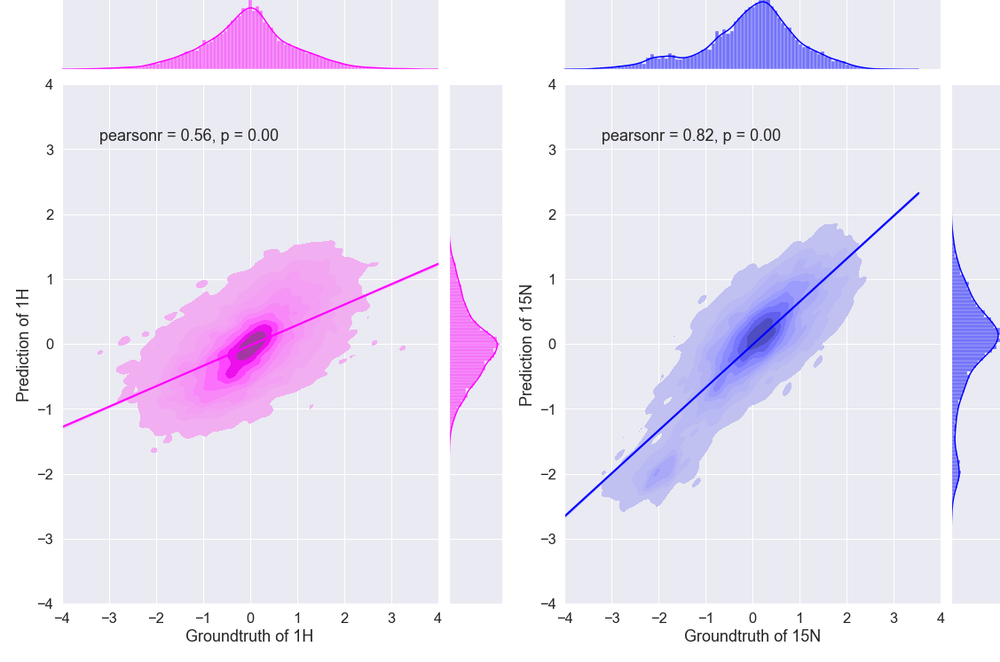

tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+0

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
          -0.8102, -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02,  1.1109e-01, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02,  5.4392e-02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -5.8058e-02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -0.8102, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000,    0.3705, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,    0.3705,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,    0.2443,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000,    0.2443, -100.0000,    0.7285, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([[-1.0000e+02, -1.0000e+02, -2.1922e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  8.6684e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  6.6515e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,   -2.7639,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000,    1.4327,  ..., -100.0000, -100.0000,
         -10

tensor([[-100.0000,    0.2774,    0.3886,  ..., -100.0000, -100.0000,
         -100.0000],
        [   0.2456,    0.2456,    0.1344,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.3648, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.5793,   -0.5013,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.4045,    1.0720,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.2138,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-1.0000e+02,  7.6945e-01, -1.9096e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 5.4349e-01,  1.1940e+00, -7.5567e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  1.4604e+00, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02,  5.1077e-01, -6.0554e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.000

tensor([[-1.0000e+02,  2.3117e-02, -7.2380e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.1992e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -5.4899e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000,   -2.2204,   -0.1994,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    1.6238,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.8303,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([[-100.0000,    0.4522,    0.4045,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    1.3739,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -1.2498,    0.8225,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000,    0.5062,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.7238,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.5539,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-1.0000e+02,  7.4174e-01,  1.3499e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -4.6927e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -5.1373e-01, -4.4111e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  1.4554e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.000

tensor([[-1.0000e+02, -1.0000e+02,  8.0659e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  1.0403e-02,  4.0598e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.3580e-01,  1.1847e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,    1.5164,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    1.1906,    0.1828,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.7144,    1.4947,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.1199,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.8397,    1.4325,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.7269,  ..., -100.0000, -100

tensor([[-100.0000,   -0.2931,    0.9131,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.3726,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.6238,    0.6890,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.5317,    0.5317,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-1.0000e+02,  1.8974e-01,  1.6433e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -6.8747e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02,  9.4421e-01, -1.0455e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.000

tensor([-1.0000e+02, -1.0000e+02,  4.2200e-01,  3.4241e-02,  2.2177e-01,
         3.3142e-01, -2.3103e-03, -6.5878e-02, -1.7871e-01, -2.3592e-01,
        -3.2333e-01, -3.7259e-01, -3.4558e-01,  2.4706e-02,  3.5830e-02,
         4.8544e-02,  6.6025e-02, -2.9313e-01, -6.2700e-02, -1.0000e+02,
         1.5343e-01,  5.3311e-02,  4.0611e-01,  2.8533e-01,  1.8363e-01,
        -1.3262e-01, -2.1367e-01,  2.3448e-01, -2.1381e-02, -2.4228e-01,
         5.5708e-01, -1.0720e-01,  4.5856e-01,  7.5573e-01, -8.7001e-01,
        -1.5693e+00, -1.3261e+00, -8.6524e-01, -2.1000e+00, -1.7743e+00,
        -1.0000e+02,  4.9987e-01, -4.5364e-01, -1.3468e+00,  4.6491e-01,
         1.2945e+00,  2.1223e-01, -8.0644e-01, -1.0000e+02,  1.1370e-01,
        -1.3754e+00, -1.0000e+02,  9.0989e-01,  3.5830e-02, -2.6453e-01,
         7.8911e-01,  1.7236e+00, -6.0302e-01, -9.8602e-01, -1.0973e+00,
        -3.3922e-01,  5.2689e-01, -1.0000e+02,  6.5403e-01, -5.1244e-01,
         2.5673e-01, -4.5046e-01,  8.0500e-01, -6.7

tensor([-1.0000e+02, -2.6771e-01, -1.0000e+02,  1.8045e-01, -1.0000e+02,
         1.7250e-01, -8.3028e-01,  1.3754e-01, -7.5241e-01, -2.3910e-01,
         2.9487e-01, -2.9154e-01, -7.8896e-01, -1.5487e-01, -4.9019e-01,
        -1.5169e-01,  6.8263e-01,  4.5365e-02,  2.7103e-01, -2.6612e-01,
         6.5879e-01, -5.1244e-01, -3.2968e-01, -7.1427e-01, -4.8066e-01,
        -2.4863e-01,  1.7091e-01, -1.3898e-01, -5.3469e-01, -9.8602e-01,
        -1.1845e-02,  5.5232e-01,  1.7091e-01, -1.0385e+00, -7.3652e-01,
        -5.0291e-01, -6.1733e-01,  1.2039e+00,  2.6944e-01, -3.4875e-01,
        -1.5248e+00,  2.9010e-01, -7.1427e-01, -1.6090e+00, -1.9937e-01,
        -1.3229e+00, -4.4093e-01,  6.7786e-01,  1.1211e-01, -1.9189e+00,
         8.9240e-01,  8.4791e-01, -1.0000e+02, -1.9920e+00,  5.9999e-01,
        -4.5046e-01, -1.2768e+00, -1.4818e+00, -2.8360e-01,  8.3678e-01,
        -4.2504e-01, -9.8602e-01,  1.3898e+00, -8.6671e-03, -1.3054e+00,
        -2.9790e-01, -3.4716e-01, -8.7001e-01, -6.3

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         3.0002e-01,  6.4916e-01,  4.4418e-01,  4.4476e-01, -6.2113e-01,
        -1.0000e+02,  1.5606e-01,  2.5826e-01, -1.6972e+00, -2.2544e+00,
        -9.9350e-02, -1.0000e+02, -2.1024e+00, -2.1940e+00,  3.3646e-02,
        -1.0000e+02, -1.8558e-01,  1.7992e-01, -1.9469e+00, -2.1978e+00,
         3.0951e-02, -1.0000e+02, -1.9000e-01, -6.4846e-01,  5.5774e-01,
        -1.9374e+00, -2.1072e+00, -2.1201e+00,  7.8697e-01, -2.2267e+00,
         3.3486e-01, -2.0069e+00, -1.0000e+02, -1.0262e-01,  1.6010e-01,
        -1.9382e+00, -1.0000e+02,  1.7030e-01,  1.4874e-01, -1.9241e+00,
        -2.1087e+00, -2.0733e+00, -3.5065e-02, -3.1793e-02,  2.5325e-01,
        -1.8562e+00,  7.7330e-01, -2.5833e-01, -5.6147e-01,  3.5872e-01,
         6.8015e-01, -1.0000e+02, -2.2400e+00,  8.1763e-02,  2.1129e-01,
         8.8262e-01,  5.3945e-01,  4.7324e-01, -2.5217e-01,  7.4751e-01,
         3.4006e-01,  7.0407e-02, -3.8915e-02, -7.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  1.1577e+00,  2.4844e-01,
         3.7393e-01,  8.5799e-01, -6.2248e-01,  7.6887e-01,  2.0475e-01,
         1.1026e+00, -1.2953e+00, -3.9671e-01, -4.0287e-01, -1.2784e-01,
        -2.3023e+00, -4.2154e-01,  1.2968e+00,  5.3233e-01,  3.5545e-01,
         4.8344e-01,  1.9301e-01, -2.7133e+00, -5.6127e-01, -6.7849e-01,
         4.9018e-01,  7.0344e-01,  6.9882e-01, -5.8841e-01, -1.0000e+02,
        -1.0242e+00,  5.3530e-03,  2.0717e+00,  4.0838e-01, -6.0593e-01,
        -1.9905e-01,  5.4432e-02,  9.5056e-01,  1.5921e+00,  1.3969e+00,
        -7.1717e-01, -2.4697e-01, -1.0180e+00, -7.4181e-01, -1.4035e-01,
         4.5496e-01,  5.8641e-01,  3.7739e-01,  2.6153e-01,  5.8257e-01,
        -2.2676e-01, -2.9579e+00, -1.0000e+02, -8.6576e-01, -2.2522e-01,
         4.1877e-01, -1.0180e+00,  3.0118e-01, -5.7802e-01, -1.0000e+02,
        -1.0000e+02, -7.7087e-01, -6.2825e-01, -9.3235e-01, -2.7507e-01,
         6.4897e-01,  2.1471e+00,  1.3990e+00,  3.5

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  1.4707e-01,  4.9987e-01,
         6.0158e-01, -1.5011e-01, -6.4593e-01, -1.0000e+02,  4.8544e-02,
         1.9157e-01, -1.0083e+00, -1.6169e+00, -3.7577e-01,  8.7492e-01,
         1.0799e+00, -4.6159e-01,  2.9474e-02, -7.2112e-04,  6.4131e-01,
         6.8263e-01,  8.4473e-01, -6.6024e-01,  1.1928e+00,  2.5991e-01,
         3.0917e-01,  2.3448e-01,  2.6278e+00,  2.7898e-01, -1.0000e+02,
         1.0799e+00, -5.2356e-01,  5.6503e-01,  7.3971e-02,  1.4470e+00,
        -4.9178e-01, -1.6789e+00, -2.1016e+00, -1.0000e+02, -1.0000e+02,
         7.5097e-01, -1.0083e+00,  1.0307e+00, -9.7966e-01,  7.7957e-01,
        -1.0000e+02, -1.0000e+02, -3.1220e-01,  1.2959e-01,  5.3325e-01,
        -4.2852e+00,  1.7077e+00,  3.1332e+00,  1.2420e+00, -6.6818e-01,
        -2.3115e-01, -5.5853e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -4.8066e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -3.3127e-01, -9.4483e-02, -5.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  5.3311e-02,  2.5355e-01,
         3.7274e-01, -8.3664e-01, -9.3993e-01,  1.1688e-01, -1.3738e+00,
        -7.8737e-01, -1.0000e+02, -1.0000e+02,  4.9670e-01, -1.1863e+00,
         1.7522e+00, -1.2498e+00, -4.3629e-02, -1.6918e-01,  9.4485e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.5694e-01, -1.3801e+00,
         3.0283e+00,  3.6320e-01,  3.3301e-01,  4.2200e-01,  2.0111e-01,
         1.0609e+00, -3.0916e-02, -1.9936e+00, -1.3435e-02, -1.3086e+00,
         1.3913e-01,  1.5567e+00,  7.6527e-01, -4.2345e-01, -1.0000e+02,
        -1.0000e+02,  5.0623e-01, -4.5364e-01, -1.7758e+00,  4.1724e-01,
         1.1370e-01, -3.5193e-01, -1.6916e+00,  1.1847e-01,  6.2542e-01,
        -1.6424e+00, -8.6537e-02,  1.8618e+00, -1.1243e+00, -1.7202e+00,
         1.3914e+00,  2.7580e-01, -1.7917e+00, -1.1910e+00, -9.0974e-01,
        -1.2578e+00, -2.2431e+00, -1.0000e+02, -1.9316e+00, -2.0096e-01,
         2.1528e-02,  1.2579e+00, -1.2991e+00,  1.2

tensor([-1.0000e+02, -1.0000e+02,  3.6003e-01, -9.7662e-02, -1.0000e+02,
        -1.0000e+02,  2.5991e-01,  1.9316e-01,  6.6025e-02, -2.1049e-01,
        -3.6147e-01, -4.1232e-01,  4.5365e-02, -7.8591e-02, -9.2894e-02,
         1.9952e-01, -7.3824e-02,  5.6356e-03, -9.2894e-02, -3.2968e-01,
         5.1736e-01, -1.0000e+02,  1.4899e+00,  3.0281e-01,  2.1558e+00,
        -1.0000e+02, -2.0732e-01, -2.6148e-02, -4.5841e-01, -1.9936e+00,
        -5.1244e-01,  2.6944e-01,  1.5343e-01,  4.7921e-01, -1.0402e-01,
        -1.2786e-01,  9.8299e-01,  5.3801e-01, -1.7902e+00, -7.3016e-01,
        -5.7124e-01, -2.5817e-01,  1.0672e+00,  1.8046e+00,  6.6992e-01,
         5.6026e-01, -7.3493e-01,  3.2506e-01, -3.4399e-01, -1.0000e+02,
        -2.2639e-01,  9.6869e-01, -8.2074e-01,  1.0403e-02, -4.1709e-01,
        -1.4453e+00,  4.0611e-01,  8.5585e-01, -1.0000e+02,  1.9031e+00,
         7.0170e-01,  9.8934e-01,  1.3326e+00,  6.1257e-02, -1.2085e+00,
         3.0758e-01,  1.0656e+00, -2.4069e-01,  1.5

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -8.1065e-02, -1.0000e+02,  2.0860e-01, -1.0000e+02,  7.2139e-02,
         4.0703e-01,  5.2315e-02, -3.2993e-01, -1.1013e-01,  6.8515e-01,
         4.9681e-03, -2.5871e-01, -1.5561e+00, -1.2189e+00, -1.5355e+00,
         4.8595e-01, -1.4279e-02,  6.5243e-01, -4.0070e-02,  1.1718e-01,
        -2.4505e-01,  2.0071e-01,  1.5278e-01, -3.1799e-01, -4.1230e-01,
        -3.1819e-01,  7.4020e-01, -4.4406e-01,  5.6813e-01,  1.8826e-02,
        -1.0000e+02,  1.3111e+00,  4.6381e-01,  3.8490e-01,  4.0896e-01,
        -1.5943e+00,  7.8254e-01, -1.0000e+02, -1.0022e+00, -4.8910e-01,
         7.7003e-01, -1.1354e+00, -8.2823e-01,  6.5018e-02,  1.2770e+00,
        -4.0306e-01, -1.0000e+02, -1.2222e+00,  3.8132e-03,  7.7677e-01,
        -1.0000e+02,  9.7000e-01,  9.7886e-01, -7.6414e-01, -2.1451e+00,
         6.9978e-01,  5.1116e-01,  1.5784e+00,  1.1396e+00,  9.3055e-01,
        -1.3834e-03,  3.4891e-01, -1.4766e-01, -1.0

tensor([-2.0255e-01, -1.0000e+02,  2.2971e-01, -3.5988e-01, -1.0561e-01,
         4.0465e-03, -8.8908e-01, -2.6294e-01, -4.1232e-01,  8.6684e-02,
        -1.7076e-01, -8.6537e-02,  1.3913e-01, -1.9937e-01,  1.0403e-02,
        -4.8701e-01, -4.3616e-01, -3.0267e-01, -1.0000e+02, -1.1847e+00,
        -3.1856e-01, -1.6600e-01, -4.9337e-01, -4.3775e-01, -9.7807e-01,
        -9.9714e-01, -9.4152e-01, -9.7331e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  3.7274e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  2.9328e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  9.1452e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 2.6165e-01,  1.2066e+00,  7.7909e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  3.5872e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  7.5796e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  3.1888e-01

tensor([-1.0000e+02, -1.0000e+02,  5.0623e-01,  3.2347e-01,  1.3582e-02,
         2.5991e-01, -8.8127e-02, -1.0000e+02,  1.3913e-01, -1.2468e-01,
         1.8349e-02,  3.3301e-01,  7.8738e-02, -4.5205e-01, -3.2505e-02,
        -1.8666e-01,  3.2652e-02,  1.8839e-01,  3.9976e-01, -1.2627e-01,
         1.5661e-01,  2.5196e-01,  1.5661e-01, -2.9327e-02,  3.5685e-01,
        -8.8590e-01,  1.4232e+00,  5.3007e-01,  1.2595e+00,  2.9964e-01,
         1.3676e+00,  6.4926e-01,  9.0353e-01,  4.4425e-01,  8.9558e-01,
         3.8704e-01, -1.4596e+00, -1.0000e+02,  1.4152e+00,  6.4131e-01,
        -9.0815e-01,  8.0659e-01, -5.1721e-01,  1.4280e+00,  1.0291e+00,
         2.2494e-01,  1.5201e+00,  4.3790e-01, -2.9949e-01,  2.5579e+00,
         9.4644e-01,  9.4644e-01,  1.7569e+00, -1.4882e+00,  1.1149e+00,
        -1.4693e-01,  8.9082e-01,  2.0462e+00, -1.2911e+00,  8.0341e-01,
         1.1069e+00,  1.9858e+00, -1.7076e-01, -8.2551e-01, -1.4183e+00,
        -8.3187e-01, -2.1938e+00,  9.7027e-01,  1.2

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -2.1526e-01,  5.4901e-02,
        -7.2380e-01, -4.2186e-01,  1.4057e+00,  1.5170e+00,  1.6759e+00,
         7.0792e-02,  1.5025e-01,  1.2627e+00,  8.1771e-01,  5.4901e-02,
        -1.0000e+02,  5.0291e+00,  2.9328e-01, -1.0575e+00, -1.4548e+00,
        -7.0791e-01, -1.0000e+02,  2.4705e+00, -7.0791e-01, -1.4548e+00,
        -8.0326e-01,  7.3825e-01, -6.6024e-01,  7.0792e-02,  3.9009e-02,
         1.0258e-01, -1.8348e-01, -3.4240e-01, -8.0326e-01, -1.3118e+00,
        -6.1256e-01, -6.2845e-01,  3.5685e-01,  1.6282e+00,  5.3166e-01,
        -1.4866e+00, -4.8542e-01,  1.9793e-01,  6.7469e-01,  8.3360e-01,
         3.7274e-01, -1.6773e+00, -1.8998e+00, -1.9937e-01, -6.6024e-01,
        -1.3754e+00,  6.9058e-01, -1.3595e+00, -2.4705e-01,  1.0243e+00,
         1.1038e+00, -4.0451e-02,  1.3898e+00, -1.2959e+00,  5.4901e-02,
         1.7236e+00, -7.7148e-01,  1.4852e+00,  1.6123e+00,  1.0402e+00,
         1.0561e+00, -8.0326e-01, -1.0000e+02, -1.0

tensor([-1.0000e+02,  1.0558e+00,  1.8056e-02,  2.5710e-01,  4.5457e-01,
         7.7330e-01,  1.0533e+00, -1.0000e+02, -1.0000e+02, -1.4674e+00,
        -3.9691e-01,  1.8781e-01,  1.0697e+00,  1.3890e+00, -3.9383e-01,
         3.0368e-01, -1.0000e+02, -1.1997e+00, -1.0000e+02, -1.4172e+00,
        -8.3375e-02,  9.6346e-01,  4.6901e-01, -4.6947e-01,  9.6500e-01,
         1.8263e+00,  1.5394e-01,  4.2359e-01, -2.2742e+00, -4.2905e-01,
         4.1050e-01, -1.4270e+00, -5.3433e-01,  1.6029e-01, -4.4849e-01,
         1.0737e+00, -1.0000e+02, -8.0513e-01, -1.7550e+00, -1.6768e-01,
        -5.8302e-01, -3.5803e-01, -3.0240e-01, -1.7178e+00, -2.1022e+00,
         2.3708e-01,  1.1221e+00, -1.0553e+00,  1.3437e-02, -1.8275e+00,
         4.5111e-01, -1.0000e+02,  5.8853e-01, -8.0398e-01, -1.1187e+00,
         2.2015e-01, -3.7650e-01, -5.7455e-01,  8.4842e-02,  1.1253e+00,
         1.4781e+00,  1.6702e+00,  1.1444e+00, -1.0459e+00, -1.1162e+00,
         1.7973e-01,  3.4621e-01,  4.1550e-01, -9.3

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         2.2812e-01, -9.7662e-02,  9.9398e-02,  1.6773e-01,  2.4706e-02,
        -1.0000e+02, -3.0902e-01,  8.3506e-02,  8.8140e-03, -5.8872e-01,
         1.1688e-01, -1.0000e+02,  1.9475e-01, -3.5670e-01, -1.9937e-01,
        -1.0000e+02,  8.8140e-03,  2.9964e-01,  1.8521e-01, -3.7259e-01,
        -1.9619e-01, -1.0000e+02,  1.1992e-02,  7.2382e-02,  1.6773e-01,
         9.3041e-02, -7.2112e-04,  1.5171e-02, -4.9986e-02,  1.4707e-01,
        -2.6612e-01,  2.3607e-01, -1.0000e+02,  3.0917e-01,  1.1211e-01,
         1.9157e-01, -1.0000e+02,  3.6320e-01,  6.2847e-02,  1.7250e-01,
        -4.8397e-02,  4.2187e-02, -1.4375e-01,  8.0328e-02, -8.8127e-02,
         2.6295e-02, -4.3139e-01, -3.7895e-01, -4.0438e-01, -4.4093e-01,
        -3.4094e-02, -1.0000e+02, -2.2321e-01, -4.9337e-01, -4.7271e-01,
        -1.6282e-01, -3.6465e-01, -3.8848e-01, -3.0585e-01, -3.8213e-01,
        -5.8554e-01, -7.3969e-01, -4.7907e-01, -3.4

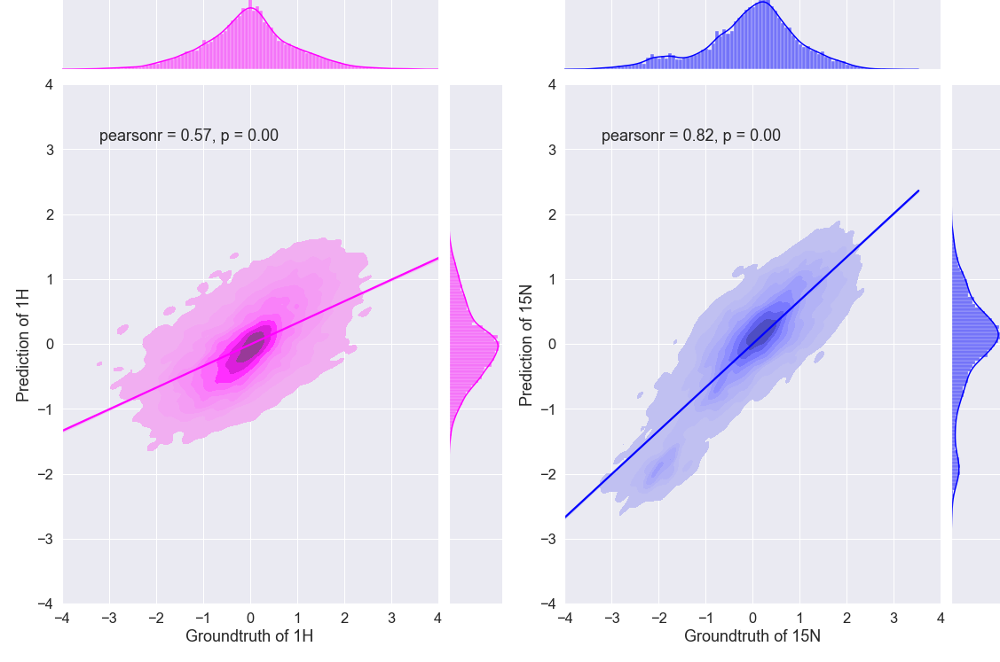

tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+0

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
           0.3705, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
          -0.8102, -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -8.1023e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -8.1023e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -8.1023e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -8.1023e-01,
        -1.0000e+02, -8.1023e-01, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.1175e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.1175e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.1175e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+0

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0

tensor([-100.0000, -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000,
        -100.0000,   -0.8102,   -0.8102, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102,    0.4542,
           0.2855, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([[ 2.3117e-02,  3.8863e-01, -5.3310e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -5.4887e-03,  5.1894e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 4.6809e-01,  1.0258e-01,  6.2701e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 8.6684e-02,  2.2971e-01, -5.8078e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  4.9987e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[   0.6243,    0.1355,    0.1104,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.5227,    0.8384,  ..., -100.0000, -100.0000,
         -100.0000],
        [  -0.9886,    1.1094,    1.1286,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  8.3837e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 3.9009e-02, -6.2845e-01, -5.1721e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02,  4.6809e-01, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  7.4779e-01, -2.2970e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.6902,  ..., -100.0000, -100.0000,
         -100.0000],
        [   0.5781,   -0.7210,    0.7456,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.6667, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -8.9716e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  6.0953e-01, -4.8066e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 2.6150e-01,  3.0917e-01,  2.3117e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  9.0232e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02

tensor([[ 5.4901e-02,  2.1382e-01,  2.1382e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 4.8080e-01,  1.1688e-01,  1.7250e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.1991e-01,  7.2248e-03,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  6.1779e-01,  3.0929e-03,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  1.6729e-01, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-6.9985e-01,  7.4366e-01,  1.0901e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 5.3464e-01, -6.3191e-01,  5.0635e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -5.6512e-01, -4.4964e-01

tensor([[-1.0000e+02, -1.0000e+02,  3.6320e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 1.1992e-02, -1.6282e-01,  4.6955e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -6.9215e-02,  2.5848e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  4.0452e-01,  1.0720e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-5.7932e-02, -1.8825e-01, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -1.0000e+02, -9.5308e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-7.1159e-01,  5.1944e-01,  1.1775e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.4177e-01,  6.8625e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02

tensor([[-100.0000, -100.0000,    0.4999,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    1.4375,    0.2138,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.4363,  ...,   -0.8986,    0.2456,
           -0.9940],
        ...,
        [-100.0000, -100.0000,   -0.1215,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-100.0000, -100.0000,   -0.2730,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.5512,    0.8014,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.7244,  ...,    0.1258,    1.3191,
            1.3153],
        ...,
        [-100.0000, -100.0000,    1.2828,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100

tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    1.8507,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.7238,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [   0.7700,    1.1832, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    1.1054,    1.4550,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.4701e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.9981e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [ 8.264

tensor([-1.0000e+02,  7.0488e-01,  9.5756e-01, -3.6465e-01, -2.0414e-01,
        -4.6318e-01,  5.5391e-01, -2.1381e-02,  7.1283e-01, -4.9986e-02,
        -1.1910e+00, -1.6918e-01,  6.4449e-01, -3.9166e-01, -1.2514e+00,
        -1.0909e+00,  2.9010e-01, -9.5265e-01, -1.2737e+00,  9.2260e-01,
        -4.6953e-01,  2.8868e+00,  1.5424e+00,  1.3754e-01, -3.2333e-01,
         2.5037e-01, -5.8713e-01, -8.2869e-01,  2.1700e-01, -6.1097e-01,
         4.7763e-01, -3.4399e-01,  6.2542e-01, -1.7712e-01, -3.2968e-01,
        -4.1550e-01, -1.4739e+00,  3.2506e-01, -7.7307e-01, -3.0916e-02,
         4.2359e-01, -1.5454e+00, -1.5502e+00, -1.0000e+02, -2.9631e-01,
        -1.0000e+02, -9.7662e-02, -1.1673e-01, -2.7737e-02, -8.0803e-01,
        -8.0803e-01,  4.7286e-01, -3.4399e-01,  3.0440e-01, -1.9142e-01,
        -1.0051e+00,  8.8274e-02,  1.5599e+00, -5.3628e-01, -3.0585e-01,
         2.0303e+00, -1.4564e+00, -8.6047e-01, -2.3289e+00,  2.6056e+00,
         4.2836e-01,  1.5456e+00,  8.5903e-01,  4.0

tensor([-1.0000e+02, -1.0000e+02,  1.9793e-01,  1.5025e-01, -2.1526e-01,
        -5.9667e-01,  1.3580e+00,  3.2506e-01,  1.4534e+00,  1.0720e+00,
         1.9793e-01,  1.5805e+00,  8.4950e-01, -6.1256e-01,  3.8863e-01,
        -1.0000e+02,  1.0084e+00, -1.6932e+00,  1.8204e-01, -4.8542e-01,
         1.1847e-01,  8.3360e-01, -1.2482e+00,  7.5414e-01, -9.6218e-01,
         6.9058e-01, -7.8737e-01, -5.1721e-01, -4.2186e-01, -1.0000e+02,
        -6.7613e-01, -1.8362e+00, -1.0000e+02,  1.5805e+00,  2.3751e+00,
         8.3360e-01, -4.2186e-01, -8.8272e-01, -6.4434e-01, -1.0000e+02,
        -1.0000e+02,  7.0647e-01,  8.6684e-02, -2.0269e+00, -3.2651e-01,
         2.7739e-01,  1.4693e+00, -8.0326e-01,  7.8593e-01,  7.2236e-01,
        -4.6953e-01, -1.0000e+02,  2.6135e+00, -1.0402e-01, -7.7148e-01,
        -4.0451e-02,  3.8863e-01,  1.1673e+00,  1.6918e+00, -4.0451e-02,
         7.0792e-02, -1.5169e-01, -8.1915e-01, -2.1064e+00, -1.3118e+00,
        -3.4890e+00,  2.0573e+00,  1.7394e+00,  1.3

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -2.0732e-01, -1.2721e+00,
         2.5658e+00,  9.8458e-01,  2.4084e-01,  2.7103e-01, -2.6261e+00,
        -5.5217e-01, -1.8505e+00, -1.1894e+00,  1.2420e+00,  5.5550e-01,
        -4.9986e-02,  4.4902e-01,  2.8533e-01,  1.4756e+00,  5.0782e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02,  2.2812e-01, -2.1526e-01, -1.1259e+00,
        -5.6171e-01, -1.0000e+02, -4.0341e+00,  4.6650e-01, -9.9079e-01,
        -1.0000e+02,  1.6520e+00, -1.0750e+00,  9.6710e-01,  6.9693e-01,
         6.6674e-01,  3.4572e-01, -1.0000e+02,  1.2641e-01, -1.0000e+02,
         2.2335e-01,  1.1657e+00, -1.8919e+00, -4.8860e-01,  3.4241e-02,
         1.3582e-02,  1.5932e+00,  3.6161e-01, -8.2551e-01,  9.9411e-01,
         3.9658e-01,  4.4107e-01, -4.5364e-01,  7.1918e-01, -8.7478e-01,
        -1.0702e+00, -9.4629e-01, -1.3023e+00, -1.0000e+02, -2.5976e-01,
         2.8374e-01,  1.5217e+00,  2.1812e+00,  1.7

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  4.1724e-01,
        -1.3226e-01,  1.0967e-01, -4.7120e-01, -2.0771e-01, -1.5478e-01,
        -3.2685e-01, -6.7785e-02, -3.9190e-01, -1.4708e-01,  2.9136e-01,
        -7.0582e-01, -6.2787e-01, -2.7681e-01,  9.8123e-02, -1.5170e-01,
        -2.7777e-01, -1.0313e+00, -1.1017e+00, -1.0000e+02, -7.7068e-01,
        -6.1247e-01,  3.2876e-02,  5.8334e-01,  9.4672e-01, -1.0000e+02,
         1.5395e+00, -5.1720e-01,  5.7487e-01,  1.1484e+00, -1.0000e+02,
         1.6696e+00, -1.0000e+02,  4.7536e-01, -7.4989e-01,  1.2062e+00,
         1.4831e+00, -1.0000e+02,  1.5726e+00,  8.0795e-01,  5.4426e-01,
         1.9666e+00,  1.2339e+00,  3.5430e-01, -1.0000e+02, -1.0000e+02,
         4.4880e-01,  9.7231e-01,  8.2931e-01,  3.8721e-01,  3.0566e-02,
        -3.9498e-01,  1.8615e+00,  1.5422e+00,  1.2477e+00,  9.0014e-01,
         1.3898e+00,  1.6425e+00, -1.0000e+02, -1.0000e+02, -9.3274e-01,
         1.1149e+00, -2.9624e-01,  1.3663e+00,  1.8

tensor([-1.0000e+02, -5.3310e-01,  3.9009e-02, -1.6455e+00,  2.5817e+00,
         1.5646e+00, -5.6343e-02,  1.1356e+00,  1.4216e+00,  3.8863e-01,
         4.6809e-01, -2.4705e-01, -3.2651e-01,  5.4755e-01,  1.5328e+00,
         3.5511e+00,  2.1367e+00, -3.5367e+00,  7.2248e-03,  1.8204e-01,
        -6.9202e-01,  1.6614e-01,  1.0402e+00,  1.8348e+00,  1.5025e-01,
        -1.7886e+00,  1.1197e+00,  6.9058e-01, -1.8998e+00,  3.5685e-01,
         2.4560e-01, -3.5829e-01,  2.5976e+00,  7.2248e-03,  1.8204e-01,
         1.8030e+00,  9.6074e-01,  5.6344e-01, -1.0000e+02, -2.1526e-01,
        -4.2186e-01, -1.0000e+02, -1.1529e+00,  9.1306e-01,  5.6344e-01,
        -1.0000e+02,  4.5220e-01, -6.7613e-01, -1.6138e+00, -2.7883e-01,
         7.0647e-01, -1.0099e+00, -2.1526e-01, -1.0734e+00, -1.7409e+00,
        -7.7148e-01, -8.0326e-01,  8.8128e-01,  8.6684e-02,  7.0647e-01,
         5.4901e-02, -1.0099e+00,  9.1306e-01,  5.6344e-01,  3.2015e+00,
        -3.1061e-01, -6.2845e-01,  8.6684e-02,  1.3

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -3.6624e-01,
         8.2089e-01, -1.0000e+02, -1.0000e+02, -5.4581e-01,  7.3031e-01,
        -9.6377e-01, -2.7247e-01,  7.3825e-01, -1.1004e+00, -9.2086e-01,
         1.0068e+00,  4.8716e-01, -5.9826e-01,  8.5744e-01,  1.9826e+00,
        -4.7430e-01, -8.7001e-01,  1.1370e-01, -9.0179e-01, -6.9838e-01,
        -1.7712e-01, -1.3452e+00, -8.3981e-01, -2.8836e-01, -1.0000e+02,
        -2.2798e-01, -1.0000e+02, -1.0000e+02, -1.1433e+00, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -2.8152e+00, -9.7172e-01,  2.5991e-01,
        -1.3086e+00, -3.4094e-02, -3.0267e-01, -6.9

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  1.1052e-01, -8.6671e-03,
         2.5196e-01, -3.9961e-01,  8.6684e-02, -2.2003e-01,  1.9793e-01,
         3.2824e-01, -9.4483e-02, -3.5683e-02, -2.6294e-01, -3.3922e-01,
        -4.5523e-01, -1.7871e-01, -4.9814e-01, -3.3445e-01, -7.3824e-02,
        -5.6488e-01, -1.7553e-01,  1.1356e+00,  6.2224e-01,  1.1085e+00,
         3.1235e-01, -5.3787e-01, -4.2821e-01,  9.2101e-01, -1.9460e-01,
        -8.9544e-01, -6.3004e-01,  7.8911e-01,  5.8251e-01,  1.4548e-01,
        -8.6047e-01, -1.3262e-01, -1.5328e-01, -1.0000e+02,  1.6932e-01,
        -9.4311e-01,  5.2722e+00,  1.3151e+00,  2.3925e-01, -3.1856e-01,
        -1.1561e+00, -7.3824e-02, -1.0000e+02, -8.2710e-01, -4.5682e-01,
         3.6161e-01, -9.4152e-01, -5.7601e-01, -8.1770e-02, -1.6535e+00,
        -1.3293e+00, -1.0000e+02,  1.2420e+00, -9.0020e-01, -1.2180e+00,
         8.3360e-01, -5.0291e-01,  8.6062e-01, -1.7235e-01,  5.0623e-01,
        -5.3946e-01, -1.0000e+02,  3.1394e-01,  1.6

tensor([-1.0000e+02, -1.0000e+02,  2.9328e-01, -1.1991e-01,  2.2162e+00,
         1.4216e+00,  2.9328e-01,  1.2786e+00,  1.4216e+00,  4.5220e-01,
         4.9987e-01, -8.8127e-02,  4.5220e-01,  1.4693e+00,  1.9301e+00,
         4.0279e+00,  2.5181e+00, -3.4890e+00,  1.9793e-01,  5.1577e-01,
        -1.2800e+00, -6.2845e-01,  8.8128e-01,  1.4216e+00, -3.7418e-01,
        -1.5025e+00, -1.9937e-01,  9.7663e-01, -4.0451e-02,  2.9328e-01,
         1.5805e+00, -4.0596e-01,  2.1844e+00,  7.0792e-02,  8.1771e-01,
         1.9460e+00,  1.2468e+00,  2.7739e-01, -1.2482e+00, -5.0132e-01,
        -4.0596e-01,  1.3580e+00, -5.9667e-01,  1.3263e+00, -1.3580e-01,
        -1.0000e+02,  5.9523e-01, -5.0132e-01, -9.7807e-01, -8.8127e-02,
         8.0182e-01, -4.6953e-01, -1.9937e-01, -9.3040e-01, -1.6455e+00,
        -6.9202e-01, -7.5559e-01,  1.0243e+00,  4.0452e-01,  5.1577e-01,
         1.0258e-01, -1.0099e+00,  7.8593e-01,  7.8593e-01,  3.4717e+00,
        -4.3775e-01, -1.0099e+00, -1.1991e-01,  1.4

tensor([[-1.0000e+02, -1.0000e+02,  9.1452e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02,  4.6968e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -8.0181e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  5.6344e-01,  2.7739e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,    0.3189,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000,    0.2117,  ..., -100.0000, -100.0000,
         -10

tensor([-1.0000e+02, -1.0000e+02,  6.6918e-01,  3.0118e-01,  2.4132e-01,
         7.4449e-02, -1.2739e-02,  1.5394e-01,  5.6005e-01, -2.1249e+00,
        -1.0346e+00,  1.7272e+00,  6.9477e-01, -1.8981e-01,  3.2831e-01,
        -6.1035e-01,  8.0891e-01, -4.9391e-01,  7.4366e-01,  4.5573e-01,
        -1.0000e+02, -1.0000e+02, -8.6152e-01, -1.0000e+02,  2.2483e-02,
         2.5364e-01, -2.2700e+00,  2.0995e-01, -1.0000e+02,  1.1777e+00,
        -2.7529e+00, -3.8035e-01,  9.5230e-01, -4.8255e-01,  1.8858e+00,
         1.2431e+00, -1.0000e+02,  7.1441e-01, -9.9606e-01,  2.9194e-01,
        -1.0000e+02,  9.2497e-01,  1.3451e+00,  7.6951e-02, -1.0000e+02,
        -2.5144e+00, -3.2935e-01, -1.6449e+00,  3.9395e-01,  1.1477e+00,
         3.4390e-01,  1.6029e-01,  1.1284e+00,  5.1828e-01, -6.8253e-01,
         1.2199e-01, -1.0000e+02, -1.0000e+02, -2.4854e+00, -1.9884e+00,
         9.9695e-01,  4.5977e-01,  2.0626e+00,  1.7279e+00,  1.4646e+00,
         1.9325e+00,  5.5600e-01,  6.9246e-01, -1.5

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02,  3.9340e-01,  2.6467e-01,
        -6.0461e-01,  2.0270e-01,  1.2482e-01,  4.3631e-01, -4.7430e-01,
         4.1406e-01,  1.5025e-01, -3.6624e-01, -5.1244e-01, -4.1391e-01,
        -5.5376e-01, -1.6123e-01,  3.8863e-01,  7.8738e-02, -9.0338e-01,
         1.0227e+00,  1.2881e+00, -7.2221e-01,  1.4407e+00,  4.6968e-01,
        -4.9019e-01, -1.1990e+00, -4.1550e-01,  1.9316e-01, -9.7013e-01,
        -3.8995e-03,  2.9964e-01, -2.5976e-01, -8.7954e-01,  2.9964e-01,
        -3.8213e-01, -1.4216e-01, -1.8776e+00, -1.0000e+02,  1.6663e+00,
        -6.6500e-01, -1.0000e+02,  1.4995e+00,  9.3849e-01,  1.5964e+00,
         9.2896e-01,  5.8887e-01,  1.4391e+00, -4.9558e+00,  6.1589e-01,
        -3.4922e+00, -2.1541e+00,  5.7616e-01,  1.1721e+00,  1.4072e-01,
        -8.9226e-01, -2.3115e-01,  8.1771e-01, -8.4617e-01, -1.3420e+00,
        -2.1049e-01, -5.9667e-01,  4.6014e-01,  8.6

tensor([-1.0000e+02, -1.0000e+02,  5.0776e-02,  1.1883e+00,  2.4036e-01,
         3.2177e-01,  1.9936e-01,  2.1052e-01,  3.4608e-02,  3.7893e-01,
        -2.7307e-03, -4.3726e-02,  1.4278e-01,  3.4968e-01, -7.1929e-01,
         1.5663e-01,  2.0340e-01, -1.4689e-01, -2.8739e-01, -6.1189e-01,
         1.2793e+00, -3.2896e-01,  2.2958e-01,  1.5452e-01, -5.7378e-01,
         2.4863e-01,  3.1523e-01, -4.5542e-01, -1.6406e+00, -2.0639e+00,
        -1.0000e+02,  3.0214e-01,  1.6685e+00, -3.0029e-01,  1.1513e+00,
        -1.0000e+02, -4.0460e-01,  6.4820e-01, -7.7434e-01, -1.5247e-01,
        -1.5209e-01,  7.5194e-01,  1.0147e+00,  1.0789e+00,  1.2175e+00,
        -1.0000e+02, -3.2800e-01, -1.4189e-01,  8.4759e-01, -1.3784e-01,
         3.7297e-01, -7.4470e-01, -3.0529e-01,  1.8801e-01, -4.8024e-01,
        -2.9691e+00, -4.6639e-01, -5.1758e-01,  1.7511e-01,  7.9678e-01,
         2.8257e-02, -9.7412e-01, -1.4815e+00, -4.8409e-01, -7.8319e-01,
        -3.6900e-01,  1.8666e-01,  1.4797e-01, -4.3

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  9.3709e-01, -1.0000e+02,  7.4077e-01,  1.8088e-01,
        -1.0000e+02,  4.2744e-01,  1.1025e-01, -1.0000e+02, -1.0000e+02,
        -1.9807e+00, -1.1485e+00, -1.3061e+00,  2.4998e-01, -1.0000e+02,
        -1.1595e+00,  4.2917e-01,  1.1222e+00, -1.0000e+02, -1.0000e+02,
        -7.8756e-02, -7.6952e-01,  1.6298e-01, -6.1818e-02,  1.9224e-01,
         6.9728e-01, -3.9498e-01, -1.2948e+00, -1.9761e+00,  7.3635e-01,
        -2.8521e-02, -1.0000e+02, -2.8305e+00, -1.6087e+00,  9.2092e-01,
        -1.0000e+02, -1.0000e+02,  9.5422e-01, -4.2154e-01, -1.4189e-01,
        -1.0000e+02, -1.0000e+02, -2.0752e-01, -4.7158e-01, -4.9116e-02,
        -3.5110e-01, -8.3901e-01, -1.8524e+00,  2.8924e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.2091e-01,  5.4388e-01, -2.6428e+00,
         8.5337e-01,  3.6431e-01,  1.3469e-01, -1.9558e-01, -4.5003e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  8.9764e-01,
         2.0475e-01, -2.3793e-01, -2.4128e+00, -2.5717e-01,  4.5496e-01,
        -1.0078e+00, -6.6136e-01, -1.2245e-01, -1.2003e+00, -2.1434e+00,
         7.4366e-01,  4.3571e-01, -6.4705e-02, -6.8060e-01, -1.0320e-01,
         1.6626e-01, -2.3743e+00, -3.7265e-01, -6.4705e-02, -1.0655e+00,
         5.0776e-02, -2.1868e-01,  5.0776e-02, -4.3040e-01, -2.3793e-01,
         5.3195e-01, -1.0000e+02, -4.3040e-01, -3.0095e+00, -1.6237e+00,
         1.1094e+00, -4.8814e-01,  5.1270e-01,  3.0098e-01, -6.9650e-03,
        -2.8940e+00,  4.5496e-01,  2.4324e-01, -3.7265e-01, -8.3952e-02,
        -9.3081e-01, -1.1233e+00, -2.0086e+00, -1.2245e-01, -5.0738e-01,
         8.2065e-01, -6.2286e-01,  3.5872e-01,  3.0098e-01, -5.8437e-01,
         2.4324e-01,  1.6626e-01,  1.4701e-01,  9.1688e-01, -6.9650e-03,
        -1.8019e-01, -9.6931e-01,  3.3948e-01, -4.8814e-01,  1.3018e+00,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  7.2872e-01, -6.0461e-01,
         4.0929e-01, -2.0891e-01,  1.3628e+00,  4.8398e-01,  2.0048e+00,
         1.1117e+00,  1.6727e+00,  6.7786e-01,  1.3072e+00,  3.0123e-01,
         7.3349e-01,  2.2925e+00, -6.9679e-01, -1.5994e+00, -1.0000e+02,
        -5.1880e-01,  3.4254e-01,  3.3619e-01, -1.0830e+00, -1.0257e+00,
         2.5037e-01, -1.0448e+00, -1.7218e+00, -8.8431e-01, -1.0000e+02,
         9.0035e-01, -1.2896e+00,  4.3313e-01,  1.4057e+00,  1.1260e+00,
        -8.8749e-01,  4.1247e-01,  4.8398e-01,  1.0879e+00, -1.0000e+02,
        -1.3865e+00, -1.6613e-02, -9.8284e-01,  1.0768e+00,  6.9376e-01,
         1.3994e+00,  1.3088e+00,  9.6551e-01,  9.6551e-01,  8.2248e-01,
         4.0611e-01, -1.7488e+00,  6.7786e-01,  4.5697e-01,  3.6320e-01,
        -9.8761e-01, -4.3457e-01, -8.1439e-01,  1.9793e-01,  1.2959e-01,
        -4.9337e-01, -4.6635e-01, -4.1709e-01, -5.1721e-01, -1.6773e+00,
        -1.3531e+00,  6.8263e-01,  6.8740e-01, -6.7

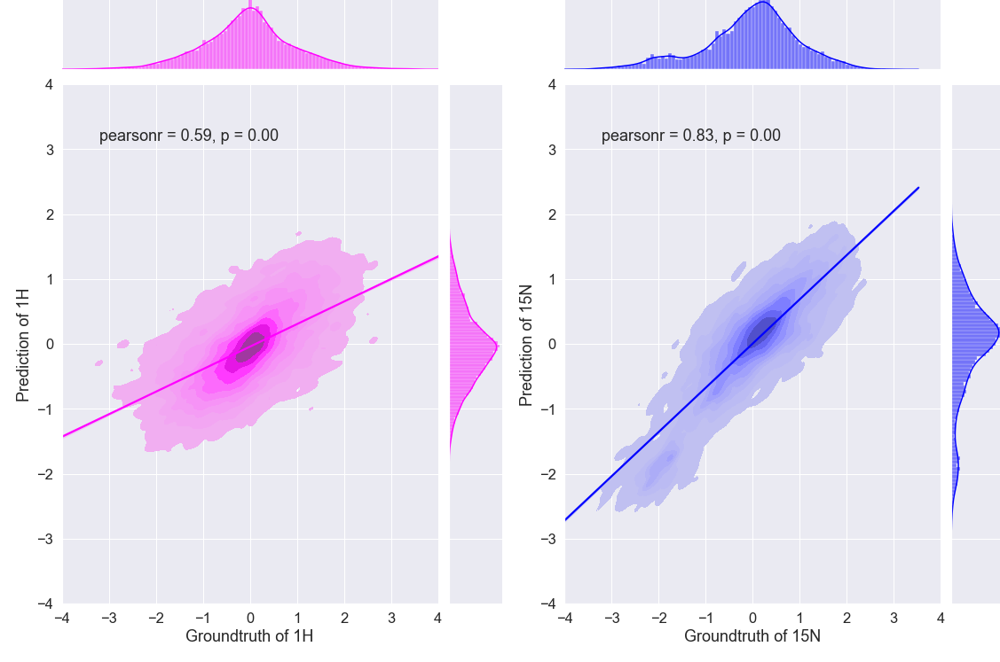

tensor([[-1.0000e+02, -1.0000e+02, -5.8058e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,   -0.8102,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([-1.0000e+02, -1.0000e+02, -8.1023e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -8.1023e-01, -1.0000e+02, -1.0000e+02,
        -8.1023e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -8.1023e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-100.0000,   -0.8102, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,   -0.8102,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000,
          -0.8102, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102,   -1.9214,   -0.6221,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02,  1.1175e-02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  1.1175e-02, -1.0000e+02, -1.0000e+02, -6.2869e-02,
        -1.0000e+02, -1.0000e+02,  9.6779e-02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([[-1.0000e+02,  8.0182e-01, -1.1767e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  1.8204e-01,  8.6684e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  4.2041e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-1.0000e+02, -9.7040e-02, -4.6889e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  1.3230e+00,  9.8893e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  2.1630e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02

tensor([[-1.0000e+02,  4.2995e-01, -4.7907e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -2.1381e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.0575e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02,  1.0084e+00,  5.6344e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  2.4560e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000,    0.1460,   -1.0230,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    1.9141,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.3732,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.5704,    2.2449,  ..., -100.0000, -100.0000,
         -10

tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.2075,    0.5857,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.2073,  ..., -100.0000, -100.0000,
         -100.0000],
        [   0.4681,    0.1026,    0.6270,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000,    0.5131,    0.9781,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.6686,  ..., -100.0000, -100

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -8.6671e-03,  7.0792e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  6.6038e-01, -9.4483e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  2.9010e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  4.2995e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -0.4304,    0.3780,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.1928,   -1.1529,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([[-1.0000e+02, -1.0000e+02,  4.2041e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  2.2639e+00,  5.4755e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -7.5413e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  5.3166e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,    0.5647,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    1.4365,    1.0131,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000,   -0.7393,  ..., -100.0000, -100.0000,
         -10

tensor([[-100.0000,    0.3934,    0.6032,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.4252,    0.2329,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -0.7461, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.3727,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-100.0000,   -0.6396,   -1.5729,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -1.2255,    0.2273,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -0.9058, -100.0000,  ..., -100.0000, -100

tensor([[   0.4125,   -0.1517,   -0.2868,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.3742,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,   -0.2788,    0.4840,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [  -0.8681, -100.0000,    0.3453,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000,    0.4697, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[ 1.4442e+00,  8.3688e-02,  6.7495e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  7.6291e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  9.8617e-01,  4.9153e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.660

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -9.1768e-01,
         5.4596e-01, -6.9520e-01, -1.0178e+00, -1.0000e+02,  4.2187e-02,
        -2.0414e-01,  2.6944e-01, -1.7394e-01, -9.0338e-01, -2.7406e-01,
         1.0099e-01,  3.2652e-02, -1.2721e+00, -8.3028e-01, -8.6206e-01,
        -1.9284e+00,  5.4596e-01, -1.1211e+00, -6.7295e-01,  3.0599e-01,
        -3.1061e-01, -8.7001e-01, -1.1147e+00, -1.0480e+00, -3.4875e-01,
        -9.1610e-01, -1.5391e+00, -6.2686e-01, -4.4252e-01, -2.5466e+00,
        -1.0000e+02,  1.2516e+00,  1.8268e+00,  1.8205e+00,  2.5991e-01,
        -2.4989e+00, -1.4056e+00, -1.0000e+02, -3.8213e-01, -9.9555e-01,
        -1.5327e+00,  4.0598e-02, -7.6353e-01, -1.3944e+00,  1.2627e+00,
         1.7172e+00, -1.0000e+02,  3.7115e-01, -2.1716e+00, -6.7613e-01,
        -1.0000e+02, -1.7981e+00,  1.4645e+00,  1.0529e+00, -3.1870e+00,
        -1.6948e+00, -1.9697e+00,  2.5673e-01,  1.3946e+00,  1.9492e+00,
        -1.4580e+00,  1.6614e-01, -7.0646e-02, -1.4

tensor([-1.0000e+02, -1.0000e+02,  3.0585e+00,  1.9143e+00, -1.8348e-01,
         1.4057e+00,  8.1771e-01, -7.0791e-01,  2.1382e-01,  1.5646e+00,
         5.3469e+00,  2.1526e+00, -1.0893e+00,  2.4546e+00,  5.9190e+00,
        -1.5979e+00, -1.1991e-01, -3.5829e-01,  3.9009e-02, -2.6294e-01,
        -9.1451e-01, -6.6024e-01,  6.5879e-01, -1.0099e+00, -1.5184e+00,
        -2.1526e-01,  5.7933e-01,  5.4901e-02, -1.4548e+00, -4.8542e-01,
        -1.5169e-01,  2.9328e-01,  8.4950e-01,  1.0084e+00,  1.0258e-01,
         2.0255e+00, -1.0402e-01,  1.7394e+00,  1.0561e+00, -2.4705e-01,
        -2.0587e+00, -7.2235e-02,  5.3166e-01,  3.9009e-02,  1.1038e+00,
        -1.1370e+00,  4.2041e-01, -1.0893e+00,  3.2506e-01, -1.0734e+00,
         6.7469e-01, -7.8737e-01,  4.9987e-01,  1.9143e+00,  7.0792e-02,
         1.0402e+00, -5.1721e-01, -1.2323e+00, -3.5685e+00,  5.3166e-01,
         3.8863e-01,  8.9717e-01,  1.5170e+00, -7.3969e-01, -8.8127e-02,
        -1.0416e+00,  7.8593e-01, -3.6002e+00, -9.9

tensor([-1.0000e+02, -1.0000e+02,  3.7274e-01,  5.3166e-01,  3.4095e-01,
         7.5414e-01,  2.9328e-01,  2.7739e-01,  5.1577e-01,  2.2971e-01,
        -2.7883e-01, -5.3310e-01,  5.3166e-01, -1.6759e-01, -1.3118e+00,
        -4.5364e-01, -4.5364e-01, -9.7807e-01, -3.4240e-01,  1.2786e+00,
         1.3263e+00,  7.2236e-01,  1.5011e+00,  3.0917e-01,  1.3436e-01,
         5.3166e-01,  1.0879e+00,  1.6123e+00, -3.9007e-01,  8.3360e-01,
        -1.3913e+00, -7.2380e-01, -6.6024e-01,  4.2041e-01, -5.3310e-01,
        -6.9202e-01, -3.1061e-01, -1.3595e+00,  1.6441e+00, -9.4629e-01,
         3.7274e-01,  1.1038e+00,  4.3631e-01,  7.2236e-01,  8.9717e-01,
         2.3117e-02, -1.0575e+00, -1.0000e+02,  6.4290e-01,  9.7663e-01,
        -2.1223e+00,  4.0452e-01,  5.6344e-01, -9.1451e-01,  1.5025e-01,
         6.5879e-01, -1.3580e-01, -8.6671e-03,  1.1673e+00, -8.8127e-02,
        -5.1721e-01, -1.1052e+00, -6.1256e-01,  9.1306e-01, -1.3580e-01,
        -2.4705e-01,  1.3580e+00, -2.7883e-01,  1.5

tensor([-1.0000e+02, -1.0000e+02,  4.3948e-01,  2.2335e-01, -7.8591e-02,
         3.0917e-01,  4.5220e-01,  4.3776e-02,  3.9009e-02, -1.1514e-01,
        -3.7273e-02, -4.3139e-01, -2.8836e-01,  7.4620e-01, -5.2674e-01,
        -7.7307e-01, -2.5022e-01,  6.4449e-01,  1.3582e-02, -1.3309e+00,
        -9.7013e-01, -5.9190e-01, -6.2527e-01,  1.5472e+00,  7.2382e-02,
         6.2847e-02, -9.7807e-01,  5.2053e-01, -1.6613e-02, -9.6536e-01,
         4.6332e-01,  8.8446e-01, -1.2006e+00, -5.5694e-01, -9.5900e-01,
        -7.6989e-01,  1.3310e+00, -1.6153e+00,  4.8080e-01, -4.3298e-01,
        -1.1290e+00, -1.2896e+00,  2.0746e-01, -7.9214e-01, -1.4930e+00,
         1.5343e-01, -1.0402e-01, -9.8920e-01, -4.7589e-01, -5.3310e-01,
        -2.4069e-01, -5.0449e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  1.8521e-01,  4.8875e-01,
         5.3311e-02,  6.8899e-01,  3.3460e-01, -3.9484e-01,  9.7186e-01,
         1.2373e+00,  1.2754e+00,  1.2006e-01, -1.0385e+00, -1.3118e+00,
        -4.9496e-01, -8.7001e-01,  1.0575e-01,  3.8068e-01, -6.5070e-01,
        -6.9520e-01,  6.3337e-01,  1.1101e+00,  1.1370e-01, -1.3690e+00,
        -3.5034e-01, -9.0020e-01, -1.1514e-01, -2.6294e-01,  4.4266e-01,
         1.3199e+00,  1.1276e+00, -6.4275e-01, -9.1305e-02, -1.9809e+00,
         3.6797e-01,  2.5832e-01,  7.6368e-01, -1.5805e-01, -1.9619e-01,
         8.9558e-01, -2.6612e-01, -7.6989e-01, -4.8397e-02,  1.0132e+00,
        -5.6488e-01,  4.1565e-01,  6.4436e-02,  1.9157e-01,  6.4436e-02,
        -5.7442e-01,  3.4890e-01, -2.7724e-01, -6.4289e-02, -7.8896e-01,
        -5.0449e-01, -9.7331e-01,  3.5367e-01,  1.2800e-01,  7.2395e-01,
         1.0879e+00,  1.0481e+00,  1.0481e+00,  1.6393e+00, -1.0000e+02,
         7.9705e-01, -8.2710e-01,  1.2770e+00,  3.8

tensor([-1.0000e+02, -1.0000e+02,  1.4296e+00,  9.1306e-01,  4.8398e-01,
         1.5138e+00, -9.0974e-01, -1.0000e+02, -3.3763e-01,  2.0366e+00,
        -1.5024e-02,  7.2236e-01,  8.8140e-03, -1.1831e+00, -5.8713e-01,
         2.4403e+00,  1.3135e+00, -1.0544e+00, -1.1195e+00,  7.7004e-01,
         2.5355e-01, -8.6671e-03,  7.8752e-01, -6.9056e-02, -4.6318e-01,
        -1.0273e+00, -8.2392e-01,  4.8544e-02, -3.0108e-01,  1.1992e-02,
         3.0440e-01, -8.8590e-01,  4.6650e-01,  3.6003e-01,  5.6503e-01,
         9.3054e-01,  7.3031e-01, -7.5082e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         2.9867e-01,  6.4877e-01,  4.4226e-01,  4.4380e-01, -6.2094e-01,
        -1.7500e+00,  1.5490e-01,  2.5556e-01, -1.6974e+00, -2.2552e+00,
        -9.9927e-02, -1.0000e+02, -2.1016e+00, -2.1946e+00,  3.1529e-02,
        -1.7879e+00, -1.7460e-01,  1.7780e-01, -1.9532e+00, -2.2005e+00,
         2.8642e-02, -1.7879e+00, -1.8538e-01, -6.5116e-01,  5.5677e-01,
        -1.9393e+00, -2.1060e+00, -2.1222e+00,  7.8677e-01, -2.2296e+00,
         3.3313e-01, -2.0073e+00, -1.8923e-01, -1.0243e-01,  1.5971e-01,
        -1.9374e+00, -7.9493e-01,  1.6914e-01,  1.4489e-01, -1.9241e+00,
        -2.1093e+00, -2.0754e+00, -3.5258e-02, -3.1601e-02,  2.5826e-01,
        -1.8622e+00,  7.7657e-01, -2.6853e-01, -5.7128e-01,  3.4602e-01,
         7.2538e-01, -1.0000e+02,  3.1792e-01, -2.8989e-01,  1.4066e-01,
         7.4116e-01,  4.7555e-01,  4.6516e-01, -2.8681e-01,  6.8072e-01,
         3.0714e-01,  4.5001e-02, -8.0295e-02, -7.9

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         3.0917e-01, -1.0000e+02,  3.8863e-01, -6.4434e-01, -1.0402e-01,
        -2.6294e-01, -2.3115e-01, -1.0000e+02,  7.0792e-02, -1.2006e+00,
        -1.0000e+02,  1.6600e+00, -2.3115e-01, -5.6488e-01, -1.5502e+00,
         8.3360e-01,  6.5879e-01,  7.0647e-01,  1.6600e+00,  1.6614e-01,
         1.0720e+00, -4.8542e-01, -1.5979e+00,  1.1847e-01,  4.0452e-01,
         8.4950e-01, -1.3913e+00,  1.0258e-01, -5.8078e-01,  8.1771e-01,
        -1.6296e+00, -4.3775e-01, -2.3115e-01, -1.0

tensor([[-100.0000,    3.1014,    0.9099,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.1328,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.2742,  ..., -100.0000, -100.0000,
         -100.0000]])
tensor([[-100.0000,    2.2507,    1.2383,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,    0.4192,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100

tensor([-2.6148e-02, -6.5878e-02, -1.5011e-01, -2.7088e-01, -2.8201e-01,
        -1.2627e-01, -2.4228e-01, -4.6318e-01,  3.1063e-02,  3.5830e-02,
        -2.7406e-01, -2.1844e-01, -6.4434e-01, -1.3103e-01, -4.0438e-01,
        -1.9619e-01, -1.4693e-01, -4.2040e-02,  1.8349e-02, -3.1220e-01,
        -6.4593e-01, -1.0957e+00, -1.0000e+02, -1.0000e+02, -5.6488e-01,
        -1.4580e+00, -1.7361e+00,  2.6295e-02, -8.9861e-01, -1.0000e+02,
         1.8839e-01, -2.0255e-01, -1.1832e-01, -3.5988e-01, -1.3898e-01,
        -8.4948e-02, -2.2162e-01, -1.9301e-01, -1.5964e-01, -6.8407e-01,
        -3.4875e-01, -1.0000e+02, -1.0000e+02, -3.5829e-01, -5.1403e-01,
        -1.0000e+02, -1.0000e+02,  4.3776e-02, -1.3150e+00, -6.6818e-01,
        -5.2356e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -4.5046e-01,
        -3.6782e-01, -5.5217e-01, -6.0461e-01, -3.2492e-01, -1.0000e+02,
        -1.0000e+02, -2.6148e-02, -1.8666e-01, -5.3628e-01, -4.8860e-01,
        -1.5169e-01, -2.4069e-01,  8.6807e-04, -5.6

tensor([-1.0000e+02, -1.0000e+02,  1.6297e-01,  1.8349e-02, -3.3445e-01,
         1.2959e-01,  1.8204e-01,  2.2177e-01, -1.6759e-01, -2.3592e-01,
        -1.0000e+02,  2.5673e-01, -9.2894e-02,  1.5184e-01, -4.6808e-02,
         2.9169e-01, -1.0000e+02, -1.0000e+02,  2.9474e-02, -1.7553e-01,
        -1.9791e-02, -2.4228e-01, -1.0000e+02, -5.3628e-01, -1.7712e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02,  7.5796e-02,  5.7236e-01,  7.0902e-01,
         1.8581e+00,  1.9793e+00,  1.1151e+00,  4.6266e-01,  6.1856e-01,
        -6.1132e-01, -1.7373e+00, -6.5751e-01,  1.7203e-01,  1.0852e-01,
         1.4827e+00, -1.1233e+00,  5.8474e-02, -3.0061e-02,  2.4709e-01,
        -3.4186e-01, -2.8016e+00,  3.7605e-01,  4.6266e-01, -5.8822e-01,
        -4.3232e-01, -7.7491e-01, -2.0328e-01, -2.3166e+00, -3.2454e-01,
         7.3872e-02,  1.7203e-01,  1.0728e+00,  9.5538e-01,  1.1036e+00,
        -5.8629e-01,  6.8592e-01, -2.9460e+00,  1.3931e-01, -7.7299e-01,
         1.7396e-01,  2.2785e-01, -2.2165e+00,  7.3211e-01,  1.3673e+00,
        -1.0000e+02, -2.6295e-01,  9.4190e-01, -1.7634e-01,  5.8391e-01,
         5.1462e-01, -5.9207e-01,  7.9563e-01, -1.4554e-01, -2.0760e+00,
        -2.0741e+00,  4.9345e-01,  1.6675e+00,  1.0467e-01, -4.1885e-01,
        -1.8596e-01,  5.6082e-01, -1.6025e+00, -1.6094e-01,  2.3104e+00,
        -5.1123e-01,  7.7638e-01,  1.8773e+00,  7.6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



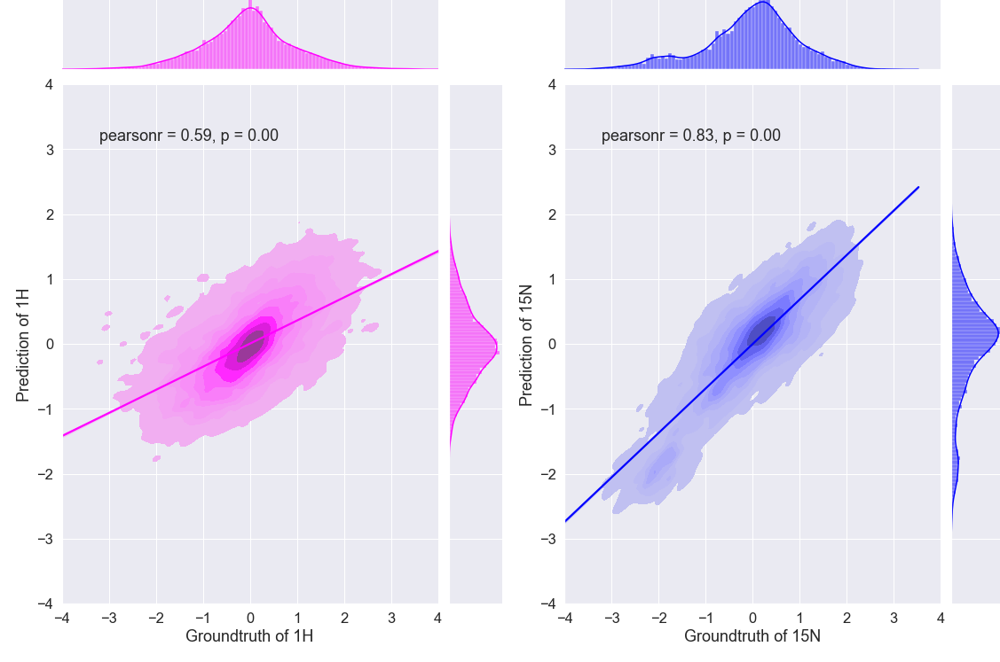

tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([[-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        ...,
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.],
        [-100., -100., -100.,  ..., -100., -100., -100.]])
tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+0

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,   -0.8102,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000,   -0.8102, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -5.8058e-02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,  5.4392e-02,
         5.4392e-02, -1.0000e+02, -3.2652e-02, -1.1661e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([[-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -5.8058e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -100.0000],
        [-100.0000, -100.0000,   -0.8102,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.8058e-02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([[-1.0000e+02, -1.0000e+02,  1.8349e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.5963e+00,  8.6857e-01,  7.2395e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-3.2015e-01, -1.1147e+00, -4.9986e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.0450e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[-100.0000, -100.0000,   -0.2366,  ..., -100.0000, -100.0000,
         -100.0000],
        [  -1.8219,    0.8876,   -0.1681,  ..., -100.0000, -100.0000,
         -100.0000],
        [  -0.6104,    1.0393,   -0.2379,  ..., -100.0000, -100.0000,
         -100.0000],
        ...,
        [-100.0000, -100.0000, -100.0000,  ..., -100.0000, -100.0000,
         -10

tensor([-1.0000e+02, -1.0000e+02, -3.4984e-02, -2.7495e-01, -2.3681e-01,
        -9.9905e-01,  9.6468e-01,  1.2232e+00, -7.8345e-01, -1.6151e+00,
         5.2886e-01, -1.0000e+02, -1.0000e+02,  1.7307e-01,  2.5619e-01,
        -6.4541e-01,  1.1402e+00, -4.9761e-01,  1.5777e+00,  8.5911e-01,
         7.9120e-02,  1.9851e+00, -6.3843e-01,  5.0530e-02,  6.8994e-01,
        -3.5554e-01, -1.1754e+00, -5.2722e-01, -1.8800e+00, -1.9832e+00,
        -1.6239e+00,  1.7223e-01, -1.0000e+02,  1.4239e+00, -1.0000e+02,
        -6.0191e-01,  8.4044e-01, -1.1460e-01, -1.5878e+00,  4.7500e-01,
        -2.5326e+00,  6.6072e-01, -4.3566e-02,  7.5801e-01,  5.7725e-01,
         5.8579e-01,  6.7910e-01, -1.7664e+00,  3.6699e-01,  1.9802e-01,
         1.1740e+00, -3.4353e-01, -1.0000e+02,  2.6293e-01, -1.3215e+00,
        -4.5803e-01,  9.6009e-01,  4.9522e-01,  7.6770e-01,  1.9265e-01,
        -1.3852e+00,  8.4008e-03, -9.5900e-01, -3.4624e-01,  5.0157e-01,
         8.6313e-01, -3.6053e-01,  3.6843e-01, -2.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         2.0905e-01, -1.7235e-01, -1.0000e+02, -1.5805e-01, -1.0000e+02,
         1.1847e-01, -1.5169e-01,  4.3154e-01,  2.4401e-01, -8.0181e-02,
        -1.0000e+02, -4.3139e-01,  6.5879e-01,  8.9876e-01, -3.8054e-01,
         5.0305e-01,  2.3481e+00,  9.6869e-01,  1.2071e+00, -1.0000e+02,
         7.7639e-01, -4.4728e-01, -7.3969e-01,  4.9034e-01,  2.1336e+00,
         4.0929e-01,  2.1526e+00,  8.5585e-01,  8.8287e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02,  4.7604e-01, -1.8189e-01,
         3.7419e-02, -1.0000e+02,  4.2187e-02, -1.2323e+00, -7.5877e-01,
        -1.8331e+00,  2.1859e-01,  1.2675e+00,  1.2325e+00,  4.4266e-01,
        -8.5888e-01, -1.1513e+00, -2.9949e-01,  1.2055e+00, -1.5120e+00,
        -1.0000e+02, -1.2006e+00, -2.5181e-01,  1.8412e+00,  7.7957e-01,
        -2.0158e+00,  2.3386e+00,  5.6980e-01, -1.7012e+00, -2.2162e-01,
        -5.7124e-01,  1.1403e+00,  8.0818e-01,  1.3

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  7.3825e-01,
        -2.4705e-01, -7.5559e-01,  3.7274e-01,  8.9717e-01, -4.0596e-01,
        -6.1256e-01,  1.1197e+00,  1.6123e+00, -4.5364e-01, -3.2651e-01,
        -1.0099e+00, -1.1991e-01, -1.0575e+00, -1.5169e-01,  2.0573e+00,
         3.4095e-01,  5.1577e-01, -2.7883e-01,  9.4485e-01,  8.6684e-02,
         7.2248e-03, -4.6953e-01, -1.5184e+00, -1.6614e+00, -2.9472e-01,
        -6.4434e-01,  3.8863e-01, -3.7418e-01,  5.1577e-01, -8.6683e-01,
         3.2506e-01,  6.7469e-01, -1.6759e-01, -6.6024e-01, -8.0326e-01,
        -1.0893e+00,  8.3360e-01, -1.0000e+02,  8.1771e-01, -3.5829e-01,
         1.9460e+00, -1.0000e+02, -5.1721e-01,  1.0879e+00,  1.6441e+00,
         4.8398e-01, -1.0000e+02,  3.5685e-01,  2.6612e+00, -1.0000e+02,
         2.9328e-01, -2.6467e+00, -1.7250e+00, -5.0132e-01,  1.0258e-01,
        -6.4434e-01,  4.9987e-01,  8.8128e-01,  7.8593e-01,  1.1847e-01,
         4.3631e-01, -5.1721e-01, -5.0132e-01,  2.4

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         3.7115e-01,  6.0476e-01,  4.5379e-01,  1.0099e-01,  5.2848e-01,
         3.0440e-01, -5.0449e-01, -2.9949e-01, -3.2333e-01,  2.1700e-01,
         3.3778e-01, -2.2321e-01,  9.1452e-02, -1.3103e-01,  3.4572e-01,
         3.2983e-01, -2.4546e-01,  2.6626e-01,  2.2177e-01,  3.5526e-01,
         1.6297e-01,  2.4719e-01, -1.0000e+02,  1.4866e-01,  2.7580e-01,
         1.3118e-01,  2.8215e-01,  1.6138e-01, -2.3274e-01,  3.4095e-01,
         3.3778e-01,  3.2506e-01,  2.4706e-02,  4.6809e-01,  5.0941e-01,
         4.8557e-01, -1.4852e-01,  6.9852e-01,  4.0929e-01, -1.5024e-02,
         2.5514e-01, -5.6343e-02, -8.4948e-02, -1.6123e-01, -4.0120e-01,
        -2.8678e-01, -3.0426e-01, -2.0414e-01, -1.8825e-01,  6.9203e-02,
        -2.6929e-01,  1.0403e-02, -2.2639e-01, -1.9142e-01, -2.5976e-01,
        -2.9154e-01, -1.1355e-01, -2.9313e-01,  6.2

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.1673e-01, -4.8701e-01,
        -1.2786e-01, -5.0132e-01, -1.0000e+02, -4.5682e-01, -1.2468e-01,
        -2.6453e-01, -4.6794e-01,  8.3506e-02, -1.3262e-01, -4.3139e-01,
         3.9340e-01, -7.7942e-01,  3.8704e-01,  5.5232e-01, -6.3322e-01,
         2.2018e-01,  2.0382e+00,  6.2383e-01,  8.9082e-01,  1.4884e+00,
         4.1247e-01, -7.4764e-01, -1.0702e+00,  1.6614e-01,  1.8332e+00,
         1.3118e-01,  1.7728e+00,  5.6980e-01,  5.7616e-01, -1.0000e+02,
         9.7186e-01, -8.0644e-01, -1.0000e+02,  5.1722e-02, -5.6329e-01,
        -2.6135e-01, -1.0000e+02, -2.6771e-01, -1.5200e+00, -1.0575e+00,
        -2.1255e+00, -9.6073e-02,  9.4962e-01,  8.7174e-01,  1.4072e-01,
        -1.1577e+00, -1.4707e+00, -6.7931e-01,  9.1465e-01, -1.8156e+00,
         1.0466e+00, -1.3897e+00, -6.2051e-01,  1.5472e+00,  4.6809e-01,
        -2.2319e+00,  2.0605e+00,  1.9316e-01, -2.0301e+00, -5.5217e-01,
        -8.8590e-01,  8.0500e-01,  4.9670e-01,  1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0084e-01, -1.0000e+02, -4.4887e-01,  9.6869e-01,  3.9976e-01,
         1.2786e+00,  7.2077e-01,  1.5424e+00,  1.9031e+00,  9.7504e-01,
        -5.6647e-01, -1.1116e+00, -4.6808e-02,  1.7267e+00,  7.8116e-01,
         1.3008e+00,  1.4072e-01,  3.9817e-01,  6.4926e-01, -1.3531e+00,
        -8.8749e-01, -7.5400e-01, -1.3865e+00, -1.0989e+00, -2.3103e-03,
        -1.3944e+00, -1.0000e+02,  5.7933e-01,  6.4436e-02, -8.6206e-01,
         3.7419e-02, -7.4764e-01, -5.5058e-01, -8.1757e-01, -3.0902e-01,
        -2.6929e-01,  1.9475e-01, -1.1038e-01,  2.7884e-02, -8.9716e-02,
         3.4413e-01,  2.2653e-01, -3.3127e-01, -1.0000e+02,  4.0611e-01,
        -1.0000e+02,  5.8251e-01, -1.0000e+02, -2.2224e+00, -1.4373e+00,
         1.5343e-01,  2.5102e+00,  1.3118e-01, -3.2333e-01,  1.1721e+00,
         2.4084e-01, -2.0889e+00,  5.9681e-01,  9.4644e-01,  1.9634e-01,
         6.6833e-01,  1.3914e+00,  4.1565e-01, -1.3

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -2.2970e-02, -3.7736e-01, -4.6318e-01,  1.3582e-02,
        -1.5805e-01, -2.4387e-01, -7.6830e-01,  8.8140e-03, -8.1915e-01,
        -4.5218e-02,  1.9316e-01, -6.7467e-02, -2.8360e-01,  8.8605e-01,
         4.8398e-01, -6.8566e-01,  2.3576e+00,  3.5049e-01,  8.9876e-01,
        -6.1110e-02,  1.7077e+00, -4.8542e-01, -1.0734e+00, -5.7601e-01,
        -3.2015e-01,  2.9010e-01, -1.0734e+00, -2.1652e+00, -2.3910e-01,
         6.4436e-02, -3.1061e-01, -7.5413e-02, -2.6453e-01, -4.8225e-01,
        -7.1904e-01, -8.9861e-01, -2.4069e-01,  2.5673e-01, -2.9472e-01,
        -2.3433e-01,  2.3607e-01, -9.6377e-01, -2.1367e-01, -1.1878e+00,
         2.3766e-01, -1.0000e+02,  8.0818e-01,  5.4901e-02, -8.9385e-01,
         7.0011e-01,  8.4791e-01, -1.0000e+02,  4.9987e-01,  1.2007e+00,
         8.8274e-02,  3.6479e-01,  4.1565e-01,  1.4693e+00,  1.1847e-01,
         1.8777e+00,  4.3776e-02, -6.4289e-02, -1.4

tensor([-1.0000e+02, -1.0000e+02,  3.4890e-01, -4.8397e-02,  1.4866e-01,
         2.0270e-01, -1.0000e+02, -8.6683e-01,  1.9158e+00, -1.1449e+00,
         1.0164e+00,  1.6171e+00,  7.7004e-01, -1.5565e+00,  7.4143e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.8984e+00,
        -1.8267e+00, -1.3245e+00,  7.9070e-01, -6.5706e-01, -1.1845e-02,
        -4.9973e-01, -1.2180e+00, -2.1763e+00,  1.0672e+00, -1.8617e+00,
        -1.0591e+00, -1.5867e+00, -2.2462e+00,  1.0783e+00, -4.1868e-01,
        -1.1845e-02,  2.2653e-01, -3.1379e-01,  2.1064e-01, -1.3261e+00,
        -5.2356e-01,  4.6968e-01,  5.1100e-01,  8.2725e-01,  7.2395e-01,
         1.0116e+00,  6.5720e-01, -1.0000e+02, -2.1381e-02, -1.3642e+00,
        -2.1143e+00, -2.2796e+00,  6.8581e-01,  1.5074e+00, -6.1415e-01,
         5.2848e-01,  1.1371e+00,  2.2494e-01,  5.4437e-01,  1.9158e+00,
         6.1906e-01, -5.3628e-01,  5.5073e-01,  1.3803e+00, -7.4764e-01,
        -1.1355e-01, -8.9716e-02,  1.3660e+00, -1.0

tensor([-1.0000e+02, -1.0000e+02,  2.0428e-01,  9.2260e-01,  4.1565e-01,
         1.5646e+00,  8.0023e-01, -2.4387e-01,  1.8634e+00, -1.0000e+02,
         2.3004e+00, -9.5106e-01, -7.1904e-01,  7.7798e-01, -2.6148e-02,
        -3.9802e-01,  9.9398e-02, -1.6282e-01, -8.2710e-01, -1.3435e-02,
         1.3104e+00,  1.0734e-01,  7.0647e-01, -1.0000e+02, -1.0000e+02,
        -1.0845e+00, -1.0000e+02,  1.0799e+00,  2.2177e-01, -2.4147e+00,
        -2.2176e+00, -5.0132e-01,  1.3898e+00,  1.4725e+00, -2.6294e-01,
         6.8422e-01, -2.8360e-01, -4.1073e-01,  1.4979e+00, -6.9202e-01,
        -9.3040e-01, -9.1610e-01,  7.1600e-01,  4.7604e-01, -1.4167e+00,
        -4.9814e-01,  7.3190e-01, -1.0000e+02, -1.8235e+00, -1.0861e+00,
        -1.0000e+02, -6.6182e-01,  1.2325e+00,  2.6453e+00, -1.3435e-02,
         2.0779e+00, -5.7601e-01,  2.6071e+00, -6.6341e-01,  5.9523e-01,
        -8.1439e-01, -1.0000e+02,  2.1717e+00, -3.1379e-01,  2.0350e+00,
         2.5340e+00,  9.9252e-01,  1.8698e+00,  1.8

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -4.0438e-01, -7.7002e-02,  4.7604e-01,  5.7298e-01,
        -5.0449e-01, -2.6453e-01,  2.5991e-01, -9.7490e-01, -1.8076e+00,
        -1.6122e+00, -9.8761e-01, -1.0448e+00, -6.4434e-01, -8.0644e-01,
        -1.3898e-01,  3.4526e+00, -2.5181e-01,  2.8153e+00,  3.1394e-01,
         1.8809e+00, -1.4534e-01, -8.9385e-01,  5.9046e-01,  8.7016e-01,
        -1.8983e-01, -1.2323e+00,  1.4709e+00, -1.6996e+00, -1.0750e+00,
        -7.0791e-01,  1.2675e+00,  4.6491e-01, -1.9078e+00, -7.8896e-01,
         4.0611e-01, -1.4898e+00,  7.3971e-02,  1.0466e+00,  5.7616e-01,
        -8.5730e-01,  1.6760e-02, -6.5878e-02, -4.6794e-01, -2.0573e-01,
         6.1112e-01, -6.5547e-01, -8.7954e-01, -9.8443e-01, -2.9790e-01,
        -5.6012e-01, -1.0989e+00, -1.3817e+00,  3.6638e-01, -3.7273e-02,
        -2.6453e-01, -6.7613e-01,  3.9009e-02,  3.0362e+00, -3.4399e-01,
         1.8300e+00,  2.5579e+00, -1.0671e+00,  2.1

tensor([-1.0000e+02, -1.0003e+00,  2.3130e-01,  2.9010e-01,  8.5426e-01,
         7.9229e-01,  1.3835e+00, -2.0794e+00, -1.3611e+00,  1.3501e+00,
         1.1069e+00,  1.6695e+00, -2.7088e-01, -1.0480e+00, -1.2689e+00,
        -1.0000e+02,  5.9999e-01,  1.3882e+00, -1.2149e+00, -8.8272e-01,
        -1.0000e+02, -2.2018e+00, -6.2209e-01,  6.8104e-01, -5.4264e-01,
        -5.3310e-01,  1.2643e+00, -5.8395e-01, -8.8272e-01, -7.4287e-01,
        -8.6683e-01, -3.0916e-02,  3.6797e-01, -5.9667e-01,  1.6282e+00,
        -4.4887e-01, -6.4752e-01, -1.3944e+00,  1.0211e+00,  2.1193e+00,
         1.6409e+00, -1.7394e-01,  1.1673e+00,  1.3708e+00, -1.9301e-01,
         1.5171e-02, -7.9373e-01, -8.8590e-01, -5.7919e-01,  3.9499e-01,
        -4.3298e-01,  1.7092e+00, -6.4289e-02,  7.6050e-01,  1.8729e+00,
        -7.3016e-01,  1.4868e+00,  6.7614e-02, -1.4755e+00,  2.2464e+00,
        -7.8260e-01,  1.7442e+00, -7.5413e-02, -1.3356e+00, -2.5148e+00,
        -3.2015e-01, -4.7748e-01, -1.2180e+00, -4.3

tensor([-100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000,    1.2826, -100.0000, -100.0000, -100.0000,
        -100.0000,   -1.0655,   -1.7777,    1.3403, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-1.0000e+02,  3.5049e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -8.8127e-02,  6.4290e-01,  3.7115e-01,  9.1783e-01,  8.0182e-01,
         2.9010e-01, -4.3139e-01,  5.0782e-01, -3.9325e-01,  1.8349e-02,
        -9.6073e-02,  5.6490e-02,  7.6209e-01, -2.8519e-01, -7.1586e-01,
        -1.6138e+00, -2.3988e+00,  3.6797e-01,  5.4755e-01, -1.0000e+02,
         3.6479e-01, -1.3563e+00, -2.6453e-01,  5.0941e-01, -1.0000e+02,
        -6.1892e-01, -1.0000e+02,  4.0293e-01, -2.7247e-01,  3.5208e-01,
         4.3631e-01, -3.3922e-01, -1.2244e+00, -5.0449e-01, -7.6512e-01,
        -2.1747e+00, -5.4264e-01, -7.9214e-01, -2.2970e-02,  9.2101e-01,
         2.4719e-01, -1.1036e+00,  4.3948e-01,  1.0752e+00, -2.3274e-01,
        -1.0242e+00, -1.0687e+00, -8.6365e-01,  6.3813e-01, -1.0000e+02,
         2.8948e+00,  9.7809e-02,  2.7103e-01,  1.5472e+00, -1.6694e+00,
        -4.8225e-01,  2.1193e+00, -1.0000e+02, -5.4

tensor([ 3.9009e-02, -8.6671e-03,  1.9793e-01,  3.8863e-01,  2.3117e-02,
        -2.1526e-01,  1.6614e-01, -2.7883e-01,  1.0258e-01,  3.9009e-02,
         3.8863e-01,  2.3117e-02, -1.5169e-01,  2.2971e-01, -1.0000e+02,
         4.8398e-01, -8.6671e-03,  1.7394e+00,  7.7004e-01, -2.3115e-01,
         1.7077e+00, -1.2959e+00, -3.7433e+00,  2.7739e-01,  2.3117e-02,
         1.9793e-01,  8.8128e-01, -1.0000e+02,  3.4095e-01, -1.3580e-01,
         1.5805e+00,  7.0647e-01,  1.1038e+00, -8.8127e-02,  2.2971e-01,
        -9.6218e-01, -1.2641e+00, -2.1526e-01, -1.8680e+00, -3.7418e-01,
         3.9325e+00,  9.4485e-01,  1.1356e+00,  4.9987e-01, -4.6953e-01,
         8.0182e-01,  7.2236e-01,  2.9328e-01,  3.7274e-01,  9.1306e-01,
         9.2896e-01,  1.9619e+00,  1.0258e-01,  2.0414e+00, -2.7580e+00,
        -1.0575e+00,  2.4560e-01, -1.8521e+00, -1.8680e+00,  5.1577e-01,
        -1.3754e+00,  6.4290e-01, -1.0000e+02,  1.3421e+00,  1.6614e-01,
        -5.0132e-01, -5.4899e-01,  1.0084e+00, -2.6

tensor([-1.0000e+02,  5.2371e-01,  2.0428e-01,  5.2848e-01,  1.1992e-02,
         1.0497e+00,  9.1783e-01,  6.9217e-01, -6.4593e-01,  1.7727e-01,
         1.2166e+00, -1.0845e+00,  4.8239e-01,  2.1064e-01, -1.5009e+00,
         6.7614e-02,  2.3289e-01, -2.2003e-01,  1.0575e-01, -1.0000e+02,
        -2.5022e-01, -1.5661e+00, -5.6965e-01, -7.6353e-01,  5.3325e-01,
        -8.1280e-01,  8.6221e-01, -1.0000e+02,  1.3135e+00, -2.4004e+00,
        -7.2062e-01,  5.8887e-01, -1.0989e+00, -5.6488e-01,  2.5037e-01,
         1.1052e-01, -1.0766e+00, -6.5878e-02, -9.1768e-01, -1.1163e+00,
        -1.2228e+00, -2.2970e-02, -1.0000e+02, -2.9709e+00, -1.7965e+00,
        -1.0000e+02,  4.2677e-01, -3.0916e-02,  3.9022e-01, -3.4399e-01,
         4.8557e-01, -2.6148e-02,  1.0990e+00, -1.0561e-01,  1.3436e-01,
         1.3231e+00,  1.2452e+00, -1.3182e+00, -1.0000e+02, -1.3531e+00,
        -6.9997e-01, -5.1721e-01,  5.9840e-01, -3.6941e-01, -2.2798e-01,
         8.9558e-01,  1.0942e+00,  7.2872e-01, -4.4

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  2.7041e+00,  2.9964e-01, -2.9949e-01, -4.9178e-01,
         6.2065e-01,  1.6455e-01,  1.8349e-02,  6.1430e-01,  4.6955e-02,
        -5.0132e-01,  3.3460e-01, -9.8125e-01,  1.2357e+00,  1.1149e+00,
        -6.9679e-01, -7.5082e-01,  8.5095e-02, -1.1735e+00, -6.0461e-01,
         2.4573e-03, -9.8284e-01, -4.0596e-01,  4.2187e-02, -7.6035e-01,
        -7.1904e-01,  9.7186e-01,  5.5867e-01, -9.9238e-01,  5.7139e-01,
        -1.4612e+00,  2.0811e+00,  1.4105e+00,  1.7394e+00, -3.7577e-01,
        -1.1196e-01,  6.6515e-01,  6.2847e-02,  2.1161e+00, -1.0000e+02,
         8.9399e-01, -4.5364e-01, -7.6194e-01, -4.6318e-01,  1.8872e+00,
         4.4584e-01,  1.6455e-01,  3.6161e-01,  2.2494e-01,  7.7163e-01,
        -7.3824e-02, -1.1402e+00,  2.8057e-01,  4.3313e-01, -1.0210e+00,
        -1.4548e+00, -1.0000e+02,  1.1578e+00,  1.4820e+00, -2.3940e+00,
        -1.5120e+00, -2.1367e-01, -9.8761e-01, -1.8

tensor([-2.2798e-01, -7.6194e-01, -1.0000e+02, -6.1733e-01,  1.6648e+00,
        -1.6455e+00, -1.4278e+00,  1.5090e+00,  3.2665e-01, -6.0779e-01,
        -7.3175e-01,  8.2089e-01, -1.5011e-01, -5.1562e-01,  4.4266e-01,
         4.5379e-01, -1.0925e+00, -1.8331e+00, -9.7331e-01, -2.3433e-01,
        -1.0130e+00,  1.1467e+00,  1.2055e+00,  7.8738e-02, -1.8030e-01,
        -1.7394e-01,  4.2200e-01, -1.6613e-02,  4.2836e-01, -1.1561e+00,
        -1.2228e+00,  1.7568e-01, -2.7724e-01, -1.0321e+00, -8.3664e-01,
        -9.0179e-01, -6.7467e-02, -1.6662e+00,  1.0799e+00,  4.5379e-01,
         8.5585e-01,  5.5232e-01,  4.7604e-01,  1.2992e+00,  6.8263e-01,
        -2.4401e+00, -7.3334e-01, -1.0000e+02, -1.0720e-01, -4.0914e-01,
        -1.1497e+00, -1.5184e+00, -6.9679e-01, -1.0000e+02, -7.9691e-01,
        -1.0000e+02, -2.8104e+00, -1.2800e+00,  1.1052e-01, -4.8397e-02,
         3.8704e-01, -1.0019e+00, -5.9985e-01,  5.1577e-01, -1.0000e+02,
        -3.2141e+00, -4.4411e-01, -2.5022e-01,  9.1

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  5.9046e-01,  2.2335e-01,  1.9316e-01, -3.8848e-01,
        -5.2198e-01, -6.9202e-01, -9.3040e-01, -2.3274e-01,  4.1406e-01,
        -7.2380e-01,  1.6297e-01,  8.8446e-01,  6.6197e-01, -1.9619e-01,
         4.3790e-01,  2.0746e-01, -3.2015e-01, -1.0000e+02,  7.6686e-01,
        -1.7568e+00, -6.7613e-01, -7.0314e-01, -1.0000e+02,  4.7445e-01,
         1.5171e-02,  3.0599e-01, -1.0000e+02,  3.9181e-01, -7.8737e-01,
         9.0671e-01, -2.7088e-01,  3.1712e-01, -3.8848e-01, -1.7536e+00,
        -8.8590e-01, -3.0585e-01, -1.1656e+00, -6.9056e-02, -4.6794e-01,
         8.8287e-01, -1.1513e+00, -7.2235e-02,  8.6062e-01,  9.7809e-02,
        -3.5829e-01, -4.3616e-01, -1.3579e+00, -5.2039e-01, -1.0000e+02,
         6.1747e-01,  1.0434e+00, -3.5193e-01, -5.1721e-01, -1.0000e+02,
         6.5720e-01,  9.3531e-01,  6.9376e-01, -1.0000e+02,  5.5391e-01,
        -6.5706e-01, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  3.3778e-01,
         1.1370e-01,  2.9328e-01,  2.0270e-01,  2.8533e-01,  4.7286e-01,
        -1.8030e-01,  1.8363e-01,  2.4719e-01, -1.0000e+02,  4.0293e-01,
         9.3041e-02,  3.1871e-01,  3.7115e-01,  4.2359e-01,  4.8875e-01,
         3.1553e-01,  5.2212e-01,  5.6821e-01,  8.1917e-02, -4.9986e-02,
        -1.1673e-01,  1.2959e-01,  8.1917e-02,  1.0099e-01, -3.6624e-01,
         2.5832e-01, -1.0000e+02, -1.0000e+02,  2.4719e-01,  2.4243e-01,
        -2.8836e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  7.5589e-01,  3.0774e-01,
        -3.5654e-01,  9.7968e-02, -1.0000e+02,  1.1863e-01,  5.6045e+00,
        -9.1911e-01, -1.0000e+02,  4.8096e-01, -1.0701e+00, -1.0000e+02,
         2.0876e+00, -1.0000e+02, -1.3927e+00,  2.5342e+00, -1.0000e+02,
        -1.5850e+00,  3.1222e-02,  8.7349e-01, -3.5495e-01,  6.6184e-02,
         1.0753e+00, -3.2476e-01, -1.8491e-01, -1.0415e+00, -2.4066e+00,
        -1.0000e+02,  1.2406e+00, -9.9699e-01, -1.0000e+02,  3.0411e+00,
        -6.5849e-01, -1.5691e+00, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  5.2069e-01,  1.0270e-03,  8.5442e-01,  4.7143e-01,
         1.9271e+00,  1.5235e+00, -1.2671e+00,  1.1611e+00,  1.2787e+00,
        -2.8662e-01, -1.2497e+00,  1.3153e+00,  6.1763e-01, -1.2513e+00,
        -5.5996e-01,  1.4647e+00, -6.9186e-01, -1.0733e+00,  4.7778e-01,
         2.5212e-01, -1.0335e+00,  1.2181e-01,  6.8597e-01, -1.2703e+00,
        -1.0304e+00, -1.2179e+00, -1.0000e+02,  9.5

tensor([-1.0000e+02, -1.0000e+02,  3.3937e-01,  2.9328e-01, -1.1845e-02,
         2.3289e-01,  5.1100e-01,  3.0123e-01, -1.6613e-02, -3.1538e-01,
        -1.3960e+00, -2.0587e+00, -1.2101e+00, -6.7613e-01, -1.0369e+00,
        -1.7695e+00,  5.6344e-01,  1.1324e+00,  2.9646e-01, -1.0448e+00,
         5.6821e-01, -1.0480e+00,  1.2388e+00,  1.0783e+00,  1.3231e+00,
         2.6453e+00, -4.0596e-01,  8.6684e-02, -1.9427e+00, -1.0000e+02,
         6.8899e-01, -1.6503e+00,  6.7786e-01, -1.4898e+00, -5.1085e-01,
        -6.9202e-01, -7.9373e-01,  8.5903e-01, -1.0000e+02,  1.4677e+00,
        -1.2959e+00, -1.3499e+00,  8.5426e-01, -4.0596e-01, -1.4660e+00,
         1.6138e-01, -1.0000e+02, -2.6006e+00, -8.5253e-01,  9.2101e-01,
         1.6123e+00,  1.2643e+00,  7.7798e-01,  1.5408e+00,  3.7433e-01,
        -1.3054e+00,  9.7822e-01,  1.7140e+00,  7.1759e-01, -1.7871e-01,
         5.9205e-01,  8.5109e-01, -6.3799e-01, -1.5169e-01,  5.3166e-01,
        -1.0000e+02, -1.7870e+00, -2.9646e+00,  1.4

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  9.1688e-01,  3.3948e-01,
        -2.6212e-02,  1.6483e+00,  1.3403e+00,  6.0893e-01,  2.6249e-01,
        -2.3936e+00,  1.2441e+00,  5.0776e-02,  1.3018e+00,  1.2633e+00,
        -1.0000e+02, -1.1618e+00, -1.0078e+00, -7.3834e-01, -3.3416e-01,
         1.5905e+00,  9.3613e-01,  1.0324e+00, -8.7307e-01,  9.7462e-01,
         4.5496e-01, -1.0000e+02,  6.6667e-01,  6.8592e-01,  1.4701e-01,
        -1.9316e+00, -1.0000e+02, -4.3040e-01,  4.7421e-01, -1.2245e-01,
        -1.2245e-01,  2.4324e-01,  8.9269e-02, -1.9943e-01,  1.4701e-01,
         3.5872e-01, -1.1810e+00, -3.2019e+00,  3.2023e-01, -1.0000e+02,
        -1.4890e+00,  8.9269e-02,  5.8969e-01,  1.3981e+00, -3.3416e-01,
         3.1529e-02, -3.7265e-01, -2.3793e-01, -4.5459e-02,  1.2776e-01,
        -1.0000e+02, -9.6931e-01, -5.0738e-01,  1.0852e-01, -2.2588e+00,
        -1.6622e+00,  5.0776e-02, -4.8814e-01,  8.5914e-01,  5.1270e-01,
         4.7421e-01,  6.4743e-01, -5.4588e-01, -6.2

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -5.8237e-01, -7.8101e-01, -6.7136e-01, -1.0000e+02, -1.9411e+00,
         1.3008e+00,  6.6833e-01, -6.9838e-01,  9.8617e-01,  4.8239e-01,
        -1.0973e+00,  1.9667e+00, -1.0000e+02, -9.0974e-01, -2.8995e-01,
        -2.9313e-01,  1.7013e+00,  1.1912e+00,  2.4706e-02, -1.0000e+02,
         2.2018e-01,  6.0953e-01,  1.6409e+00,  7.7957e-01,  4.8544e-02,
         2.4573e-03,  1.1181e+00,  9.4962e-01,  1.5376e+00,  1.2150e+00,
        -1.0000e+02,  3.0599e-01, -1.7902e+00, -7.0473e-01, -1.8680e+00,
        -5.1575e-02,  4.7286e-01,  7.6527e-01,  9.3372e-01,  1.8841e+00,
         1.6854e+00,  5.4278e-01,  1.2166e+00, -3.3127e-01,  9.4644e-01,
         4.4107e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -4.1215e+00,
        -5.1244e-01, -8.0962e-01, -9.0497e-01, -1.6090e+00,  5.2053e-01,
        -1.5836e+00, -8.0644e-01, -1.4469e+00, -3.3746e+00, -1.0000e+02,
         1.4597e+00, -1.9459e+00, -2.6865e+00, -2.3

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -6.7613e-01, -8.5094e-01,
         6.5879e-01, -1.0000e+02,  1.4852e+00, -2.4705e-01, -8.9861e-01,
         6.5879e-01, -6.9202e-01, -6.2845e-01, -5.8078e-01, -2.4559e-02,
        -6.9202e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         5.9523e-01,  5.9523e-01, -2.1526e-01,  1.0720e+00,  2.0255e+00,
         1.9778e+00, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         9.9252e-01, -3.1061e-01,  3.0917e-01, -1.0000e+02,  4.3631e-01,
        -9.3040e-01, -5.4899e-01, -9.1451e-01, -6.2845e-01,  2.1382e-01,
        -3.2651e-01, -3.4240e-01,  2.9328e-01, -5.8078e-01, -2.1223e+00,
         1.5025e-01,  1.1847e-01, -1.7727e+00, -5.4899e-01, -7.7148e-01,
         1.6282e+00, -9.9397e-01,  7.0647e-01,  5.7

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.4390e-01,
         4.7604e-01,  9.3041e-02, -2.5340e-01, -2.5499e-01, -1.1991e-01,
         3.9009e-02,  1.7568e-01,  3.1076e-01,  1.0575e-01,  1.7727e-01,
         1.8521e-01,  1.9475e-01,  2.2335e-01,  2.2653e-01,  2.3607e-01,
         2.4401e-01,  2.5673e-01,  2.7580e-01,  2.8851e-01,  2.9646e-01,
         3.1076e-01,  2.7421e-01,  2.5037e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -2.8519e-01,  3.9009e-02,  3.1063e-02,
         1.5171e-02, -1.0000e+02,  1.0258e-01,  6.6025e-02,  5.8079e-02,
         2.6626e-01,  2.0587e-01,  2.9474e-02, -7.0646e-02,  5.8887e-01,
        -1.0000e+02, -1.0000e+02, -2.4705e-01,  2.6246e+00,  5.1722e-02,
         9.9398e-02, -1.0000e+02,  1.1816e+00,  3.2030e-01, -1.4644e+00,
        -1.2705e+00, -1.4914e+00,  2.7262e-01,  1.5726e+00, -7.2235e-02,
         3.2506e-01,  1.1069e+00, -6.4434e-01,  1.5567e+00, -2.9313e-01,
         4.0134e-01,  7.4938e-01,  2.2177e-01,  1.7490e+00,  8.8274e-02,
         1.6568e+00, -1.0000e+02, -1.2451e+00,  1.3135e+00,  8.8923e-01,
         7.4938e-01, -1.0000e+02, -1.1038e-01, -1.0000e+02,  7.5414e-01,
         5.7139e-01,  8.3519e-01,  1.0799e+00,  2.0605e+00,  1.3819e+00,
         1.6997e+00,  2.3116e+00, -6.6024e-01, -1.0000e+02,  3.5844e-01,
         8.5585e-01, -1.5805e-01,  3.4890e-01, -1.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  6.4290e-01,  1.8507e+00,
        -5.1721e-01,  9.1306e-01,  5.1577e-01,  1.1832e+00,  4.6794e+00,
         9.2896e-01,  1.1847e-01, -5.9667e-01,  2.7739e-01,  5.6344e-01,
         2.7739e-01,  7.2248e-03, -2.1526e-01, -8.6683e-01, -1.1991e-01,
         5.3166e-01,  1.3580e+00, -2.0269e+00,  8.4950e-01, -5.3310e-01,
         1.8348e+00, -9.3040e-01,  5.4901e-02, -4.5364e-01, -1.2641e+00,
        -2.0905e+00, -1.0893e+00, -2.4560e+00,  1.4216e+00,  3.7274e-01,
         1.2627e+00,  1.9793e-01, -2.4559e-02,  1.4693e+00,  2.9631e+00,
         1.3739e+00,  5.3166e-01,  4.2041e-01,  1.2309e+00,  3.9961e+00,
        -1.9316e+00, -1.6759e-01,  4.5220e-01,  8.1771e-01, -1.0000e+02,
        -2.7421e+00,  1.9793e-01,  1.1673e+00,  1.1673e+00,  1.1991e+00,
         2.7406e+00, -7.8737e-01, -2.4705e-01,  4.2041e-01,  2.2971e-01,
         4.3631e-01, -1.2800e+00,  1.2150e+00, -2.6294e-01, -7.5559e-01,
        -2.2812e+00,  3.5511e+00,  1.3898e+00, -6.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  4.4743e-01, -5.9031e-01,  1.8380e+00,  1.1944e+00,
         1.1149e+00,  1.9540e+00,  1.0545e+00, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.3420e+00, -7.9055e-01, -8.9716e-02, -1.0000e+02,
         1.7967e+00, -7.9055e-01, -6.9997e-01, -1.0256e-02, -1.2927e+00,
        -1.7218e+00, -6.1097e-01,  7.2382e-02, -1.1974e+00,  3.4254e-01,
         3.2188e-01,  8.3201e-01, -1.6918e-01, -2.0444e+00, -1.0000e+02,
         5.3801e-01,  7.8593e-01,  8.4314e-01,  1.7537e+00,  9.7981e-01,
        -1.6932e+00,  1.1992e-02, -8.7954e-01,  1.8363e-01, -5.8713e-01,
         9.2896e-01,  1.8189e+00,  9.0035e-01, -3.3763e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.1355e-01, -2.5387e+00, -5.0767e-01,
        -1.0000e+02,  1.0513e+00, -1.6918e-01,  1.3436e-01, -4.6476e-01,
         1.5502e-01,  1.1467e+00,  9.6551e-01,  9.8299e-01, -5.5217e-01,
         2.0191e+00,  1.9810e+00, -3.8531e-01,  1.5

tensor([-1.0000e+02,  6.7469e-01, -5.1721e-01, -8.8127e-02,  1.5170e+00,
         4.0452e-01, -1.0000e+02, -2.4705e-01, -2.2335e+00, -1.4072e+00,
        -2.4559e-02,  1.1847e-01,  5.4755e-01, -4.5364e-01, -5.6343e-02,
         2.3117e-02, -5.3310e-01,  8.6684e-02, -1.3436e+00, -1.0416e+00,
         1.5805e+00, -8.1915e-01,  1.5025e-01,  2.3117e-02, -6.1256e-01,
         7.0647e-01,  4.3631e-01, -3.1061e-01,  1.1847e-01,  8.4950e-01,
        -8.5094e-01, -9.6218e-01, -1.0416e+00, -8.8272e-01, -4.3775e-01,
         3.0917e-01,  8.1771e-01,  2.1382e-01, -8.3505e-01, -8.5094e-01,
        -9.7807e-01, -3.7418e-01, -1.3580e-01,  3.0917e-01, -2.3115e-01,
         2.9328e-01, -1.0000e+02,  4.9987e-01, -6.4434e-01,  5.4901e-02,
         1.5025e-01,  2.9328e-01, -1.0000e+02,  2.6150e-01, -1.1529e+00,
        -1.5979e+00, -5.9667e-01,  2.1382e-01, -4.2186e-01, -2.4705e-01,
         7.0647e-01,  6.9058e-01, -1.8348e-01, -5.4899e-01, -1.4072e+00,
         1.9793e-01,  4.0452e-01, -1.6773e+00, -1.7

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -8.8127e-02,  3.2188e-01, -1.1845e-02, -2.5976e-01,
         7.3971e-02,  1.5184e-01, -1.0000e+02,  2.6308e-01, -1.9460e-01,
        -1.1673e-01,  2.2177e-01, -9.4947e-01, -2.0238e+00,  6.5085e-01,
         1.0752e+00,  1.6584e+00,  6.9376e-01, -7.8591e-02, -1.0178e+00,
        -9.8443e-01, -8.5730e-01,  1.9619e+00,  1.3708e+00,  9.2737e-01,
         1.3930e+00,  1.2929e+00, -7.7942e-01,  6.4131e-01,  4.6650e-01,
         7.1441e-01, -1.1704e+00,  6.0794e-01,  6.3654e-01,  2.4719e-01,
        -1.8744e+00,  5.6344e-01,  4.8239e-01, -1.0401e+00,  1.3277e-01,
        -4.2040e-02, -2.2955e+00, -9.9397e-01, -6.9202e-01, -1.0099e+00,
        -2.0110e+00, -9.1927e-01,  1.2802e+00, -3.5352e-01, -1.2371e+00,
         1.3072e+00,  6.8422e-01,  7.7004e-01,  1.1022e+00, -2.2003e-01,
        -5.9508e-01, -6.0144e-01, -5.6171e-01, -7.3

tensor([-1.0000e+02, -6.2845e-01,  1.7108e+00,  4.4425e-01,  6.2847e-02,
         8.8274e-02, -1.6424e+00, -8.9385e-01,  1.0752e+00,  1.0942e+00,
        -1.0766e+00, -8.9716e-02, -1.2578e+00, -6.7295e-01,  1.0895e+00,
         2.2653e-01, -4.4887e-01, -1.5487e-01,  7.3971e-02, -1.4977e+00,
        -4.6953e-01, -1.5486e+00, -5.4264e-01, -1.1942e+00,  7.2554e-01,
        -6.5229e-01,  7.6686e-01,  1.3406e+00,  1.0624e+00, -1.8998e+00,
        -1.2133e+00, -9.5741e-01, -5.5694e-01, -7.8737e-01,  2.3289e-01,
        -1.2468e-01, -4.1709e-01,  4.0611e-01, -1.0702e+00, -2.3433e-01,
        -7.7625e-01,  1.8998e-01, -1.0000e+02, -2.5228e+00, -1.4564e+00,
        -1.0000e+02, -2.6563e+00, -7.6353e-01, -1.4850e+00, -9.7807e-01,
         2.8916e+00, -1.6646e+00,  9.0512e-01, -1.7394e-01,  1.5901e+00,
         1.0974e+00,  1.6266e+00, -9.3834e-01, -6.4752e-01, -1.0782e+00,
         1.8349e-02, -6.1097e-01,  4.1724e-01,  7.0792e-02,  2.7884e-02,
         1.1149e+00,  1.4709e+00,  9.3849e-01, -4.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  1.5661e-01, -3.4081e-01,  2.1495e+00,  8.3837e-01,
        -1.0000e+02,  5.8092e-01,  1.5027e+00,  8.9558e-01, -1.2959e+00,
         9.1306e-01, -1.0000e+02,  4.3948e-01,  3.7274e-01, -2.2162e-01,
         3.2347e-01,  5.2212e-01,  3.5049e-01, -2.0732e-01,  2.0557e+00,
        -2.2480e-01,  1.4231e-01,  1.2865e+00, -2.6929e-01,  1.4137e+00,
         2.2494e-01,  1.3040e+00, -3.9166e-01,  1.0640e+00,  8.5109e-01,
         4.6955e-02, -7.3016e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         9.3690e-01,  5.9668e-02,  6.4767e-01,  1.9301e+00,  1.7855e+00,
         1.1165e+00,  2.3735e+00,  7.9864e-01, -1.4693e-01,  1.0386e+00,
         3.8227e-01,  8.5095e-02,  4.9193e-01, -5.4754e-02,  2.2177e-01,
         4.1565e-01, -7.2062e-01, -2.2399e+00,  1.2118e+00,  8.9863e-02,
         1.2230e+00,  7.2248e-03, -2.0891e-01,  6.1

tensor([-1.0000e+02,  3.6161e-01,  1.2516e+00,  6.7310e-01, -1.9109e+00,
        -8.3346e-01,  1.9938e-02, -5.1880e-01, -5.0132e-01,  4.4266e-01,
         4.8875e-01,  7.5891e-01, -5.9521e-02, -2.0255e-01,  2.7103e-01,
         2.3448e-01,  2.9328e-01,  8.5903e-01, -1.4693e-01,  5.1722e-02,
        -3.8995e-03,  3.4890e-01,  2.9010e-01,  4.0293e-01,  8.3519e-01,
         3.3937e-01, -1.1847e+00, -1.2101e+00, -8.2074e-01, -1.0000e+02,
        -6.2209e-01, -8.5888e-01, -4.7748e-01, -9.4311e-01, -6.5878e-02,
        -2.8360e-01,  4.0452e-01, -1.6759e-01, -7.6194e-01, -5.6488e-01,
        -4.0755e-01, -2.3274e-01,  8.6807e-04, -4.2980e-01, -2.3751e-01,
        -2.4228e-01, -1.0561e-01, -2.4228e-01, -4.1232e-01, -5.1403e-01,
        -5.2833e-01, -4.6159e-01, -8.7954e-01, -8.1915e-01, -6.3163e-01,
        -6.4593e-01, -1.9301e-01, -8.8590e-01, -9.8284e-01, -5.8713e-01,
         8.1917e-02,  2.6626e-01,  2.3448e-01, -1.5805e-01, -4.6635e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -8.8127e-02,  7.2248e-03,
        -1.0000e+02,  7.0792e-02, -5.6343e-02,  1.3436e-01,  2.9328e-01,
         8.6684e-02, -1.0000e+02,  2.1382e-01, -5.0132e-01, -1.6759e-01,
         1.0258e-01, -2.6294e-01, -8.8127e-02, -1.5169e-01, -7.2235e-02,
        -8.8127e-02, -1.6759e-01, -1.0402e-01,  7.2248e-03,  3.5685e-01,
        -2.4705e-01,  3.9009e-02,  2.9328e-01, -1.6759e-01,  8.6684e-02,
        -1.0000e+02,  1.9793e-01, -1.0000e+02,  2.2971e-01,  1.0258e-01,
        -2.1526e-01,  2.1382e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.6759e-01,  2.3117e-02, -1.1991e-01, -4.3775e-01,
        -3.4240e-01, -5.0132e-01, -2.1526e-01, -3.4240e-01,  2.1382e-01,
        -4.8542e-01, -1.0000e+02, -1.0402e-01, -3.2651e-01, -1.5169e-01,
        -1.0000e+02,  2.9328e-01, -1.6759e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.6466e+00, -7.1294e-01,
        -2.9798e-01, -1.7157e+00,  2.0340e-01,  1.3244e-02,  9.9868e-01,
         2.0340e-01,  3.5892e-01,  1.1888e+00, -8.8597e-01, -4.3636e-01,
         7.7388e-01,  1.4136e+00, -1.0000e+02,  1.6211e+00, -1.2909e+00,
        -4.5368e-01,  1.1698e-01, -5.2278e-01,  1.8631e+00,  6.3569e-01,
         8.2340e-02,  3.0374e-02,  5.3195e-01, -2.2888e-01, -1.7691e-01,
        -1.7503e+00, -1.0000e+02, -1.9251e+00, -2.1031e+00, -3.8722e-02,
        -1.0782e-01, -7.3367e-02,  1.6876e-01,  2.5518e-01, -3.8722e-02,
         8.0852e-01, -8.4401e-01,  5.5677e-01,  1.4654e+00,  3.9356e-01,
         1.2235e+00,  6.3569e-01, -1.3527e+00,  6.8746e-01,  2.4507e+00,
        -4.0172e-01, -2.0442e+00,  1.4827e+00,  8.4298e-01, -6.7849e-01,
         8.6030e-01,  1.6055e+00,  1.0851e+00, -1.0000e+02, -2.4620e-01,
         2.0340e-01, -6.0920e-01,  1.1698e-01,  3.4160e-01, -5.6044e-02,
        -8.6865e-01, -9.5506e-01, -5.6044e-02,  1.3

tensor([-1.0000e+02, -1.7759e+00,  8.5997e-02,  9.0630e-01, -1.1013e+00,
         6.6956e-01,  1.2010e+00,  8.5837e-01, -5.1373e-01,  5.6640e-01,
         1.2903e+00,  2.6634e-01,  2.3598e+00,  6.2760e-01,  3.1619e-01,
        -1.0000e+02, -3.4071e-01,  2.2650e-01,  1.1891e-01,  1.8185e-01,
         3.6334e-01, -7.7023e-02, -3.4205e-01, -2.2825e+00,  5.3663e-02,
         1.1752e+00,  4.1152e-02, -1.2740e+00,  3.7547e-01, -6.3114e-01,
        -1.0000e+02, -1.1069e+00, -1.9877e+00, -5.6177e-03, -9.4852e-01,
        -9.2947e-01, -1.9866e-01, -3.2435e-01, -9.1253e-01, -2.2742e+00,
        -1.4086e-02,  1.3678e+00,  8.7839e-01,  1.7701e+00, -4.9295e-01,
        -1.6608e+00, -9.9356e-01,  8.0416e-02, -1.9659e+00,  1.1386e+00,
        -1.7313e+00, -2.3966e-01,  1.1933e+00,  2.0998e+00, -1.2582e+00,
        -3.4398e-01, -1.8327e-01,  1.0610e+00,  1.8573e+00,  1.7895e+00,
        -2.0610e+00, -3.4873e-02, -1.6762e+00,  5.7910e-01,  7.6483e-01,
         1.0920e+00,  9.0861e-01,  1.8906e+00,  2.4

tensor([-1.0000e+02,  3.3301e-01,  4.5697e-01, -2.2639e-01,  2.9474e-02,
         3.4241e-02,  8.8140e-03,  1.5171e-02,  9.9398e-02, -4.2504e-01,
         2.2018e-01, -5.8872e-01,  1.4072e-01,  1.7426e+00, -6.8566e-01,
         1.0291e+00, -2.1286e+00, -9.6218e-01,  4.8875e-01, -1.2309e-01,
         2.2335e-01, -1.0000e+02,  1.6297e-01,  3.1076e-01,  4.7445e-01,
        -4.0914e-01,  4.9352e-01, -8.7637e-01, -6.4275e-01,  4.6809e-01,
        -4.4728e-01, -1.4262e+00, -1.0000e+02, -2.8899e+00, -2.5499e-01,
        -2.6453e-01, -6.7295e-01, -5.4754e-02, -2.5181e-01,  3.4254e-01,
         1.5789e+00,  5.2848e-01, -6.6500e-01,  4.4743e-01,  7.3349e-01,
        -1.1910e+00, -2.0317e+00,  3.4095e-01, -5.0132e-01, -1.4103e+00,
        -1.3881e+00, -5.5853e-01,  1.2006e-01, -2.4069e-01, -1.0000e+02,
         2.2003e+00,  1.6107e+00,  1.1022e+00, -6.7931e-01, -1.4818e+00,
        -1.1132e+00, -1.9619e-01, -3.9484e-01, -1.6662e+00, -7.4923e-01,
        -1.0000e+02, -1.4644e+00, -6.0779e-01,  5.1

tensor([-1.0000e+02,  7.1918e-01,  1.1992e-02, -2.6612e-01, -2.7247e-01,
        -1.0067e+00, -6.6341e-01, -2.6771e-01, -3.8213e-01,  2.9474e-02,
         3.7419e-02, -1.0000e+02, -1.6408e+00, -7.9214e-01, -6.4752e-01,
        -1.7871e-01,  1.3436e-01, -4.2345e-01, -4.6318e-01, -5.9826e-01,
        -4.5523e-01, -7.6194e-01, -8.0485e-01, -7.4446e-01, -7.9850e-01,
        -3.6306e-01, -1.0000e+02, -5.0291e-01, -9.6377e-01,  1.3582e-02,
        -1.0000e+02,  2.3130e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -3.7100e-01, -8.6671e-03,  6.8422e-01,  3.1712e-01,
        -1.7553e-01,  7.3971e-02,  6.7469e-01, -1.0256e-02,  7.7149e-02,
        -2.3103e-03, -6.7295e-01, -6.2209e-01, -5.1403e-01, -1.0000e+02,
         4.3776e-02, -3.5988e-01, -2.8995e-01, -3.2651e-01, -8.9716e-02,
         3.7115e-01, -7.5413e-02, -4.9973e-01, -4.4252e-01, -5.7601e-01,
        -1.0561e-01,  6.1906e-01, -3.0916e-02, -2.5181e-01, -8.6671e-03,
         1.2006e-01,  1.3582e-02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -4.0596e-01,  4.2836e-01,  1.6297e-01,  1.3421e+00,
        -4.5046e-01,  1.3088e+00,  1.5408e+00,  1.7250e-01,  1.3390e+00,
         2.4560e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -9.3199e-01, -2.4863e-01,
        -5.4264e-01,  2.1382e-01, -9.4483e-02, -1.0957e+00,  8.9863e-02,
        -7.4287e-01, -2.1970e+00, -1.3213e+00,  3.2665e-01,  3.4731e-01,
        -1.0575e+00,  1.3135e+00, -8.0485e-01,  6.3337e-01, -5.3164e-02,
         2.2829e+00,  8.0341e-01,  8.7174e-01,  4.0598e-02, -1.0401e+00,
        -5.9985e-01, -1.4278e+00,  2.0144e+00,  7.3031e-01,  1.2214e+00,
         1.0879e+00,  1.5249e+00, -1.0000e+02, -1.0000e+02, -6.2209e-01,
        -7.4287e-01, -9.4483e-02, -1.3197e+00, -1.0000e+02, -1.3103e-01,
        -1.2514e+00, -1.2991e+00,  5.4901e-02, -9.2894e-02, -1.0861e+00,
        -1.2848e+00,  3.4241e-02,  7.3971e-02, -1.2

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -2.9472e-01,
        -1.0000e+02, -1.0000e+02,  4.0279e+00, -1.0000e+02, -1.2323e+00,
        -2.3115e-01,  1.5011e+00,  1.4216e+00, -9.1451e-01,  5.4901e-02,
        -1.1688e+00, -5.0132e-01,  7.5414e-01,  1.4375e+00,  6.2701e-01,
        -6.4434e-01, -5.6343e-02,  1.0258e-01,  1.1673e+00,  9.6074e-01,
         1.2786e+00,  8.4950e-01,  1.3263e+00,  8.4950e-01,  8.4950e-01,
         1.0720e+00,  2.3751e+00,  1.6918e+00,  2.0096e+00,  1.9460e+00,
        -2.1700e+00,  1.2468e+00,  7.7004e-01,  6.5879e-01, -1.8348e-01,
        -8.5094e-01, -1.0000e+02,  3.0917e-01,  1.4693e+00, -1.8045e+00,
         8.8128e-01,  4.3631e-01, -2.0428e+00, -1.7568e+00,  2.2971e-01,
        -1.1991e-01, -1.0000e+02, -2.3766e+00, -1.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -3.0426e-01,  1.2006e-01,
        -3.1379e-01, -8.4948e-02, -3.5193e-01, -1.4057e-01, -3.2015e-01,
        -1.0000e+02,  2.6295e-02,  2.2018e-01, -3.2968e-01, -3.8848e-01,
         2.3117e-02, -2.9631e-01, -4.0755e-01,  3.9009e-02,  3.9181e-01,
        -6.1256e-01, -5.6171e-01, -2.8836e-01, -2.5658e-01, -5.5217e-01,
        -6.0144e-01, -4.2040e-02, -7.0646e-02, -5.8554e-01, -4.1868e-01,
        -2.9327e-02, -2.4705e-01, -1.8666e-01, -4.8701e-01, -2.5181e-01,
         2.4573e-03, -3.1379e-01, -1.0402e-01, -1.4534e-01, -6.3799e-01,
        -5.5535e-01, -1.3898e-01, -3.8054e-01, -3.7577e-01,  1.3277e-01,
        -4.7589e-01, -4.6318e-01, -1.0000e+02,  2.2653e-01, -4.7112e-01,
        -5.4581e-01, -1.0000e+02,  8.3506e-02, -4.6953e-01, -2.9949e-01,
         1.7409e-01, -3.9325e-01, -5.7442e-01, -3.6782e-01, -1.0000e+02,
        -1.0000e+02, -3.1697e-01,  3.9181e-01,  2.5037e-01, -3.8372e-01,
         2.4573e-03,  1.0893e-01, -4.7748e-01, -1.0

tensor([-1.0000e+02, -5.6488e-01, -1.0000e+02, -3.4240e-01,  5.4755e-01,
        -2.7883e-01, -1.9937e-01, -1.1847e+00, -1.5502e+00,  1.1847e-01,
         3.9009e-02, -8.8127e-02, -1.5169e-01,  3.5685e-01,  3.7274e-01,
        -5.0132e-01, -1.0000e+02,  5.3166e-01,  1.4852e+00,  2.1367e+00,
         2.3116e+00,  7.7004e-01, -6.9202e-01,  7.2248e-03,  1.5646e+00,
         6.4290e-01, -1.1529e+00,  4.3631e-01,  8.9717e-01, -2.1526e-01,
         2.1382e-01,  1.0561e+00, -2.1526e-01,  1.6282e+00, -8.3505e-01,
         2.1382e-01, -4.5364e-01,  1.1991e+00,  2.4864e+00,  5.3166e-01,
        -1.0000e+02, -5.3310e-01, -1.9937e-01, -4.3775e-01,  8.9717e-01,
        -2.6294e-01,  1.5328e+00, -1.7886e+00, -4.5364e-01,  5.4755e-01,
         1.4216e+00,  1.6441e+00, -7.3969e-01,  1.2945e+00,  6.9058e-01,
        -1.0000e+02, -4.3775e-01,  7.8593e-01,  5.4901e-02, -7.8737e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02,  3.4572e-01,  2.0587e-01, -9.4483e-02,  2.8692e-01,
         2.3607e-01, -8.2551e-01,  1.5567e+00, -8.0181e-02,  1.4979e+00,
         1.3835e+00,  1.0148e+00, -1.1845e-02,  1.2818e+00,  1.4677e+00,
         1.3390e+00,  1.3088e+00,  5.7457e-01, -1.7854e+00, -1.2260e+00,
         1.3754e-01,  1.5424e+00,  1.4184e+00,  1.1562e+00,  2.3163e+00,
         9.1306e-01, -9.6854e-01,  5.9523e-01,  8.4632e-01,  4.3154e-01,
         2.4560e-01,  8.7333e-01,  1.2976e+00, -1.3435e-02, -8.0008e-01,
         8.8446e-01,  5.2212e-01, -1.5788e+00, -2.0096e-01,  1.4613e+00,
        -8.7478e-01, -8.0326e-01,  6.6833e-01, -2.3751e-01, -2.3257e+00,
        -2.3130e+00,  1.4137e+00,  2.0270e-01,  2.6308e-01,  1.3946e+00,
         1.7410e+00,  1.2786e+00,  6.6515e-01, -1.8189e-01, -2.4228e-01,
         3.8386e-01, -1.7712e-01, -6.9043e-01, -4.2662e-01, -7.6830e-01,
         3.3937e-01, -9.2245e-01,  1.9952e-01, -1.0000e+02, -1.0000e+02,
         2.1064e-01, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02,  1.0323e+00, -2.4546e-01, -1.0000e+02,
         3.8545e-01,  3.9658e-01,  1.9556e+00,  2.1002e+00,  8.9863e-02,
        -1.0000e+02, -1.3086e+00, -1.3435e-02, -7.2221e-01,  6.1589e-01,
         7.0488e-01, -1.8030e-01,  1.8443e+00,  4.8398e-01,  2.9328e-01,
         7.0792e-02,  9.2578e-01,  2.7343e+00, -1.0000e+02, -1.0000e+02,
        -1.3007e+00, -1.1004e+00, -3.8862e-02, -1.0000e+02,  1.7887e+00,
        -2.7406e-01,  1.9938e-02, -9.7490e-01, -1.8030e-01, -7.0950e-01,
        -7.4605e-01, -8.3981e-01,  1.2690e+00, -1.1561e+00, -2.8042e-01,
        -9.2404e-01, -2.6563e+00,  2.5642e+00,  1.1785e+00,  1.8332e+00,
         8.9863e-02, -2.2955e+00, -5.5217e-01, -5.2198e-01,  3.0758e-01,
        -3.2015e-01, -1.7553e-01, -1.5979e+00,  3.8863e-01, -3.7418e-01,
        -2.0460e+00, -1.1608e+00, -1.4691e+00, -1.3976e+00, -1.6042e+00,
        -1.0000e+02,  1.2102e+00,  5.6026e-01, -9.0338e-01, -3.1220e-01,
        -1.0000e+02, -1.0000e+02,  5.9681e-01,  7.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.4580e+00,
        -8.2900e-01, -1.3204e+00,  2.4960e-01,  2.9867e-01,  2.8328e-01,
        -4.2704e-03,  1.6260e-01,  1.6799e-01,  1.5298e-01,  1.6452e-01,
         1.5163e-01,  1.6491e-01,  1.7165e-01,  1.7165e-01,  1.8319e-01,
         1.9262e-01,  1.9782e-01,  2.0667e-01,  2.0667e-01,  2.1803e-01,
         2.3670e-01,  2.4767e-01,  2.7288e-01,  3.1542e-01,  4.4707e-01,
        -1.4143e+00, -4.6947e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -4.9019e-01, -1.6265e+00,  5.2913e+00,  1.2150e+00,
         1.1054e+00, -1.0655e+00,  5.4437e-01, -1.3801e+00,  1.7108e+00,
         1.7760e+00,  1.7617e+00,  2.8692e-01, -1.1322e+00, -1.0000e+02,
         2.9010e-01, -6.7931e-01,  4.6014e-01, -8.7319e-01, -1.0000e+02,
         1.3882e+00,  1.1546e+00,  1.8586e+00,  4.5697e-01,  2.5007e+00,
         1.3056e+00, -1.0512e+00,  4.6493e+00,  3.2030e-01, -8.4776e-01,
        -1.0000e+02,  2.0875e+00,  3.5797e+00, -6.6182e-01, -5.3469e-01,
        -5.3946e-01, -1.6296e+00, -1.0000e+02, -1.6869e+00, -1.3182e+00,
        -9.6073e-02, -1.6185e+00,  7.3666e-01, -6.2700e-02, -1.7234e+00,
        -1.1418e+00, -1.9062e+00, -1.0000e+02,  4.7604e-01,  8.0500e-01,
        -7.1586e-01, -6.5547e-01,  7.2872e-01,  4.0611e-01,  4.5061e-01,
         7.1759e-01,  4.9639e+00, -1.4739e+00,  2.6040e+00, -2.1080e+00,
        -2.4799e+00,  4.4107e-01,  4.9987e-01, -1.0000e+02, -7.2380e-01,
        -5.6488e-01,  3.1076e-01, -3.4240e-01,  1.1

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.4390e-01,  2.4084e-01,
         4.4425e-01, -2.6148e-02,  1.6614e-01, -8.3505e-01, -2.3274e-01,
         8.1930e-01,  1.3882e+00,  1.1848e+00,  1.1944e+00, -2.4069e-01,
        -1.3452e+00, -9.6695e-01, -5.0449e-01,  4.9034e-01, -2.2480e-01,
         2.1541e-01, -8.4617e-01,  6.7614e-02, -9.8920e-01, -1.2309e-01,
         4.1883e-01, -1.5105e+00,  2.9169e-01, -2.0381e+00,  1.5376e+00,
         2.1352e+00,  2.7486e+00,  1.9969e+00,  7.3349e-01,  2.0366e+00,
         1.7156e+00,  8.9717e-01, -5.9667e-01, -8.3187e-01,  1.3501e+00,
         1.7204e+00,  1.3247e+00,  2.3322e+00, -9.9555e-01,  3.7592e-01,
         2.9169e-01,  1.0386e+00,  7.1441e-01,  4.1406e-01, -6.6341e-01,
        -1.7712e-01,  9.2101e-01, -2.1367e-01,  4.8544e-02, -8.7795e-01,
        -9.5741e-01, -8.6047e-01, -1.7600e+00, -2.0826e+00, -3.9961e-01,
         1.1642e+00,  1.1546e+00, -1.5184e+00, -1.0

tensor([-1.0000e+02,  6.5879e-01,  4.0134e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  2.8374e-01,  2.5832e-01,  5.9668e-02, -1.0000e+02,
         2.3766e-01, -1.2627e-01,  3.6479e-01, -1.0000e+02,  3.5830e-02,
        -1.4375e-01,  1.2006e-01, -1.0000e+02, -1.0000e+02,  1.6455e-01,
         6.8104e-01,  1.8363e-01, -1.1195e+00,  2.3766e-01,  1.0863e+00,
        -2.3433e-01,  2.0587e-01, -7.0779e-03, -4.2040e-02, -4.1073e-01,
        -4.7430e-01,  7.0488e-01, -1.3039e+00, -1.4310e+00,  3.8863e-01,
        -1.0000e+02,  2.8057e-01, -1.1227e+00,  1.6536e+00, -1.0000e+02,
         1.1165e+00,  1.0831e+00,  1.4645e+00,  5.8079e-02,  6.2701e-01,
         7.8752e-01, -1.0000e+02, -4.4012e+00, -5.9508e-01,  9.9411e-01,
        -5.7932e-02,  2.0334e+00, -1.0000e+02, -1.0000e+02, -4.0914e-01,
         5.7616e-01, -1.4771e+00, -3.4716e-01, -1.2196e+00,  2.4784e+00,
         5.9681e-01,  5.8092e-01, -1.0000e+02, -3.6465e-01,  1.4709e+00,
        -1.3420e+00,  4.6332e-01,  4.5061e-01, -1.1

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  1.7091e-01,  3.5208e-01,  5.1894e-01,  8.1917e-02,
        -1.7235e-01,  4.6955e-02, -1.7235e-01, -1.8348e-01,  2.9474e-02,
        -3.4094e-02, -3.7100e-01, -1.7712e-01, -1.8666e-01, -9.9251e-02,
        -3.9166e-01, -1.3103e-01, -1.0000e+02,  1.8998e-01,  4.3631e-01,
         8.9863e-02, -1.6600e-01, -1.0000e+02,  1.1370e-01, -2.7088e-01,
        -3.9325e-01, -1.5487e-01,  1.2800e-01, -1.0000e+02,  2.7884e-02,
        -5.3469e-01,  4.3776e-02,  1.0575e-01,  3.2506e-01,  2.9805e-01,
         3.4095e-01, -8.6537e-02,  3.2652e-02,  4.2677e-01,  8.1917e-02,
        -4.9986e-02, -1.0879e-01, -1.0000e+02,  7.0792e-02,  2.9805e-01,
        -1.7394e-01,  1.6760e-02, -2.1381e-02, -1.0000e+02,  4.2995e-01,
        -1.2150e-01,  1.5979e-01,  2.4719e-01,  3.2030e-01,  5.0941e-01,
         1.1529e-01,  2.0587e-01, -2.8360e-01, -5.4754e-02, -3.4558e-01,
         1.4390e-01, -1.0000e+02,  2.1382e-01, -2.5

tensor([[ 3.9022e-01, -8.6671e-03,  1.8363e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  1.9952e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [ 1.6932e-01,  3.4095e-01,  1.5820e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02,  8.6684e-02,  1.5170e+00,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02]])
tensor([[ 1.9936e-01,  5.5504e-01,  7.2909e-02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02,  5.8872e-01,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        [-1.0000e+02, -1.0000e+02, -1.0000e+02,  ..., -1.0000e+02,
         -1.0000e+02, -1.0000e+02],
        ...,
        [ 5.5081e-01,  8.2219e-01, -3.1414e-01

tensor([-1.0000e+02, -1.0000e+02,  2.6944e-01, -1.0000e+02,  4.2187e-02,
        -4.9973e-01, -1.9301e-01, -1.0000e+02, -1.5646e-01,  1.6614e-01,
        -3.1379e-01, -3.4240e-01,  2.1528e-02, -7.0791e-01,  1.5979e-01,
        -2.7724e-01,  7.5560e-02, -4.9986e-02, -2.3592e-01,  2.0746e-01,
        -3.9961e-01,  1.5184e-01, -2.4546e-01, -7.2235e-02,  6.5879e-01,
        -1.1624e+00, -7.6830e-01,  1.9316e-01, -1.2896e+00, -6.9679e-01,
        -8.0485e-01, -3.8213e-01, -1.4469e+00,  7.7163e-01,  8.3519e-01,
        -1.4977e+00, -1.3563e+00,  7.0647e-01, -1.0000e+02, -1.7695e+00,
        -8.7478e-01,  4.3313e-01, -3.2492e-01,  3.2506e-01, -2.9154e-01,
         5.6490e-02,  2.7898e-01, -2.0255e-01, -2.3115e-01, -1.3738e+00,
        -1.4421e+00, -1.0000e+02, -1.0000e+02, -1.5756e+00, -1.0000e+02,
        -1.0000e+02, -1.1038e-01, -1.1561e+00,  1.7140e+00, -1.0000e+02,
        -1.7647e+00, -1.3070e+00, -8.9716e-02, -1.0432e+00, -4.5682e-01,
         1.2324e-01, -5.6488e-01,  6.6038e-01, -5.3

tensor([-1.0000e+02, -5.1008e-01,  2.5947e-02, -1.7977e+00,  1.2853e-01,
         1.1072e+00,  2.7308e-01, -6.7117e-01,  4.9634e-01, -7.8203e-01,
         4.2898e-01,  1.3721e+00, -1.0000e+02, -9.5160e-01,  5.9084e-01,
         5.0115e-01,  1.1394e+00,  4.8402e-01, -1.0000e+02,  4.0068e-01,
         1.4714e+00,  2.0834e+00,  1.2185e+00,  7.0555e-01,  7.8831e-01,
        -1.0000e+02, -1.9794e+00, -2.4985e+00,  2.2207e-01,  4.1954e-01,
         9.1496e-01,  9.1457e-01, -4.9141e-01, -4.2809e-01, -2.3002e+00,
        -9.3620e-01, -1.6094e-01,  1.2776e-01, -3.6534e-01, -1.0619e+00,
        -9.1715e-01, -1.7203e+00, -1.0000e+02,  1.6596e+00, -1.0000e+02,
         5.9315e-01,  8.8692e-02,  1.5780e+00,  5.0519e-01, -1.0000e+02,
        -1.0000e+02, -5.8546e-02, -2.7219e-01, -1.7980e-01, -1.0000e+02,
         3.1003e-01,  1.4870e+00,  9.2092e-01,  8.5318e-01, -1.0000e+02,
        -5.9316e-02, -1.5352e+00, -9.1651e-02,  3.8509e-01,  4.0068e-01,
        -5.9111e-01,  7.6566e-02,  1.7761e-01,  1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -5.0931e-01, -6.9135e-02,
        -5.5349e-01, -1.2211e-01, -2.2979e-01,  8.6141e-01, -1.0573e+00,
        -5.7967e-01, -1.9856e+00,  2.5708e-01, -7.8441e-01, -3.3054e-01,
         6.3548e-01, -7.9907e-01, -1.9853e-01,  1.8065e-01, -1.2668e+00,
        -2.0415e-01, -6.5875e-01, -1.3029e+00,  2.7174e-01, -5.8203e-01,
         2.5608e-01, -6.1208e-01, -1.0000e+02, -2.0929e+00,  4.3935e-01,
        -4.7065e-01, -6.7497e-01, -4.9367e-01, -4.9559e-01,  5.0517e-01,
        -1.7192e+00, -2.1006e+00, -4.6046e-01,  1.0348e+00,  1.3359e+00,
        -1.7469e+00, -6.1178e-02, -1.4207e+00, -1.6

tensor([-1.0000e+02, -1.0000e+02,  3.1235e-01, -8.9716e-02,  4.8544e-02,
         5.1577e-01,  1.2165e-01, -3.9484e-01, -2.8678e-01,  2.6150e-01,
        -9.4788e-01,  9.3213e-01,  4.4743e-01,  1.1769e+00, -1.2466e+00,
        -1.7202e+00, -1.0925e+00,  3.3142e-01,  1.0354e+00,  1.4725e+00,
         8.0500e-01,  5.1736e-01,  5.0305e-01,  2.7262e-01, -1.0000e+02,
        -6.0302e-01, -1.0000e+02,  1.2006e-01, -5.5376e-01, -2.2480e-01,
        -8.3359e-02, -1.5964e-01,  3.1712e-01, -6.9838e-01,  4.8544e-02,
         3.2506e-01, -3.8531e-01,  5.2371e-01, -8.3664e-01,  1.3708e+00,
        -1.0000e+02,  1.2341e+00,  7.2872e-01,  8.1771e-01,  1.5058e+00,
         1.1928e+00,  8.1612e-01,  6.7786e-01,  6.1271e-01, -6.7772e-01,
         5.7774e-01,  3.4890e-01,  7.1283e-01, -2.6294e-01,  1.2102e+00,
         4.7604e-01, -2.6294e-01, -1.0000e+02,  2.1382e-01, -1.2514e+00,
         1.2452e+00,  1.6773e-01,  1.7617e+00,  1.0180e+00,  1.2055e+00,
         1.6218e+00, -1.0000e+02,  6.9693e-01,  1.1

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -2.5499e-01, -1.0000e+02,
         2.0255e+00, -1.4246e+00, -1.0000e+02,  3.6161e-01,  4.4743e-01,
         5.3007e-01,  1.0005e+00,  1.1149e+00, -4.9814e-01,  6.8422e-01,
         1.9619e+00, -1.4216e-01, -3.2665e+00, -4.6808e-02,  2.4719e-01,
        -1.0035e+00,  7.2248e-03, -1.8189e-01,  6.0476e-01,  1.5058e+00,
        -7.3016e-01,  3.7910e-01,  2.2384e+00,  6.8740e-01, -1.8919e+00,
        -6.2051e-01, -3.9325e-01, -1.0000e+02, -1.0000e+02,  3.5049e-01,
         1.2309e+00, -1.0000e+02,  9.6551e-01, -5.2198e-01, -2.3592e-01,
         1.7935e+00,  2.6467e-01, -1.0000e+02,  5.1259e-01,  3.7085e+00,
        -8.7795e-01, -1.1036e+00, -1.0000e+02, -4.8397e-02, -4.0755e-01,
        -2.3115e-01,  4.3472e-01, -1.0000e+02, -1.4803e+00, -2.5181e-01,
         1.7108e+00,  1.3120e+00,  4.3313e-01,  4.5697e-01, -3.2015e-01,
         6.6197e-01,  1.8332e+00, -8.7954e-01, -3.3015e+00, -3.3127e-01,
         7.6527e-01, -6.6500e-01,  8.6062e-01,  3.4

tensor([-1.0000e+02,  2.8215e-01, -2.9313e-01, -1.0000e+02,  4.0134e-01,
        -3.6147e-01, -3.4240e-01, -1.1751e+00, -5.1562e-01,  2.4401e-01,
        -5.3628e-01,  1.6760e-02, -1.0000e+02, -1.0000e+02, -3.0916e-02,
         1.4866e-01, -2.7247e-01, -4.1709e-01,  1.0417e-01,  1.8521e-01,
        -9.2894e-02, -6.0938e-01, -5.2356e-01, -3.6941e-01, -2.2003e-01,
        -4.3298e-01, -4.7430e-01, -2.3115e-01, -2.6135e-01,  4.5365e-02,
         7.5560e-02, -7.3824e-02, -1.5964e-01,  1.1847e-01, -3.8995e-03,
        -1.0000e+02,  2.9646e-01, -3.9166e-01, -1.2786e-01, -1.5169e-01,
         1.5171e-02, -6.4117e-01, -7.5413e-02, -5.4105e-01, -5.0291e-01,
        -9.7490e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-100.0000,    0.7111,    0.8008,    1.3463,    1.2716,    1.2487,
           0.5822,   -1.6204,    0.2113,   -0.5099,    1.4983, -100.0000,
          -0.7730,    0.9167,    0.7593,    1.5907,   -0.5636,    0.8126,
           0.7134,    0.8120,    1.3659,    1.5767,    0.8424,   -0.6752,
          -1.6062,    0.2153,    0.5608,    0.6443, -100.0000,    0.6214,
           0.5329,    0.7119, -100.0000,   -0.7892,   -0.2297,    0.7090,
           1.2293,    0.1963,    1.2131,    1.5749, -100.0000,    0.6834,
           0.5897,   -1.1208,   -0.1667, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.0000, -100.0000, -100.0000, -100.0000,
        -100.0000, -100.0000, -100.000

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  6.0635e-01,
        -1.0000e+02, -1.0000e+02, -2.7737e-02,  3.1235e-01,  1.7409e-01,
         3.6956e-01, -1.0000e+02,  1.1688e-01, -1.2309e-01, -2.9631e-01,
        -2.9313e-01, -9.3993e-01,  1.7649e+00,  8.0659e-01,  1.1022e+00,
         2.3608e+00,  1.5328e+00, -1.9221e+00, -1.0000e+02, -1.0000e+02,
        -5.9985e-01, -2.0571e+00, -5.6647e-01, -1.0000e+02,  4.4902e-01,
        -5.4887e-03, -1.4216e-01, -5.3310e-01, -1.1402e+00, -1.4469e+00,
         1.0099e-01,  3.2347e-01, -1.1227e+00,  5.8092e-01, -1.0000e+02,
        -9.1305e-02, -4.3775e-01,  6.3178e-01,  1.4089e+00,  4.5538e-01,
         8.6857e-01,  1.3708e+00, -1.0000e+02,  4.8080e-01, -1.5565e+00,
         4.5220e-01,  3.5526e-01,  9.5597e-01, -5.2515e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.4216e-01,  7.0011e-01,  1.0323e+00,
        -1.0000e+02,  5.1418e-01, -2.6563e+00,  9.6220e-02, -1.0000e+02,
        -2.0891e-01,  9.3531e-01,  5.4901e-02, -6.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -2.6294e-01, -2.2018e+00,  1.7077e+00, -1.0099e+00,
         1.1832e+00,  1.9460e+00,  1.3739e+00, -1.5979e+00,  1.8204e-01,
         7.0792e-02, -1.0000e+02, -2.1526e-01,  8.4950e-01,  2.0096e+00,
        -1.6614e+00, -1.5661e+00,  5.3166e-01, -7.3969e-01, -6.4434e-01,
        -4.5364e-01, -1.2482e+00, -1.7886e+00,  1.2627e+00, -1.7091e+00,
         2.6150e-01, -8.0326e-01, -6.6024e-01,  1.3739e+00, -1.2323e+00,
        -1.0099e+00,  1.9793e-01, -6.4434e-01,  7.5414e-01, -4.3775e-01,
        -1.2800e+00,  1.9793e-01, -1.0000e+02,  7.2248e-03,  7.2236e-01,
         8.9717e-01,  7.8593e-01,  4.5220e-01, -5.6343e-02, -1.9157e+00,
        -2.1064e+00, -2.3925e+00,  1.2786e+00,  1.5

tensor([-1.0000e+02, -1.0000e+02, -1.4693e-01,  6.2847e-02, -1.0561e-01,
        -3.8531e-01, -7.3016e-01, -1.4057e-01, -4.2821e-01, -2.9472e-01,
        -2.8519e-01, -1.0000e+02, -2.3751e-01, -1.0000e+02, -4.6318e-01,
        -2.9472e-01, -4.2821e-01, -9.4483e-02, -1.6613e-02, -3.2968e-01,
        -3.2333e-01, -3.9643e-01, -5.1880e-01, -7.3824e-02, -2.9472e-01,
         5.6356e-03, -2.0573e-01,  5.6356e-03, -6.1892e-01, -8.3359e-02,
        -3.7418e-01, -1.6123e-01, -1.0561e-01, -9.2894e-02, -3.5193e-01,
        -1.4057e-01, -1.1673e-01, -3.6306e-01, -5.7442e-01, -4.4728e-01,
        -3.0744e-01, -2.6135e-01, -4.9496e-01, -5.2992e-01, -3.0585e-01,
        -5.9667e-01, -3.2968e-01,  2.7884e-02, -1.6613e-02, -1.0000e+02,
         7.7149e-02, -4.9986e-02, -3.4081e-01, -2.7565e-01, -7.1904e-01,
        -3.1697e-01, -1.0000e+02, -1.0000e+02, -7.3175e-01, -7.3016e-01,
         2.6295e-02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0561e-01,
        -4.1868e-01,  2.1700e-01, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02,  5.1809e-01, -1.3834e-03,  9.2024e-03,
        -1.8882e+00, -2.9663e-01, -2.4865e-02,  1.3605e+00, -1.4343e-01,
         3.2774e-01, -5.5275e-02, -4.8198e-01,  1.5798e-01,  7.4135e-01,
        -3.4051e-01, -3.9229e-01,  5.0134e-01, -4.3463e-01, -2.1978e-02,
        -1.4736e+00, -1.4323e-01, -2.1380e+00, -4.2674e-01,  1.5182e+00,
         2.3631e-01,  1.1877e+00,  1.4115e+00,  2.2631e-01, -4.5619e-01,
         6.8669e-01, -3.9787e-01, -2.8142e-01,  6.6225e-01,  1.4682e-01,
         8.3303e-02,  6.4762e-01,  5.3753e-01, -1.3457e-01, -6.3999e-01,
        -1.3627e+00, -2.8277e-01, -1.0000e+02, -1.1031e+00,  6.7033e-01,
        -1.0000e+02, -9.8778e-01, -4.1962e-01, -2.7100e+00, -1.0627e+00,
        -1.0000e+02,  4.4707e-01,  2.4660e-03,  7.6580e-01,  1.6067e-01,
         2.3535e-01,  5.1154e-01,  2.1899e-01,  4.4206e-01, -2.5050e+00,
         6.7938e-01,  2.8270e-01, -3.3718e-02, -1.3611e-01,  1.3431e-01,
        -1.0000e+02,  6.1682e-01, -1.9366e-01, -1.0

tensor([ 2.4243e-01, -1.6613e-02,  8.9863e-02,  1.8839e-01, -1.0000e+02,
         6.2847e-02, -9.8284e-01,  1.8363e-01,  1.7808e+00,  9.1465e-01,
         4.7127e-01,  1.1022e+00,  2.4880e+00,  6.2847e-02, -5.4887e-03,
        -3.8995e-03,  7.8593e-01, -1.0000e+02, -2.1844e-01,  1.5408e+00,
        -1.0000e+02, -1.0000e+02, -1.8267e+00,  9.0353e-01,  2.4084e-01,
         4.5365e-02, -1.0000e+02,  5.3325e-01,  1.7409e-01, -1.0000e+02,
        -1.0000e+02, -2.0096e-01, -1.4548e+00,  1.0258e-01,  5.0623e-01,
         8.6221e-01, -1.1767e+00, -8.0167e-01, -1.4834e+00,  1.3596e+00,
         1.0799e+00, -2.3910e-01, -5.5058e-01,  1.0099e-01, -1.2911e+00,
        -1.4534e-01,  4.7445e-01, -4.9655e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -4.6953e-01,  1.1847e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02,  3.9009e-02,  8.6684e-02, -1.0000e+02,  1.1847e-01,
        -1.1529e+00,  5.4901e-02, -2.4878e+00, -6.7613e-01,  1.5011e+00,
         5.1577e-01,  3.7274e-01,  7.0647e-01,  1.9793e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.2482e+00, -2.1526e-01, -7.5559e-01, -1.0000e+02,
        -1.4866e+00, -6.9202e-01, -1.0893e+00,  4.8398e-01, -3.4240e-01,
        -1.5025e+00, -8.3505e-01, -1.8998e+00,  2.2957e+00,  1.1197e+00,
         1.6614e-01,  9.6074e-01,  7.3825e-01, -1.0099e+00, -1.0000e+02,
         7.3825e-01, -1.0000e+02, -1.0402e-01, -4.3775e-01, -1.2323e+00,
        -1.0402e-01, -5.9667e-01, -1.5169e-01, -1.2800e+00, -7.8737e-01,
        -4.0596e-01,  4.6809e-01, -8.9861e-01, -1.3754e+00,  3.4095e-01,
        -1.1529e+00, -1.3595e+00, -1.8045e+00, -8.6

tensor([-1.0000e+02, -1.0000e+02,  1.8204e-01,  3.2506e-01,  3.4095e-01,
         1.3436e-01,  3.5685e-01,  2.6150e-01, -1.0000e+02,  3.4095e-01,
         1.3436e-01,  9.6074e-01,  7.2236e-01, -2.1526e-01,  4.8398e-01,
         6.9058e-01, -9.3040e-01, -1.0099e+00, -3.1061e-01, -6.6024e-01,
         2.0891e+00, -2.1526e-01, -5.6343e-02, -1.0000e+02,  9.9252e-01,
        -4.0451e-02,  4.8398e-01, -1.0000e+02,  6.7469e-01,  9.9252e-01,
        -1.5169e-01, -1.0000e+02,  7.0647e-01, -8.6683e-01, -8.9861e-01,
         1.8204e-01, -6.1256e-01,  2.3592e+00, -1.1991e-01,  1.1038e+00,
         3.4095e-01,  1.0561e+00,  6.4290e-01,  5.9523e-01,  7.5414e-01,
         5.1577e-01, -5.3310e-01,  1.9793e-01,  3.8863e-01,  4.3631e-01,
         1.1514e+00,  4.5220e-01,  5.4901e-02, -1.0000e+02,  1.1673e+00,
        -5.0132e-01, -7.7148e-01, -1.6759e-01, -8.8272e-01,  2.5976e+00,
        -2.1064e+00,  1.3898e+00,  6.4290e-01,  3.4095e-01, -1.3580e-01,
        -1.0000e+02, -2.4705e-01,  8.4950e-01,  1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.5169e-01,
        -1.0000e+02, -8.1770e-02,  2.0905e-01, -8.8272e-01, -2.8042e-01,
        -6.4275e-01, -7.2221e-01, -1.6869e+00,  1.8521e-01, -1.4501e+00,
         8.3678e-01, -1.0000e+02,  9.3213e-01,  1.4232e+00,  2.2971e-01,
         8.8446e-01,  1.4057e+00, -3.6147e-01,  2.4878e-01,  4.3790e-01,
         3.3778e-01,  2.2241e+00,  1.0609e+00,  7.5097e-01,  2.0954e+00,
        -2.1016e+00, -1.2945e-01, -5.3946e-01, -1.5979e+00, -1.6805e+00,
         1.8045e-01, -4.7430e-01, -1.7282e+00,  5.1894e-01, -2.3115e-01,
         7.4302e-01,  6.7151e-01,  1.9667e+00,  7.9864e-01, -4.7112e-01,
        -6.9838e-01, -1.7314e+00, -4.3629e-02,  2.3624e+00,  1.7855e+00,
        -1.0000e+02, -2.3751e-01, -6.9997e-01,  1.1101e+00, -3.6465e-01,
        -9.8443e-01, -4.6953e-01, -8.8431e-01, -4.6635e-01, -6.7136e-01,
         5.3801e-01,  5.1722e-02, -5.7124e-01, -1.2

tensor([-1.0000e+02,  9.9398e-02,  1.1211e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.6980e+00, -1.1832e-01,
         1.0879e+00, -4.5205e-01, -1.2468e-01,  1.1594e+00, -4.2821e-01,
        -4.2027e-01, -2.1381e-02, -3.4558e-01, -8.2392e-01, -7.4128e-01,
         2.4243e-01, -1.0000e+02,  5.2053e-01, -5.6965e-01,  1.6155e+00,
        -1.0000e+02,  1.1530e+00,  1.0704e+00,  1.6266e+00, -2.3274e-01,
         1.1959e+00,  7.2077e-01,  4.2518e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -8.5730e-01, -1.0000e+02,  3.3937e-01,  2.2653e-01,
         3.6161e-01, -1.3086e+00, -1.0000e+02, -1.6630e+00,  2.3274e+00,
         6.6356e-01,  7.1283e-01, -1.0000e+02, -1.0720e-01, -1.9142e-01,
        -1.2355e+00,  1.5025e-01,  1.2675e+00,  2.0414e+00, -4.3616e-01,
         8.3519e-01,  1.0148e+00, -1.7282e+00, -1.4199e+00, -1.3070e+00,
         3.5049e-01, -8.8749e-01, -5.7601e-01, -7.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02,  7.5097e-01, -1.1038e-01,  1.5678e+00,
         1.6743e+00, -7.6989e-01, -1.6918e-01, -1.7170e+00, -2.3103e-03,
        -3.7273e-02, -6.1892e-01,  5.6503e-01, -6.1415e-01,  7.8275e-01,
         4.9034e-01,  8.9558e-01,  1.1530e+00,  1.3787e+00,  9.6233e-01,
         1.5201e+00,  7.3507e-01,  9.5597e-01,  1.1753e+00,  2.4307e+00,
         1.8555e+00,  2.1224e+00,  1.9397e+00, -2.2161e+00,  1.3453e+00,
         8.0341e-01,  7.2554e-01, -8.3359e-02, -7.5082e-01, -1.0000e+02,
         5.9999e-01,  1.4884e+00, -1.6678e+00,  1.1769e+00,  3.7592e-01,
        -2.0222e+00, -1.5756e+00,  9.6220e-02, -1.8030e-01, -1.0000e+02,
        -2.1143e+00, -1.6741e+00, -4.1709e-01, -4.6

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  2.4560e-01,
         1.5328e+00,  1.9143e+00,  1.4375e+00,  1.0879e+00,  1.4216e+00,
         6.1112e-01, -5.1721e-01,  1.1356e+00, -4.5364e-01, -1.2482e+00,
        -1.4548e+00,  2.0891e+00, -7.7148e-01, -1.6614e+00, -5.0132e-01,
         6.2701e-01, -1.0000e+02,  1.9619e+00, -6.6024e-01,  6.7469e-01,
         7.5414e-01,  1.0258e-01,  1.1673e+00,  1.1356e+00, -8.3505e-01,
        -1.2641e+00, -1.0000e+02, -1.7727e+00, -1.0000e+02,  1.4852e+00,
        -2.9472e-01, -2.3115e-01, -8.6671e-03, -1.0000e+02,  4.4252e+00,
        -1.0416e+00,  7.7004e-01, -4.3775e-01,  9.2896e-01,  5.9523e-01,
        -1.0257e+00,  4.2041e-01, -7.3969e-01,  2.7739e-01, -5.4899e-01,
        -2.0746e+00, -5.3310e-01, -1.6759e-01, -1.9634e+00, -8.3505e-01,
        -2.4705e-01, -8.8272e-01, -2.0905e+00, -3.2651e-01, -3.2651e-01,
         4.9987e-01,  6.2701e-01,  5.4755e-01, -1.5

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  6.5720e-01,  1.2641e-01,
         4.1088e-01,  9.1452e-02, -3.1538e-01, -4.7112e-01, -3.3286e-01,
         7.2382e-02,  1.3913e-01,  2.6785e-01,  2.1700e-01,  1.2800e-01,
         1.2959e-01,  1.4548e-01,  1.7250e-01,  2.1541e-01,  2.3766e-01,
         2.5673e-01,  3.1394e-01,  3.3937e-01, -1.1196e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  6.6992e-01,  1.2641e-01,
         4.1883e-01,  6.7614e-02, -3.3922e-01, -5.1085e-01, -3.5988e-01,
         5.6490e-02,  1.2324e-01,  2.6944e-01,  2.1541e-01,  9.7809e-02,
         1.0575e-01,  1.1211e-01,  1.3277e-01,  1.5502e-01,  1.6773e-01,
         1.8363e-01,  2.0428e-01,  2.2494e-01,  2.5355e-01,  2.7421e-01,
         3.2347e-01,  3.4572e-01, -1.1514e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
         4.1565e-01,  8.6221e-01,  2.9170e+00, -9.6073e-02, -3.7577e-01,
        -3.3286e-01,  2.5832e-01, -2.7565e-01, -1.5011e-01,  5.7298e-01,
        -1.5328e-01,  3.6638e-01, -1.0639e+00, -5.8872e-01, -2.0047e+00,
        -2.5593e+00,  1.8839e-01,  3.9976e-01, -1.0000e+02, -1.0000e+02,
        -1.3388e+00, -4.4887e-01,  2.2018e-01, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -2.6294e-01, -1.2387e+00, -2.4069e-01,  1.4548e-01,
        -2.6294e-01, -9.2086e-01, -3.5829e-01, -6.4911e-01, -2.5244e+00,
        -4.9973e-01, -8.7478e-01, -7.4764e-01,  5.3643e-01, -4.5682e-01,
        -1.3754e+00, -4.6794e-01,  7.7480e-01, -1.0879e-01, -1.5645e+00,
        -9.3358e-01, -8.3981e-01,  3.3937e-01, -1.0000e+02,  4.0929e-01,
        -3.1220e-01,  8.6698e-01,  8.1136e-01, -6.1415e-01, -9.9238e-01,
         6.8899e-01, -2.3103e-03, -9.1292e-01, -1.0000e+02,  2.2607e+00,
        -1.0655e+00,  9.8934e-01, -2.3592e-01, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02,  6.5720e-01,  1.1688e-01,
         4.0293e-01,  8.3506e-02, -3.0902e-01, -4.8384e-01, -3.2968e-01,
         3.7419e-02,  1.3913e-01,  2.6308e-01,  2.0270e-01,  2.2335e-01,
         7.2382e-02,  7.3971e-02,  1.2482e-01,  1.3436e-01,  1.3754e-01,
         1.4866e-01,  1.7091e-01,  1.9316e-01,  2.0905e-01,  2.2494e-01,
         2.5037e-01,  2.3448e-01,  2.3448e-01, -6.1415e-01, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  4.3313e-01,
         2.6944e-01, -2.0414e-01,  1.5661e-01,  2.3607e-01,  4.5061e-01,
        -1.0000e+02, -3.0426e-01, -1.0000e+02, -1.8666e-01, -1.6600e-01,
        -2.0096e-01, -1.1386e+00, -1.4310e+00,  1.7585e+00,  1.8555e+00,
        -2.1844e-01,  7.9864e-01, -3.7259e-01, -1.2117e+00,  6.1257e-02,
        -4.9973e-01,  1.5694e+00,  2.2575e+00, -4.9496e-01, -1.0000e+02,
        -4.3934e-01, -2.3845e+00,  2.7580e-01, -1.3404e+00,  6.7786e-01,
         2.3513e+00, -3.7577e-01, -1.0000e+02, -5.3164e-02, -1.4215e+00,
        -9.9251e-02, -1.0242e+00,  2.3179e+00,  2.1113e+00, -3.4094e-02,
         1.1260e+00,  1.3277e-01, -1.1465e+00, -4.7112e-01, -1.7250e+00,
         1.0577e+00,  2.3211e+00,  2.0144e+00,  1.5694e+00, -3.7259e-01,
         4.4902e-01, -1.2309e-01, -1.0003e+00, -6.1574e-01, -2.6610e+00,
        -1.2578e+00,  1.4470e+00, -1.0000e+02,  7.0329e-01,  3.2347e-01,
         9.9398e-02,  3.3778e-01,  1.6614e-01,  4.2

tensor([ 2.7898e-01, -1.0000e+02, -1.0000e+02,  3.5844e-01,  1.4707e-01,
        -1.2150e-01, -1.0243e-01,  6.2847e-02, -1.6759e-01, -1.7235e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -3.4399e-01,  7.8738e-02, -8.4458e-01,  8.6807e-04, -5.3469e-01,
        -1.1974e+00, -1.5581e+00, -1.4405e+00,  7.6368e-01,  6.0794e-01,
         9.6220e-02, -1.1418e+00,  6.6833e-01,  5.1577e-01,  2.9169e-01,
         6.8581e-01,  1.4884e+00,  2.0684e+00, -6.6024e-01,  1.5980e+00,
         1.8998e-01, -1.2228e+00, -8.0167e-01,  4.8544e-02,  2.7390e+00,
         1.8952e+00,  6.6356e-01, -6.3163e-01, -1.4580e+00, -1.0000e+02,
        -1.5011e-01,  6.2383e-01,  1.0354e+00, -3.2015e-01, -8.3028e-01,
        -5.6012e-01,  4.9670e-01,  9.7504e-01, -9.2894e-02, -7.7002e-02,
        -1.0321e+00, -8.1757e-01,  3.6797e-01,  3.9009e-02,  3.9817e-01,
        -2.1367e-01, -1.7886e+00,  2.3783e+00,  1.0116e+00, -9.9714e-01,
        -2.2970e-02,  9.0512e-01, -1.3150e+00, -1.5

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,  1.3436e-01,
         4.6332e-01,  9.3041e-02, -2.5976e-01, -3.4240e-01, -2.2003e-01,
         1.1529e-01,  1.3436e-01,  2.6308e-01,  1.3436e-01,  1.8349e-02,
         1.0258e-01,  1.1529e-01,  1.3913e-01,  1.8521e-01,  1.9316e-01,
         2.1064e-01,  2.2812e-01,  2.5355e-01,  2.6944e-01,  2.7898e-01,
         2.9646e-01,  2.6467e-01, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0

tensor([-1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02, -1.0000e+02,
        -2.4387e-01,  3.5367e-01,  3.5844e-01, -1.7712e-01,  4.7445e-01,
        -5.4754e-02,  6.6833e-01, -3.5193e-01,  1.5583e+00, -1.8029e+00,
        -1.0416e+00,  5.6026e-01,  5.8887e-01, -7.1268e-01, -9.1610e-01,
        -2.3910e-01, -3.3763e-01, -1.5438e+00, -1.0401e+00, -1.9125e+00,
         1.7140e+00,  1.3277e-01, -1.2768e+00,  1.1626e+00,  3.4446e+00,
         1.1276e+00, -1.2991e+00, -8.6671e-03,  1.2516e+00, -1.5693e+00,
         6.5720e-01, -9.9251e-02,  5.3166e-01,  1.7124e+00, -1.3197e+00,
        -1.2832e+00, -2.7008e+00,  1.6932e-01,  1.0323e+00,  7.9705e-01,
         1.6473e+00,  4.2677e-01, -1.8839e+00, -2.6308e+00,  5.7933e-01,
         2.5196e-01,  1.1610e+00, -1.5375e+00,  7.7004e-01,  1.7220e+00,
         7.3825e-01, -1.9778e-01,  1.6455e-01,  5.5232e-01, -1.3897e+00,
         1.2786e+00,  1.3771e+00,  1.2214e+00, -2.7

tensor([-1.0000e+02, -1.0000e+02,  4.6332e-01,  2.8057e-01, -6.5878e-02,
         4.0598e-02,  9.1452e-02, -1.8202e-02,  3.4413e-01,  1.3595e-01,
         7.5560e-02, -1.0000e+02,  1.4548e-01, -2.2321e-01, -3.3604e-01,
        -4.6808e-02,  1.8521e-01, -2.1049e-01,  2.9964e-01,  3.4890e-01,
         2.2971e-01,  1.2800e-01, -5.9521e-02, -2.2162e-01, -2.4228e-01,
         4.2187e-02,  1.3595e-01, -6.5878e-02, -1.7076e-01, -1.7871e-01,
        -1.7712e-01,  3.1553e-01, -1.3103e-01,  4.6491e-01, -5.5217e-01,
         1.0211e+00,  8.1771e-01,  3.6655e+00,  1.5170e+00, -4.5218e-02,
        -5.8237e-01, -1.2451e+00,  1.9157e-01, -2.8360e-01, -7.7942e-01,
         1.1038e+00,  3.4095e-01,  1.5360e+00, -1.2959e+00,  2.9646e-01,
        -9.4947e-01, -1.3309e+00, -2.2162e-01, -1.2800e+00, -4.2186e-01,
         2.0587e-01,  9.1783e-01, -1.1275e+00,  6.9217e-01,  1.8539e+00,
         7.8593e-01,  1.5154e+00, -6.4117e-01, -1.0000e+02,  1.9270e+00,
        -5.4740e-01, -2.3495e+00,  8.8287e-01,  2.0

tensor([-1.0000e+02, -1.0000e+02,  6.0794e-01, -2.1844e-01, -5.4887e-03,
         2.6626e-01,  2.0746e-01,  1.6297e-01,  2.3130e-01, -4.5841e-01,
         9.8776e-01, -9.2086e-01,  3.5526e-01,  1.6171e+00,  1.5932e+00,
         1.5694e+00, -1.0655e+00, -5.2356e-01,  1.3628e+00,  9.4167e-01,
        -1.0321e+00,  9.9398e-02, -1.5422e+00, -1.0000e+02, -4.7271e-01,
        -1.3817e+00, -1.0000e+02,  1.4582e+00, -2.8995e-01, -7.7307e-01,
        -3.3666e+00, -1.8076e+00, -2.6929e-01,  1.9157e-01, -2.8519e-01,
        -1.4057e-01, -4.2345e-01, -1.6201e+00, -1.9205e+00,  1.4548e-01,
         6.0953e-01,  2.7103e-01,  8.2566e-01, -6.1110e-02, -1.8983e-01,
        -1.0893e+00,  3.6320e-01,  6.6197e-01,  4.8875e-01,  1.6584e+00,
        -1.0000e+02, -8.9385e-01, -2.2637e+00,  9.3531e-01, -1.0000e+02,
         3.1394e-01,  8.1612e-01,  5.6344e-01,  2.1288e+00, -1.0561e-01,
        -5.2039e-01,  1.7744e+00,  7.7004e-01,  1.1721e+00,  1.2214e+00,
         1.7522e+00,  1.1928e+00,  2.6150e-01,  1.7

tensor([-1.0000e+02, -1.0000e+02,  4.1883e-01,  2.6150e-01,  7.2382e-02,
        -1.7553e-01, -1.0000e+02, -1.0000e+02, -1.0766e+00, -6.9202e-01,
        -1.0000e+02, -1.0000e+02, -1.0000e+02,  2.3513e+00, -1.0000e+02,
        -1.0000e+02, -1.0000e+02, -1.6408e+00, -6.4434e-01,  6.6197e-01,
        -3.8372e-01, -7.3969e-01, -2.6453e-01, -6.5070e-01, -1.1259e+00,
        -7.3969e-01,  2.0905e-01, -1.8507e-01,  7.5891e-01, -1.0130e+00,
         1.4454e+00, -1.0000e+02,  1.0386e+00,  8.1453e-01,  1.9492e+00,
         3.0599e-01,  1.0895e+00,  3.7115e-01,  4.4266e-01,  3.2824e-01,
        -1.4771e+00,  6.6356e-01, -1.0162e+00, -1.0000e+02,  1.6932e-01,
        -3.3922e-01,  2.8851e-01, -1.6567e+00, -1.0000e+02, -1.5947e+00,
         2.0668e+00,  4.3313e-01,  6.4608e-01, -1.0000e+02, -6.3640e-01,
        -1.6600e-01, -1.4993e+00,  2.4401e-01,  8.6539e-01,  1.6806e+00,
        -4.4569e-01,  6.2860e-01,  4.5061e-01, -1.8076e+00, -1.5359e+00,
        -1.7377e+00,  3.2983e-01, -1.1592e+00, -1.0

tensor([-1.0000e+02,  8.6684e-02,  1.5170e+00, -1.5169e-01, -5.4899e-01,
        -7.8737e-01,  9.4485e-01,  1.5025e-01, -1.2959e+00,  3.0917e-01,
         3.8863e-01, -1.4707e+00, -6.7613e-01, -1.0000e+02, -1.4866e+00,
         1.5805e+00,  4.6809e-01, -7.0791e-01, -5.0132e-01,  1.0561e+00,
        -8.6683e-01, -1.5169e-01,  9.4485e-01, -5.4899e-01, -1.0734e+00,
        -5.1721e-01, -1.5169e-01, -1.8998e+00, -1.2006e+00, -1.5979e+00,
         3.5685e-01,  1.0243e+00,  6.5879e-01, -1.0099e+00,  1.9793e-01,
        -1.0893e+00, -1.4866e+00,  4.3631e-01,  1.5646e+00, -7.3969e-01,
        -6.2845e-01,  1.0402e+00,  7.8593e-01, -9.4629e-01,  1.2468e+00,
         1.2468e+00,  8.6684e-02, -2.7883e-01,  7.5414e-01,  5.4901e-02,
        -6.6024e-01, -2.1526e-01, -4.0596e-01, -1.0257e+00,  2.6453e+00,
         1.0243e+00, -7.8737e-01,  1.0720e+00, -1.0000e+02, -1.0000e+02,
        -1.1847e+00, -1.2006e+00, -2.2018e+00, -7.2380e-01, -6.6024e-01,
        -9.3040e-01,  1.6614e-01, -4.5364e-01, -4.5

In [649]:
from pathlib import Path
import time


# Hyper parameters
num_epochs    = 5
learning_rate = 1e-3
batch_size    = 128 

# Initialize the model
input_dim = 1024  # Number of input features
output_dim = 2  # Number of output values
hidden_dim = 513  # Number of neurons in the hidden layer: (input_dim + output_dim) / 2,

model_choice = "FNN" 


train_loader = get_dataloader(train,batch_size=batch_size,first=True)
test_loader = get_dataloader(test,batch_size=batch_size,first=True)
val_loader = get_dataloader(valid,batch_size=batch_size,first=True)

val_aa_mean = get_dataloader(valid_aa_mean,batch_size=batch_size,first=True)



root = Path.cwd() 
# create log directory if it does not exist yet
log_root = root / "log"
if not log_root.is_dir():
    print("Creating new log-directory: {}".format(log_root))
    log_root.mkdir()
    
log_dir = log_root
    

    
model = get_model(model_choice, input_dim, hidden_dim, output_dim)

#early_stopper = EarlyStopper(log_dir, model_choice)

n_free_paras = count_parameters(model)
print('Number of free parameters: {}'.format( n_free_paras))

crit = nn.MSELoss() 
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, amsgrad=True)


#Loss
train_loss = []
train_loss_h = []
train_loss_n = []

valid_loss = []
valid_loss_h = []
valid_loss_n = []

#Accuracy
acc_valid = []
acc_rdnm_valid = []
acc_valid_aa_mean = []

#Coverage/Precision
coverage_valid = {}
precision_valid = {}




#Initial Loss of Epoch 0
#for Loss Plot: take mean per epoch of all batches
#for Loss propagation: take every single loss per batch
t_epoch_loss,t_epoch_loss_h,t_epoch_loss_n = get_initialized_loss(model, train_loader,crit)
v_epoch_loss,v_epoch_loss_h,v_epoch_loss_n = get_initialized_loss(model, val_loader, crit)

train_loss.append(math.sqrt(t_epoch_loss))
train_loss_h.append(math.sqrt(t_epoch_loss_h))
train_loss_n.append(math.sqrt(t_epoch_loss_n))

valid_loss.append(math.sqrt(v_epoch_loss))
valid_loss_h.append(math.sqrt(v_epoch_loss_h))
valid_loss_n.append(math.sqrt(v_epoch_loss_n))


#TODO: Log datei 

#start = time.time()
for epoch in range(num_epochs): # for each epoch: train & valid
    #stop, v_loss = early_stopper.check_performance(model, val_loader, crit, optimizer, epoch, num_epochs)
    #if stop: # if early stopping criterion was reached
    #    break
    t_epoch_loss,t_epoch_loss_h,t_epoch_loss_n  = training(model, train_loader, crit, optimizer, epoch, 
                                                           num_epochs) 
    v_epoch_loss,v_epoch_loss_h,v_epoch_loss_n, acc, acc_rndm, coverage_all, precision_all, hn = testing(model, 
                                                                            val_loader, crit, 
                                                                            epoch, num_epochs, 
                                                                            log_dir=log_dir, set_name="VAL")
    
    
    
        
    
    
    # Collect loss per epoch
    train_loss.append(math.sqrt(t_epoch_loss))
    train_loss_h.append(math.sqrt(t_epoch_loss_h))
    train_loss_n.append(math.sqrt(t_epoch_loss_n))
    
    valid_loss.append(math.sqrt(v_epoch_loss))
    valid_loss_h.append(math.sqrt(v_epoch_loss_h))
    valid_loss_n.append(math.sqrt(v_epoch_loss_n))
    
    #collect Accucary per epoch
    acc_valid.extend(acc)
    acc_rdnm_valid.extend(acc_rndm)
    
    #collect coverage/precision per epoch
    coverage_valid = combine_dictionaries(coverage_valid, coverage_all)
    precision_valid = combine_dictionaries(precision_valid, precision_all)
    
    
    #Pearson correlation: predicted vs groundtruth
    h_y= hn[0] 
    h_yhat= hn[1]
    n_y=hn[2]
    n_yhat= hn[3]
    
    
    get_contour_plot(h_y,h_yhat,n_y,n_yhat, model_choice,epoch,learning_rate,hidden_dim,output)
    
    
    #Random Baseline: H/N mean per AA
    v_epoch_loss,v_epoch_loss_h,v_epoch_loss_n, acc, acc_rndm, coverage_all, precision_all, hn = testing(model, 
                                                                            val_aa_mean, crit, 
                                                                            epoch, num_epochs, 
                                                                            log_dir=log_dir, set_name="VAL_AA_Mean")
    acc_valid_aa_mean.extend(acc)
        
    
# load the model weights of the best checkpoint
#model = early_stopper.load_checkpoint()[0]
#end = time.time()
#print('Total training time: {}[m]'.format((end-start)/60))
#print('Running final evaluation on the best checkpoint.')
#_, _, _ = testing( model, val_loader, crit, epoch, epoch,log_dir=log_dir, set_name="VAL")
v_epoch_loss,v_epoch_loss_h,v_epoch_loss_n,acc_,acc_rdnm,coverage_all, precision_all, hn = testing(model, 
                                                                   test_loader, crit, epoch, epoch, 
                                                                   log_dir=log_dir, 
                                                                   set_name="TEST")




#t_epoch_loss,t_epoch_loss_h,t_epoch_loss_n, acc_mean, acc_sem, recall_all, precision_all, dist,

In [579]:
import matplotlib.gridspec as gridspec
class SeabornFig2Grid():
    def __init__(self, seaborngrid, fig,  subplot_spec):
        self.fig = fig
        self.sg = seaborngrid
        self.subplot = subplot_spec
        if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
            isinstance(self.sg, sns.axisgrid.PairGrid):
            self._movegrid()
        elif isinstance(self.sg, sns.axisgrid.JointGrid):
            self._movejointgrid()
        self._finalize()
    def _movegrid(self):
        """ Move PairGrid or Facetgrid """
        self._resize()
        n = self.sg.axes.shape[0]
        m = self.sg.axes.shape[1]
        self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
        for i in range(n):
            for j in range(m):
                self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])
    def _movejointgrid(self):
        """ Move Jointgrid """
        h= self.sg.ax_joint.get_position().height
        h2= self.sg.ax_marg_x.get_position().height
        r = int(np.round(h/h2))
        self._resize()
        self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)
        self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
        self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
        self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])
    def _moveaxes(self, ax, gs):
        #https://stackoverflow.com/a/46906599/4124317
        ax.remove()
        ax.figure=self.fig
        self.fig.axes.append(ax)
        self.fig.add_axes(ax)
        ax._subplotspec = gs
        ax.set_position(gs.get_position(self.fig))
        ax.set_subplotspec(gs)
    def _finalize(self):
        plt.close(self.sg.fig)
        self.fig.canvas.mpl_connect("resize_event", self._resize)
        self.fig.canvas.draw()
    def _resize(self, evt=None):
        self.sg.fig.set_size_inches(self.fig.get_size_inches())
        
def get_contour_plot(h_y,h_yhat,n_y,n_yhat,model,epoch,learning_rate,hidden_dim,output):
    
    
    fig = plt.figure(figsize=(20,15))
    gs = gridspec.GridSpec(1, 2)
    sns.set(font_scale=1.5)
    
    #1H
    g = sns.jointplot(x=h_y, y=h_yhat, color="magenta",kind='reg',scatter=False,xlim = (-4,4), ylim = (-4,4))
    r, p = stats.pearsonr(h_y, h_yhat)
    g.ax_joint.annotate(f'pearsonr = {r:.2f}, p = {p:.2f}',
                    xy=(0.1, 0.9), xycoords='axes fraction',
                    ha='left', va='center')
    g.plot_joint(sns.kdeplot, color="magenta", fill=True,bw_adjust=.5)
    g.set_axis_labels(xlabel='Groundtruth of 1H',ylabel='Prediction of 1H')
    
    

    #15N
    g1= sns.jointplot(x=n_y, y=n_yhat, color="blue", kind='reg',scatter=False,xlim = (-4,4), ylim = (-4,4))
    r, p = stats.pearsonr(n_y, n_yhat)
    g1.ax_joint.annotate(f'pearsonr = {r:.2f}, p = {p:.2f}',
                    xy=(0.1, 0.9), xycoords='axes fraction',
                    ha='left', va='center')
    g1.plot_joint(sns.kdeplot, color="blue", fill=True,bw_adjust=.5)
    g1.set_axis_labels(xlabel='Groundtruth of 15N',ylabel='Prediction of 15N')
    
    mg0 = SeabornFig2Grid(g, fig, gs[0])
    mg1 = SeabornFig2Grid(g1, fig, gs[1])

    gs.tight_layout(fig)
    gs.update(top=0.95)
    #plt.tight_layout()
    plt.savefig(output+"pearson_"+model+'_'+str(epoch)+'_'+str(learning_rate)+'_'+str(hidden_dim)+'.png',bbox_inches='tight')
    plt.show()

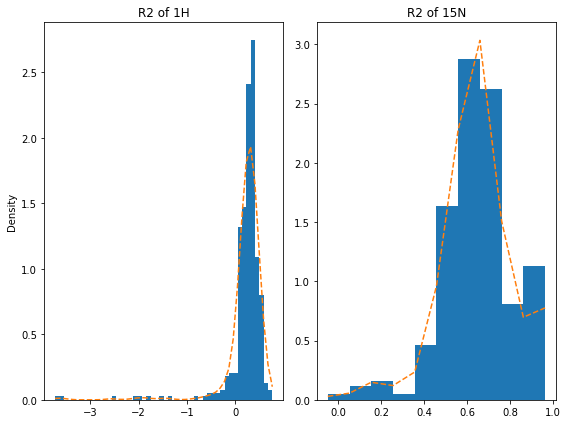

In [450]:
def get_r2_hist(r2_h, r2_n, model,num_epochs,learning_rate,hidden_dim,output):
    
    plt.figure(figsize=(8, 6))
    plt.subplot(1, 2, 1)

    density = stats.gaussian_kde(r2_h)
    n, x, _ = plt.hist(r2_h, density=True)  
    plt.plot(x, density(x),'--')
    plt.ylabel('Density')
    plt.title('R2 of 1H')

    plt.subplot(1, 2, 2)

    density = stats.gaussian_kde(r2_n)
    n, x, _ = plt.hist(r2_n, density=True)  
    plt.plot(x, density(x),'--')
    plt.title('R2 of 15N')

    plt.tight_layout()
    plt.savefig(output+"r2_"+model+'_'+str(num_epochs)+'_'+str(learning_rate)+'_'+str(hidden_dim)+'.png',bbox_inches='tight')
    plt.show()
    
#get_r2_hist(r2_h_valid, r2_n_valid, model_choice,num_epochs,learning_rate,hidden_dim,output)

In [616]:
def plot_precision_coverage(precisions, coverages, step, model,num_epochs,learning_rate,hidden_dim,output,title="Coverage and Precision",include_acc=False):
    plt.figure(figsize=(8, 6))
    if include_acc:
        colors = [plt.get_cmap('viridis')(0.2), plt.get_cmap('viridis')(0.5), plt.get_cmap('viridis')(0.8)]
    else:
        colors = [plt.get_cmap('viridis')(0.2), plt.get_cmap('viridis')(0.8)]
    plt.plot(step, coverages, label='Coverage', color=colors[0], linewidth=2.5)
    plt.plot(step, precisions, label='Precision', color=colors[1], linewidth=2.5)
    if include_acc:
        plt.plot([x for x in [x * step for x in range(int(1 / step) + 1)]], accuracies, label='Accuracy', color=colors[2], linewidth=2.5)
    plt.xlabel('Distance', fontsize=14)
    plt.ylabel('%', fontsize=14)
    plt.xticks(fontsize = 13)
    plt.yticks(fontsize = 13)
    plt.legend(fontsize=12)
    plt.xlim(max(step)+0.05, min(step)-0.05)
    plt.title(title, fontsize=18, pad=15)
    
    plt.savefig(output+"coverage_precision_"+model+'_'+str(num_epochs)+'_'+str(learning_rate)+'_'+str(hidden_dim)+'.png',bbox_inches='tight')
    plt.show()

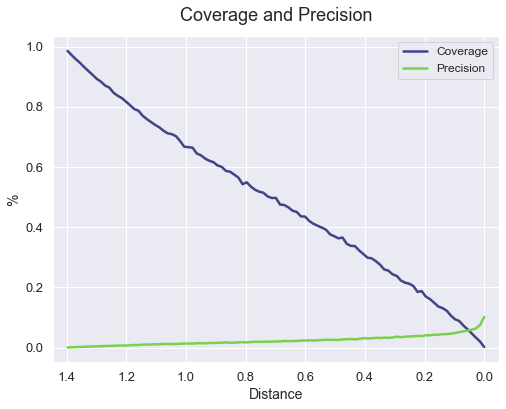

In [639]:
def get_plot_precision_coverage(coverage,precision,model,num_epochs,learning_rate,hidden_dim,output):
    
    #sort dictionary
    coverage = dict(sorted(coverage.items()))
    precision = dict(sorted(precision.items()))
    c = list(coverage.values())
    p = list(precision.values())
    
    #take mean over intervals (100 intervals)
    l = int(len(c)/100)
    mean_c = [np.mean(c[i:i+l]) for i in range(0, len(c), l)]
    mean_p = [np.mean(p[i:i+l]) for i in range(0, len(p), l)]
    
    key = list(coverage.keys())
    steps = np.linspace(max(key),0, num=len(mean_c), endpoint=True)
    
    plot_precision_coverage(mean_p,mean_c, steps,model,num_epochs,learning_rate,hidden_dim,output) 
    
get_plot_precision_coverage(coverage_valid,precision_valid,model_choice,num_epochs,learning_rate,hidden_dim,output)

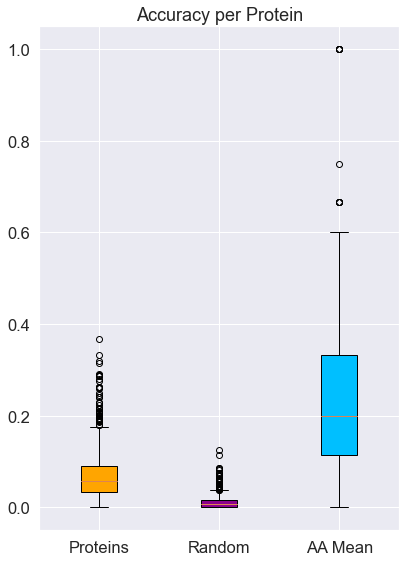

In [640]:
def get_boxplot_accuracy(acc, acc_rdnm,acc_aa_mean,model,num_epochs,learning_rate,hidden_dim,output):

    data = [acc, acc_rdnm,acc_aa_mean]

    fig = plt.figure(figsize =(5, 7))
    # Creating axes instance
    ax = fig.add_axes([0, 0, 1, 1])

    # Creating plot
    bp = ax.boxplot(data,patch_artist=True)

    colors = ['orange', 'darkmagenta','deepskyblue']

    for patch, color in zip(bp['boxes'], colors):
        patch.set_facecolor(color)

    plt.title("Accuracy per Protein")
    ax.set_xticklabels(['Proteins', 'Random','AA Mean'])

    # show plot
    plt.savefig(output+"accuracy_"+model+'_'+str(num_epochs)+'_'+str(learning_rate)+'_'+str(hidden_dim)+'.png',bbox_inches='tight')
    plt.show()
    
get_boxplot_accuracy(acc_valid, acc_rdnm_valid, acc_valid_aa_mean, model_choice,num_epochs,learning_rate,hidden_dim,output)

In [ ]:
plot_simple(train_loss, valid_loss, 'Training Loss', 'Validation Loss', x_label='Epochs', y_label='Loss', 
            title='Training and Validation Loss\n'+model_choice,
            x_range=1, out=False, out_name ='loss_'+str(num_epochs)+'_'+str(learning_rate)+'_'+str(hidden_dim)+'.png')

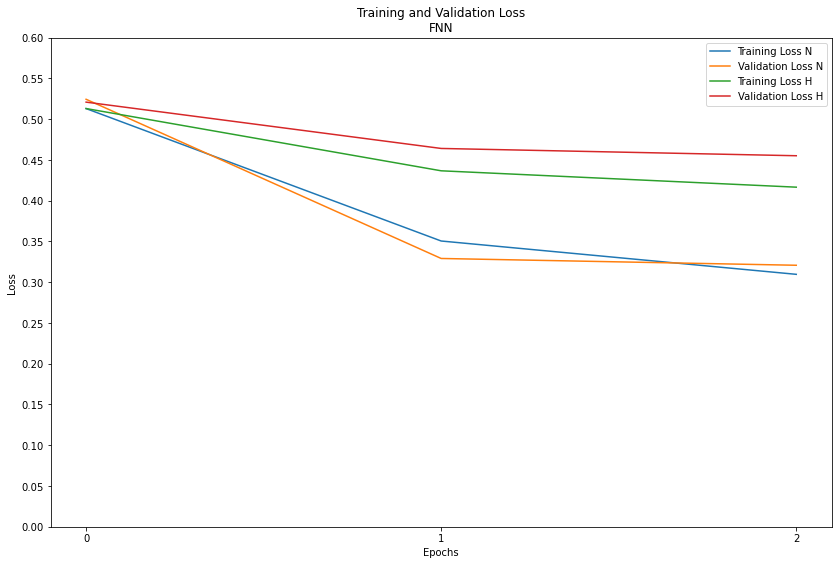

In [444]:
plot_double(train_loss_h,valid_loss_h,train_loss_n, valid_loss_n, 
            xlabel1='Training Loss H', ylabel1='Training Loss N', 
            xlabel2='Validation Loss H',ylabel2='Validation Loss N',
            x_label='Epochs', y_label='Loss',
            title='Training and Validation Loss\n'+model_choice, 
            x_range=1, y_range=0.05,out=False, out_name ='lossHN_'+str(num_epochs)+'_'+str(learning_rate)+'_'+str(hidden_dim)+'.png')


In [641]:
plot_scatter(y_masked, yhat_masked, xlabel1="measured", xlabel2="predicted", 
             title="First Sample of Multiple HN Entries\nper Sequence (20 epochs)", 
             out=False, out_name="scatter_first_sample_20_lr1e3.png")

NameError: name 'y_masked' is not defined

In [312]:
def calibration_plot(precision, recall, distances):
    

    fig, ax1 = plt.subplots(figsize=(14, 6))

    ax2 = ax1.twinx()
    ax1.plot(distances, precision, 'g-')
    ax2.plot(distances, recall, 'b-')

    ax1.set_xlabel('NN distance')
    ax1.set_ylabel('Precision', color='g')
    ax2.set_ylabel('Recall', color='b')
    
    
    
    plt.title('Calibration Plot')
    plt.ylim(ymin=0)
    
    
    plt.legend()
    #plt.savefig("./loss_plot_all_10.png")
    plt.show()

In [610]:
#calibration_plot(precision_all,recall_all, dist)

In [611]:
#plot_loss(train_loss, valid_loss)

# Detailed Analysis Plots

In [9]:
def plot_mse(mse1, mse2):
    
    plt.figure(figsize=(14, 6))
    
    l = range(1, len(mse1) + 1)
    plt.plot(l, mse1, label='MSE Difference')
    plt.plot(l, mse2, label='MSE')
    plt.xlabel('Samples')
    plt.ylabel('MSE')
    plt.title('MSE of Test Data')
    #plt.xticks(l)
    
    #plt.ylim(0,20000)
    
    plt.legend()
    #plt.savefig("./mse_test_9epoch.png")
    plt.show()

In [35]:
def plot_peaks(peaks1, peaks2, peak_h_pred, peak_n_pred, pdb_ids, sample_idx):
    
    #plt.figure(figsize=(14, 6))
    
    l = range(1, len(peaks1) + 1)
    
    # Create the figure and axes
    fig, (ax, ax2) = plt.subplots(2, 1, figsize=(14, 6), sharex=True)

    # Plot the entire data first
    ax.plot(l, peaks1)
    ax2.plot(l, peaks1, label='H')
    ax.plot(l, peak_h_pred)
    ax2.plot(l, peak_h_pred, label='H cos')
    
    ax.plot(l, peaks2, label='N')
    ax2.plot(l, peaks2)
    ax.plot(l, peak_n_pred, label='N cos')
    ax2.plot(l, peak_n_pred)

    # Set the y-axis limits to show only the specified ranges
    ax.set_ylim(90, 150)
    ax2.set_ylim(-2, 20)

    # Customize labels and title
    ax.set_title('Chemical shifts of the sequence')
    ax2.set_xlabel('Sequence')
    ax.set_ylabel('ppm')
    ax2.set_ylabel('ppm')
    

    ax.legend(loc='upper right')
    ax2.legend(loc='upper right')
    #plt.legend()
    #plt.savefig("./plt_BMRB/plot_sequence_shifts_test/shifts_"+str(pdb_ids)+"_"+str(sample_idx)+".png")
    plt.show()

In [107]:
def plot_peaks_pred(peaks1, peaks2, peak_h_pred, peak_n_pred, pdb_ids, sample_idx, seq):
    
    
    
    l = range(1, len(peaks1) + 1)
    
    # Create the figure and axes
    fig, ax = plt.subplots(1, 1, figsize=(20, 6), sharex=True)

    # Plot the entire data first
    
    ax.plot(l, peaks1, label='H')
    ax.plot(l, peak_h_pred, label='H pred/cos')
    
    ax.plot(l, peaks2, label='N')
    ax.plot(l, peak_n_pred, label='N pred/cos')
    

   

    # Customize labels and title
    ax.set_title('Chemical shifts of the sequence')
    ax.set_xlabel(seq)
    ax.set_ylabel('ppm')
    
    

    ax.legend(loc='upper right')
    
    #plt.legend()
    #plt.savefig("./plt_BMRB/plot_sequence_shifts_test/predicted_shifts_"+str(pdb_ids)+"_"+str(sample_idx)+".png")
    plt.show()

In [ ]:
def plot_scatter(peaks1, peaks2, peak_h_pred, peak_n_pred, pdb_ids, sample_idx):

    
    l = range(1, len(peaks1) + 1)
    
    # Create the figure and axes
    fig, ax = plt.subplots(1, 1, figsize=(14, 6), sharex=True)

    # Plot the entire data first
    
    ax.scatter(peaks1, peaks2,label='Observed', c='pink')
    ax.scatter(peak_h_pred, peak_n_pred,label='Predicted', c='blue')
    

    # Customize labels and title
    ax.set_title('Chemical shifts of the sequence')
    ax.set_xlabel('H')
    ax.set_ylabel('N')
    
    ax.legend(loc='upper right')
    
    #plt.legend()
    #plt.savefig("./plt_BMRB/plot_sequence_shifts_test/scatter_"+str(pdb_ids)+"_"+str(sample_idx)+".png")
    plt.show()

In [322]:
#plot_mse(mse_difference, mse_total)

# Models

In [513]:
# Define the linear regression model
class LinearRegression(nn.Module):
    
    def __init__(self):
        super(LinearRegression, self).__init__()
        self.linear = nn.Linear(1024, 2)
    
    def forward(self, x):
        return self.linear(x)


In [29]:
# Define a two-layer FNN model
class TwoLayerFNN(nn.Module):
    
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(TwoLayerFNN, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        return x



In [517]:
# Create or load your 1D CNN model
class CNN(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(CNN, self).__init__()
        self.conv1 = nn.Conv1d(in_channels=input_dim, out_channels=128, kernel_size=7, padding=3)
        self.relu = nn.ReLU()
        self.conv2 = nn.Conv1d(in_channels=128, out_channels=32, kernel_size=7, padding=3)
        self.fc = nn.Linear(32, output_dim)

    def forward(self, x):
        x = x.permute(0,2,1)#.unsqueeze(dim=-1) 
        #print(x.shape)
        x = self.conv1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.relu(x)
        x = x.permute(0,2,1)
        #print(x.shape)
        x = self.fc(x)  # Take the last output of the convolutional layers
        #print(x.shape)
        return x

In [ ]:
class NN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(NN, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(hidden_dim, 32)
        self.fc3 = nn.Linear(32, output_dim)
        #self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        #x = x.permute(0,2,1)
        #print(x.shape)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.relu(x)
        x = self.fc3(x)  # Take the last output of the convolutional layers
        #x = self.sigmoid(x)
        return x




In [59]:
a = [0,1,1]
b = [0.1, 0.3, 0.5]
auc = roc_auc_score(a, b)
print(auc)

0.0


In [250]:
def combine_dictionaries(dict1, dict2):
    common_keys = set(dict1.keys()) & set(dict2.keys())
    
    combined_dict = {key: (dict1[key] + dict2[key]) / 2 for key in common_keys}
    combined_dict.update({key: value for key, value in dict1.items() if key not in common_keys})
    combined_dict.update({key: value for key, value in dict2.items() if key not in common_keys})
    
    return combined_dict

# Example usage
dict1 = {1.0: 1, 2.0: 2, 3.0: 3}
dict2 = {2.0: 4, 3.0: 6, 4.0: 8}

result_dict = combine_dictionaries(dict1, dict2)
print(result_dict)
result_dict =dict(sorted(result_dict.items(), key=lambda x: x[0]))
print(result_dict)

{2.0: 3.0, 3.0: 4.5, 1.0: 1, 4.0: 8}
{1.0: 1, 2.0: 3.0, 3.0: 4.5, 4.0: 8}


In [ ]:
def compute_metrics(y, y_hat,):
    precisions = []
    coverages = []
    accuracies = []

    step = 0.01
    for threshold in [x * step for x in range(int(1 / step) + 1)]:
        true_positives = sum(1 for y, y_hat, p in sorted_results if p >= threshold and y == y_hat)
        positive_predictions = sum(1 for y, y_hat, p in sorted_results if p >= threshold)
        total_samples = len(sorted_results)

        # Precision
        if positive_predictions > 0:
            precision = (true_positives / positive_predictions) * 100.0
        else:
            precision = 100.0
        precisions.append(precision)

        # Coverage
        predicted_residues = sum(1 for y, y_hat, p in sorted_results if p >= threshold)
        coverage = (predicted_residues / len(sorted_results)) * 100.0
        coverages.append(coverage)
        
        # Accuracy
        if positive_predictions > 0:
            accuracy = (true_positives / total_samples) * 100.0
        else:
            accuracy = 0.0
        accuracies.append(accuracy)
    
    return precisions, coverages, accuracies